In [2]:
import tensorflow as tf
import numpy as np
import pandas as pd
import spacy
from collections import Counter
import sklearn.preprocessing as sp
import string
from tqdm import tqdm
import seaborn as sns
import transformers

2023-06-27 23:26:29.344176: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
import re
import csv
import random
import spacy
from nltk.corpus  import stopwords
import re
import os
import matplotlib.pyplot as plt
from transformers import BertTokenizer, BertModel
from transformers import TFBertEmbeddings, BertConfig
from sentence_transformers import SentenceTransformer, util

In [4]:
import sklearn
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import confusion_matrix, f1_score
import tensorflow as tf
import torch
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Bidirectional
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing import text
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow import keras
from tensorflow.keras import layers
import tensorboard

from sentence_transformers import SentenceTransformer, util

In [5]:
base_path = "/Users/alp/ayalcin/DBPEDIA"
data_path = "/Users/alp/ayalcin/DBPEDIA/DBP_wiki_data.csv"
test_path = "/Users/alp/ayalcin/DBPEDIA/DBPEDIA_test.csv"
val_path = "//Users/alp/ayalcin/DBPEDIA/DBPEDIA_val.csv"
train_path = "/Users/alp/ayalcin/DBPEDIA/DBPEDIA_train.csv"

In [6]:
df_train = pd.read_csv(train_path, encoding='utf-8-sig')
df_val = pd.read_csv(val_path, encoding='utf-8-sig')
df_test = pd.read_csv(test_path, encoding='utf-8-sig')
df_data = pd.read_csv(data_path, encoding='utf-8-sig')

In [7]:
df_train.l1.value_counts()

Agent             124798
Place              45877
Species            21472
Work               21013
Event              19106
SportsSeason        5883
UnitOfWork          1761
TopicalConcept       784
Device               248
Name: l1, dtype: int64

In [8]:
import pickle
pickle_in = open('/Users/alp/ayalcin/mpnet-base-v2/df_test_sentence_encoded_text.obj', 'rb')
df_test_encoded_text = pickle.load(pickle_in)
pickle_in.close()
pickle_in = open('/Users/alp/ayalcin/mpnet-base-v2/df_train_sentence_encoded_text.obj', 'rb')
df_train_encoded_text = pickle.load(pickle_in)
pickle_in.close()
pickle_in = open('/Users/alp/ayalcin/mpnet-base-v2/df_val_sentence_encoded_text.obj', 'rb')
df_val_encoded_text = pickle.load(pickle_in)
pickle_in.close()
pickle_in = open('/Users/alp/ayalcin/mpnet-base-v2/df_data_sentence_encoded_text.obj', 'rb')
df_data_encoded_text = pickle.load(pickle_in)
pickle_in.close()

In [9]:
label_encoder = LabelEncoder()
label_onhotencoder = OneHotEncoder(sparse=False)

train_encoded_l1_labels = label_encoder.fit_transform(df_train.l1)
val_encoded_l1_labels = label_encoder.transform(df_val.l1)
test_encoded_l1_labels = label_encoder.transform(df_test.l1)
data_encoded_l1_labels = label_encoder.transform(df_data.l1)

train_onehotencoded_l1_labels = label_onhotencoder.fit_transform(df_train.l1.to_numpy().reshape(-1,1))
val_onehotencoded_l1_labels = label_onhotencoder.transform(df_val.l1.to_numpy().reshape(-1,1))
test_onehotencoded_l1_labels = label_onhotencoder.transform(df_test.l1.to_numpy().reshape(-1,1))
data_onehotencoded_l1_labels = label_onhotencoder.transform(df_data.l1.to_numpy().reshape(-1,1))

/opt/anaconda3/envs/ayalcin/lib/python3.8/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [10]:
df_train_encoded = pd.DataFrame()
df_train_encoded['text_encodings'] = df_train_encoded_text.tolist()
df_train_encoded["text"] = df_train.text.to_list()
df_train_encoded['l1'] = df_train.l1.to_list()
df_train_encoded['l2'] = df_train.l2.to_list()
df_train_encoded['l3'] = df_train.l3.to_list()
#df_train_encoded

df_test_encoded = pd.DataFrame()
df_test_encoded['text_encodings'] = df_test_encoded_text.tolist()
df_test_encoded["text"] = df_test.text.to_list()
df_test_encoded['l1'] = df_test.l1.to_list()
df_test_encoded['l2'] = df_test.l2.to_list()
df_test_encoded['l3'] = df_test.l3.to_list()
#df_test_encoded

df_val_encoded = pd.DataFrame()
df_val_encoded['text_encodings'] = df_val_encoded_text.tolist()
df_val_encoded["text"] = df_val.text.to_list()
df_val_encoded['l1'] = df_val.l1.to_list()
df_val_encoded['l2'] = df_val.l2.to_list()
df_val_encoded['l3'] = df_val.l3.to_list()
#df_val_encoded

#df_data_encoded = pd.DataFrame()
#df_data_encoded['text_encodings'] = df_data_encoded_text.tolist()
#df_data_encoded["text"] = df_data.text.to_list()
#df_data_encoded['l1'] = df_data.l1.to_list()
#df_data_encoded['l2'] = df_data.l2.to_list()
#df_data_encoded['l3'] = df_data.l3.to_list()
#df_data_encoded
df_train_encoded

,text_encodings,text,l1,l2,l3
0,"[-0.10363507270812988, 0.1812124252319336, 0.0...","William Alexander Massey (October 7, 1856 – Ma...",Agent,Politician,Senator
1,"[0.05650283396244049, 0.07600477337837219, 0.0...",Lions is the sixth studio album by American ro...,Work,MusicalWork,Album
2,"[-0.09026263654232025, 0.03454560041427612, -0...","Pirqa (Aymara and Quechua for wall, hispaniciz...",Place,NaturalPlace,Mountain
3,"[-0.003419243497774005, 0.2908671498298645, 0....",Cancer Prevention Research is a biweekly peer-...,Work,PeriodicalLiterature,AcademicJournal
4,"[-0.033124424517154694, 0.20675116777420044, 0...",The Princeton University Chapel is located on ...,Place,Building,HistoricBuilding
...,...,...,...,...,...
240937,"[-0.07011406868696213, 0.2901493310928345, -0....",Charlie Thompson is a prominent journalist in ...,Agent,Person,Journalist
240938,"[-0.21219080686569214, 0.021147891879081726, 0...",The Northerly Stakes is a Perth Racing Group 3...,Event,Race,HorseRace
240939,"[0.09261240065097809, -0.350208044052124, 0.02...",HC Empor Rostock is a team handball club from ...,Agent,SportsTeam,HandballTeam
240940,"[-0.014504971913993359, -0.1529148668050766, -...",University of Surabaya (UBAYA) is a university...,Agent,EducationalInstitution,University


In [11]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

In [12]:
train_dataset = tf.data.Dataset.from_tensor_slices((df_train_encoded_text, train_onehotencoded_l1_labels))
train_dataset = train_dataset.prefetch(AUTOTUNE).shuffle(len(train_dataset), reshuffle_each_iteration=True).batch(32)

val_dataset = tf.data.Dataset.from_tensor_slices((df_val_encoded_text, val_onehotencoded_l1_labels))
val_dataset = val_dataset.prefetch(AUTOTUNE).shuffle(len(val_dataset), reshuffle_each_iteration=True).batch(32)

test_dataset = tf.data.Dataset.from_tensor_slices((df_test_encoded_text, test_onehotencoded_l1_labels))
test_dataset = test_dataset.prefetch(AUTOTUNE).shuffle(len(test_dataset), reshuffle_each_iteration=True).batch(32)

data_dataset = tf.data.Dataset.from_tensor_slices((df_data_encoded_text, data_onehotencoded_l1_labels))
data_dataset = data_dataset.prefetch(AUTOTUNE).shuffle(len(data_dataset), reshuffle_each_iteration=True).batch(32)

2023-06-27 23:28:34.099848: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [13]:
def dense_layers(input_tensor, layer_size, stage, block):

  layer1, layer2, layer3 = layer_size
  dense_base_name = 'dense' + str(stage) + block + '_branch_'
  bn_base_name = 'bn' + str(stage) + block  + '_branch_'
  #sc_base_name = 'shortcut' + str(stage) + block + '_branch_'

  x = layers.Dense(layer1, activation='relu', name = dense_base_name+'a') (input_tensor)
  x = layers.Dense(layer2, activation='relu', name = dense_base_name+'b') (x)
  x = layers.BatchNormalization(name=bn_base_name) (x)
  x = layers.Dense(layer3, activation='relu', name = dense_base_name+'c') (x)
  #x = layers.add([x, input_tensor], name=sc_base_name) (x)
  x = layers.Activation('relu') (x)

  return x

In [14]:
inputs = keras.Input(shape=(768,), name='Input_layer')
x = dense_layers(inputs, [652, 512, 256], 1, 'a')
x = dense_layers(x, [182, 128, 64], 2, 'a')
x = layers.Dense(52, activation='relu', name='dense3a_branch_a') (x)
x = layers.Dense(28, activation='relu', name='dense4a_branch_a') (x)
x = layers.BatchNormalization(name='batchnormalization') (x)
out = layers.Dense(9, activation='softmax', name='softmax_layer') (x)
model = keras.Model(inputs, out, name='supervised_model')
model.summary()

Model: "supervised_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_layer (InputLayer)    [(None, 768)]             0         
                                                                 
 dense1a_branch_a (Dense)    (None, 652)               501388    
                                                                 
 dense1a_branch_b (Dense)    (None, 512)               334336    
                                                                 
 bn1a_branch_ (BatchNormaliz  (None, 512)              2048      
 ation)                                                          
                                                                 
 dense1a_branch_c (Dense)    (None, 256)               131328    
                                                                 
 activation (Activation)     (None, 256)               0         
                                                  

In [15]:
conda install -c anaconda pydot

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.9.2
  latest version: 23.5.0

Please update conda by running

    $ conda update -n base -c defaults conda



# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [16]:
from tensorflow import keras
from tensorflow.keras.utils import plot_model

# ... Code for defining the model ...

# Visualize the model graph
plot_model(model, to_file='model_graph.png', show_shapes=True)


You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [17]:
# model.save('/home/ayalcin//Alp.Yalcin/Model_checkpoints/supervised_rt1')
best_model = keras.models.load_model('/Users/alp/ayalcin/Model_checkpoints/supervised_sentence_embedding_balanced_rt1')
best_model.summary()

Model: "supervised_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_layer (InputLayer)    [(None, 768)]             0         
                                                                 
 dense1a_branch_a (Dense)    (None, 652)               501388    
                                                                 
 dense1a_branch_b (Dense)    (None, 512)               334336    
                                                                 
 bn1a_branch_ (BatchNormaliz  (None, 512)              2048      
 ation)                                                          
                                                                 
 dense1a_branch_c (Dense)    (None, 256)               131328    
                                                                 
 activation_4 (Activation)   (None, 256)               0         
                                                  

In [18]:
pretrained_model = keras.Model(best_model.input, best_model.get_layer('batchnormalization').output)
train_prediction = pretrained_model.predict(df_train_encoded_text)
test_prediction = pretrained_model.predict(df_test_encoded_text)
val_prediction = pretrained_model.predict(df_val_encoded_text)
data_prediction = pretrained_model.predict(df_data_encoded_text)

pretrained_model.summary()

10712/10712 [==============================] - 53s 5ms/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_layer (InputLayer)    [(None, 768)]             0         
                                                                 
 dense1a_branch_a (Dense)    (None, 652)               501388    
                                                                 
 dense1a_branch_b (Dense)    (None, 512)               334336    
                                                                 
 bn1a_branch_ (BatchNormaliz  (None, 512)              2048      
 ation)                                                          
                                                                 
 dense1a_branch_c (Dense)    (None, 256)               131328    
                                                                 
 activation_4 (Activation)   (None, 256)               0         
 

In [18]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import hdbscan


In [19]:
train_prediction.shape

(240942, 28)

In [20]:
#conda install -c conda-forge hdbscan

In [21]:
import hdbscan
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(train_prediction)

In [22]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [24]:
import matplotlib.pyplot as plt

# Prepare data
pca_data = PCA(n_components=2).fit_transform(train_prediction)

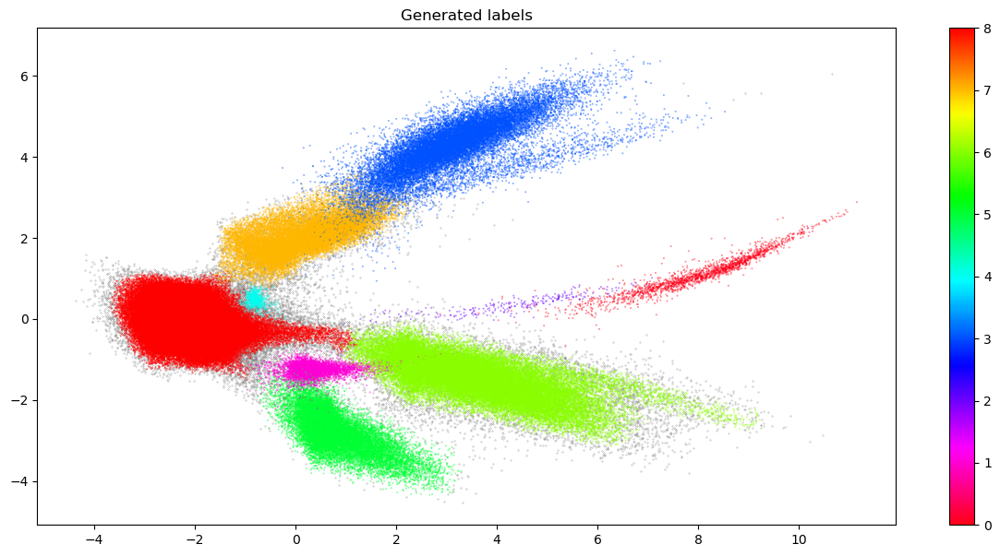

In [25]:
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv_r')
plt.title('Generated labels')
plt.colorbar()

In [26]:
train_encoded_df = pd.DataFrame()
train_encoded_df["text_encodings"] = train_prediction.tolist()
train_encoded_df["text"] = df_train.text.to_list()
train_encoded_df["encoded_l1_labels"] = train_encoded_l1_labels.tolist()
train_encoded_df["l1"] = df_train.l1.to_list()

test_encoded_df = pd.DataFrame()
test_encoded_df["text_encodings"] = test_prediction.tolist()
test_encoded_df["text"] = df_test.text.to_list()
test_encoded_df["encoded_l1_labels"] = test_encoded_l1_labels.tolist()
test_encoded_df["l1"] = df_test.l1.to_list()

val_encoded_df = pd.DataFrame()
val_encoded_df["text_encodings"] = val_prediction.tolist()
val_encoded_df["text"] = df_val.text.to_list()
val_encoded_df["encoded_l1_labels"] = val_encoded_l1_labels.tolist()
val_encoded_df["l1"] = df_val.l1.to_list()

#text_encoded_df = pd.DataFrame()
#text_encoded_df["text_encodings"] = train_prediction.tolist()
#text_encoded_df["text"] = df_train.text.to_list()
#text_encoded_df["encoded_l1_labels"] = train_encoded_l1_labels.tolist()
#text_encoded_df["l1"] = df_train.l1.to_list()

In [27]:
from nltk.tokenize import word_tokenize
train_word_tokens = train_encoded_df.text.apply(word_tokenize)
train_word_tokens

0         [William, Alexander, Massey, (, October, 7, ,,...
1         [Lions, is, the, sixth, studio, album, by, Ame...
2         [Pirqa, (, Aymara, and, Quechua, for, wall, ,,...
3         [Cancer, Prevention, Research, is, a, biweekly...
4         [The, Princeton, University, Chapel, is, locat...
                                ...                        
240937    [Charlie, Thompson, is, a, prominent, journali...
240938    [The, Northerly, Stakes, is, a, Perth, Racing,...
240939    [HC, Empor, Rostock, is, a, team, handball, cl...
240940    [University, of, Surabaya, (, UBAYA, ), is, a,...
240941    [The, 1981, Seattle, Seahawks, season, was, th...
Name: text, Length: 240942, dtype: object

In [28]:
import re
punctuation = re.compile(r'[-.?–//!,:;()\\|0-9]')

In [29]:
train_punctuation = []
for i in range(0,len(train_word_tokens)):
    sentence = train_word_tokens[i]
    post_punctuation_train = []
    for words in sentence:
        word = punctuation.sub("",words)
        word = re.sub(re.escape("''"),'',word)
        word = re.sub(re.escape("'s"),'',word)
        if len(word)>0:
            post_punctuation_train.append(word)
    train_punctuation.append(post_punctuation_train)

In [30]:
train_punctuation_escaped = []
for i in range(0,len(train_punctuation)):
    sentence = train_punctuation[i]
    post_escaped_train = []
    for words in sentence:
        word = re.sub("'s",'', words)
        if len(word)>0:
            post_escaped_train.append(word)
    train_punctuation_escaped.append(post_escaped_train)
        
    
    
#     #re.sub(re.escape("-"), '', train_punctuation)

In [31]:
train_punctuation_lower = []
for i in range (0,len(train_punctuation)):
    sentence = train_punctuation[i]
    lower_punctuation = []
    for words in sentence:
        words= words.lower()
        lower_punctuation.append(words)
    train_punctuation_lower.append(lower_punctuation)

In [32]:
from nltk.probability import FreqDist
from nltk.corpus import stopwords
stop_words=stopwords.words("english")
print(stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [33]:
train_stop_words_removed = []
for i in range(0,len(train_punctuation_lower)):
    sentence = train_punctuation_lower[i]
    filtered_sent=[]
    for w in sentence:
        if w not in stop_words:
            filtered_sent.append(w)
    train_stop_words_removed.append(filtered_sent)


In [34]:
from nltk.stem import WordNetLemmatizer
  
lemmatizer = WordNetLemmatizer()

In [35]:
train_stop_words_removed_lemmatized = []
for i in range(0,len(train_stop_words_removed)):
    sentence = train_stop_words_removed[i]
    lemmatize=[]
    for w in sentence:
        w = lemmatizer.lemmatize(w)
        lemmatize.append(w)
    train_stop_words_removed_lemmatized.append(lemmatize)

In [36]:
from nltk.probability import FreqDist
train_stop_words_removed_lemmatized_series = pd.Series(train_stop_words_removed_lemmatized)
train_frequency_word_tokens = train_stop_words_removed_lemmatized_series.apply(FreqDist)

In [37]:
train_encoded_df['tokenized_text'] = train_stop_words_removed_lemmatized
train_encoded_df['hdbscan_predicted_labels'] = cluster.labels_
train_encoded_df[train_encoded_df.l1 == "Agent"]

,text_encodings,text,encoded_l1_labels,l1,tokenized_text,hdbscan_predicted_labels
0,"[0.007814435288310051, 0.010714929550886154, 0...","William Alexander Massey (October 7, 1856 – Ma...",0,Agent,"[william, alexander, massey, october, march, u...",8
6,"[0.007814435288310051, 0.010714929550886154, 0...","The 1st Battalion, 68th Armor Regiment (1–68 A...",0,Agent,"[st, battalion, th, armor, regiment, armor, ba...",8
7,"[0.007814435288310051, 0.010714929550886154, 0...",John Warren Davis (commonly known as J. Warren...,0,Agent,"[john, warren, davis, commonly, known, j, warr...",8
8,"[0.007814435288310051, 0.010714929550886154, 0...","Alfrēds Hartmanis (November 1, 1881, Riga, Lat...",0,Agent,"[alfrēds, hartmanis, november, riga, latvia, j...",8
9,"[0.007814435288310051, 0.010714929550886154, 0...",The International Association of Plumbing and ...,0,Agent,"[international, association, plumbing, mechani...",-1
...,...,...,...,...,...,...
240932,"[0.007814435288310051, 0.010714929550886154, 0...",K. H. Ting or Ting Kuang-hsun (simplified Chin...,0,Agent,"[k, h, ting, ting, kuanghsun, simplified, chin...",8
240935,"[0.007814435288310051, 0.010714929550886154, 0...","Thomas Osborne, 1st Duke of Leeds, KG (20 Febr...",0,Agent,"[thomas, osborne, st, duke, leeds, kg, februar...",8
240937,"[0.007814435288310051, 0.010714929550886154, 0...",Charlie Thompson is a prominent journalist in ...,0,Agent,"[charlie, thompson, prominent, journalist, pen...",8
240939,"[0.007814435288310051, 0.010714929550886154, 0...",HC Empor Rostock is a team handball club from ...,0,Agent,"[hc, empor, rostock, team, handball, club, ros...",8


In [38]:
Agent_words = []
Device_words = []
Event_words = []
Place_words = []
Species_words = []
SportsSeason_words = []
TopicalConcept_words = []
UnitOfWork_words = []
Work_words = []
for i in range(0,train_encoded_df.encoded_l1_labels.nunique()):
    for classes in train_encoded_df.tokenized_text[train_encoded_df.encoded_l1_labels == i].reset_index(drop=True):
        for words in classes:
            if i == 0:
                Agent_words.append(words)
            if i == 1:
                Device_words.append(words)
            if i == 2:
                Event_words.append(words)
            if i == 3:
                Place_words.append(words)
            if i == 4:
                Species_words.append(words)
            if i == 5:
                SportsSeason_words.append(words)
            if i == 6: 
                TopicalConcept_words.append(words)
            if i == 7:
                UnitOfWork_words.append(words)
            if i == 8:
                Work_words.append(words)

In [39]:
Agent_words_fd = FreqDist(Agent_words)
Device_words_fd = FreqDist(Device_words)
Event_words_fd = FreqDist(Event_words)
Place_words_fd = FreqDist(Place_words)
Species_words_fd = FreqDist(Species_words)
SportsSeason_words_fd = FreqDist(SportsSeason_words)
TopicalConcept_words_fd = FreqDist(TopicalConcept_words)
UnitOfWork_words_fd = FreqDist(UnitOfWork_words)
Work_words_fd = FreqDist(Work_words)

In [40]:
train_stop_words_removed = []
for i in range(0,len(train_punctuation_lower)):
    sentence = train_punctuation_lower[i]
    filtered_sent=[]
    for w in sentence:
        if w not in stop_words:
            filtered_sent.append(w)
    train_stop_words_removed.append(filtered_sent)

In [41]:
from collections import Counter, OrderedDict
import operator
from nltk.corpus import wordnet as wn


### Agent Topic

##### Hypernyms of Agent topic words

In [42]:
Agent_hyper_words_1 = []
for words in Agent_words:
    for ss in wn.synsets(words):
        for hyper in ss.hypernyms():
#            print(hyper)
#            print (ss, hyper)
            Agent_hyper_words_1.append(hyper.name())

In [43]:
Agent_hyper_words_1_fd = FreqDist(Agent_hyper_words_1)
Agent_hyper_words_1_fd.most_common(20)

[('act.v.01', 360724),
 ('be.v.01', 317689),
 ('time_period.n.01', 316534),
 ('make.v.03', 315901),
 ('move.v.02', 261936),
 ('travel.v.01', 257302),
 ('change.v.01', 234469),
 ('person.n.01', 217085),
 ('change.v.02', 209632),
 ('have.v.02', 181848),
 ('perform.v.03', 181200),
 ('use.v.01', 166278),
 ('gregorian_calendar_month.n.01', 162633),
 ('act.v.02', 159408),
 ('re-create.v.01', 156621),
 ('activity.n.01', 151901),
 ('unit.n.03', 111027),
 ('gamble.v.02', 110353),
 ('body.n.02', 108422),
 ('digit.n.01', 107812)]

In [44]:
from nltk.corpus import wordnet as wn

word = 'cat'

# Get synsets for the word
synsets = wn.synsets(word)

# Print synsets and hypernyms
for synset in synsets:
    print(f"Synset: {synset.name()} - {synset.definition()}")
    print("Hypernyms:")
    for hypernym in synset.hypernyms():
        print(f"\t{hypernym.name()} - {hypernym.definition()}")
    print()

Synset: cat.n.01 - feline mammal usually having thick soft fur and no ability to roar: domestic cats; wildcats
Hypernyms:
	feline.n.01 - any of various lithe-bodied roundheaded fissiped mammals, many with retractile claws

Synset: guy.n.01 - an informal term for a youth or man
Hypernyms:
	man.n.01 - an adult person who is male (as opposed to a woman)

Synset: cat.n.03 - a spiteful woman gossip
Hypernyms:
	gossip.n.03 - a person given to gossiping and divulging personal information about others
	woman.n.01 - an adult female person (as opposed to a man)

Synset: kat.n.01 - the leaves of the shrub Catha edulis which are chewed like tobacco or used to make tea; has the effect of a euphoric stimulant
Hypernyms:
	stimulant.n.02 - a drug that temporarily quickens some vital process

Synset: cat-o'-nine-tails.n.01 - a whip with nine knotted cords
Hypernyms:
	whip.n.01 - an instrument with a handle and a flexible lash that is used for whipping

Synset: caterpillar.n.02 - a large tracked vehicle

In [45]:
synsets

[Synset('cat.n.01'),
 Synset('guy.n.01'),
 Synset('cat.n.03'),
 Synset('kat.n.01'),
 Synset('cat-o'-nine-tails.n.01'),
 Synset('caterpillar.n.02'),
 Synset('big_cat.n.01'),
 Synset('computerized_tomography.n.01'),
 Synset('cat.v.01'),
 Synset('vomit.v.01')]

In [46]:
Agent_hyper_words_2 = []
for word in Agent_hyper_words_1:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Agent_hyper_words_2.append(word.split())
    else:
        Agent_hyper_words_2.append(hyper)

In [47]:
Agent_hyper_words_2_2 = []
for i in range (0,len(Agent_hyper_words_2)):
    for hypers in Agent_hyper_words_2[i]:
        if type(hypers) == str:
             Agent_hyper_words_2_2.append(hypers)
        else:
            Agent_hyper_words_2_2.append(hypers.name())

In [48]:
Agent_hyper_words_2_fd = FreqDist(Agent_hyper_words_2_2)
Agent_hyper_words_2_fd.most_common(20)

[('make.v.03', 818266),
 ('change.v.01', 683729),
 ('person.n.01', 572122),
 ('change.v.02', 561518),
 ('move.v.02', 558416),
 ('travel.v.01', 501368),
 ('act.v.01', 480108),
 ('be.v.01', 438094),
 ('activity.n.01', 357558),
 ('fundamental_quantity.n.01', 321162),
 ('social_group.n.01', 299017),
 ('act.n.02', 293168),
 ('organization.n.01', 273956),
 ('organism.n.01', 255311),
 ('use.v.01', 252580),
 ('get.v.01', 243250),
 ('re-create.v.01', 241122),
 ('abstraction.n.06', 228800),
 ('artifact.n.01', 227206),
 ('causal_agent.n.01', 225071)]

In [49]:
Agent_hyper_words_3 = []
for word in Agent_hyper_words_2_2:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Agent_hyper_words_3.append(word.split())
    else:
        Agent_hyper_words_3.append(hyper)

In [50]:
Agent_hyper_words_3_2 = []
for i in range (0,len(Agent_hyper_words_3)):
    for hypers in Agent_hyper_words_3[i]:
        if type(hypers) == str:
             Agent_hyper_words_3_2.append(hypers)
        else:
            Agent_hyper_words_3_2.append(hypers.name())

In [51]:
Agent_hyper_words_3_fd = FreqDist(Agent_hyper_words_3_2)
Agent_hyper_words_3_fd.most_common(20)

[('make.v.03', 1306245),
 ('change.v.01', 916231),
 ('change.v.02', 886038),
 ('move.v.02', 805462),
 ('person.n.01', 763551),
 ('abstraction.n.06', 720959),
 ('act.v.01', 664123),
 ('act.n.02', 663295),
 ('event.n.01', 659766),
 ('travel.v.01', 623376),
 ('organism.n.01', 581700),
 ('group.n.01', 580730),
 ('causal_agent.n.01', 578621),
 ('artifact.n.01', 523332),
 ('be.v.01', 480314),
 ('measure.n.02', 458068),
 ('physical_entity.n.01', 452982),
 ('social_group.n.01', 423501),
 ('think.v.03', 390817),
 ('entity.n.01', 345815)]

##### Hypernyms Similarities of Classes for Agent

Pairwise comparison of each words for agent class. This comparison is made for 3 different levels of hypernyms

In [52]:
similarity_threshold = 0.49
Agent_similarities_1 = []
for i in range(0,len(Agent_hyper_words_1_fd.most_common(50))):
    for j in range(0,len(Agent_hyper_words_1_fd.most_common(50))):
        if i != j:
            if wn.synset(Agent_hyper_words_1_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_1_fd.most_common(50)[j][0])) != None :
                if wn.synset(Agent_hyper_words_1_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_1_fd.most_common(50)[j][0])) > similarity_threshold:                    
                    Agent_similarities_1.append((Agent_hyper_words_1_fd.most_common(50)[i][0],Agent_hyper_words_1_fd.most_common(50)[j][0]))


In [53]:
Agent_similarities_1

[('make.v.03', 're-create.v.01'),
 ('make.v.03', 'create_from_raw_material.v.01'),
 ('move.v.02', 'transport.v.02'),
 ('person.n.01', 'inhabitant.n.01'),
 ('change.v.02', 'change_state.v.01'),
 ('perform.v.03', 're-create.v.01'),
 ('re-create.v.01', 'make.v.03'),
 ('re-create.v.01', 'perform.v.03'),
 ('activity.n.01', 'occupation.n.01'),
 ('unit.n.03', 'organization.n.01'),
 ('gamble.v.02', 'bet.v.02'),
 ('change_state.v.01', 'change.v.02'),
 ('transport.v.02', 'move.v.02'),
 ('group.n.01', 'people.n.01'),
 ('bet.v.02', 'gamble.v.02'),
 ('create_from_raw_material.v.01', 'make.v.03'),
 ('organization.n.01', 'unit.n.03'),
 ('organization.n.01', 'association.n.01'),
 ('association.n.01', 'organization.n.01'),
 ('occupation.n.01', 'activity.n.01'),
 ('inhabitant.n.01', 'person.n.01'),
 ('people.n.01', 'group.n.01')]

In [54]:
len(Agent_similarities_1)

22

In [55]:
similarity_threshold = 0.49
Agent_similarities_2 = []
for i in range(0,len(Agent_hyper_words_2_fd.most_common(50))):
    for j in range(0,len(Agent_hyper_words_2_fd.most_common(50))):
        if i != j:
            if wn.synset(Agent_hyper_words_2_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_2_fd.most_common(50)[j][0])) != None :
                if wn.synset(Agent_hyper_words_2_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_2_fd.most_common(50)[j][0])) > similarity_threshold:
#                    Agent_similarities_2.append('The similarity between {0} and {1} is {2}'.format(Agent_hyper_words_2_fd.most_common(50)[i][0], Agent_hyper_words_2_fd.most_common(50)[j][0], wn.synset(Agent_hyper_words_2_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_2_fd.most_common(50)[j][0]))))
                    Agent_similarities_2.append((Agent_hyper_words_1_fd.most_common(50)[i][0],Agent_hyper_words_1_fd.most_common(50)[j][0]))


In [56]:
Agent_similarities_2

[('act.v.01', 'unit.n.03'),
 ('time_period.n.01', 'act.v.02'),
 ('time_period.n.01', 'digit.n.01'),
 ('change.v.01', 'transport.v.02'),
 ('change.v.02', 'use.v.01'),
 ('have.v.02', 'change_state.v.01'),
 ('have.v.02', 'animal_group.n.01'),
 ('perform.v.03', 'gregorian_calendar_month.n.01'),
 ('perform.v.03', 'building.n.01'),
 ('perform.v.03', 'inhabitant.n.01'),
 ('use.v.01', 'change.v.02'),
 ('gregorian_calendar_month.n.01', 'perform.v.03'),
 ('gregorian_calendar_month.n.01', 'location.n.01'),
 ('act.v.02', 'time_period.n.01'),
 ('unit.n.03', 'act.v.01'),
 ('gamble.v.02', 'building.n.01'),
 ('gamble.v.02', 'change_state.v.01'),
 ('gamble.v.02', 'have.v.01'),
 ('body.n.02', 'administrative_district.n.01'),
 ('digit.n.01', 'time_period.n.01'),
 ('building.n.01', 'perform.v.03'),
 ('building.n.01', 'gamble.v.02'),
 ('administrative_district.n.01', 'body.n.02'),
 ('educational_institution.n.01', 'people.n.01'),
 ('get.v.01', 'have.v.01'),
 ('get.v.01', 'bet.v.02'),
 ('be.v.03', 'animal_g

In [57]:
similarity_threshold = 0.49
Agent_similarities_3 = []
for i in range(0,len(Agent_hyper_words_3_fd.most_common(50))):
    for j in range(0,len(Agent_hyper_words_3_fd.most_common(50))):
        if i != j:
            if wn.synset(Agent_hyper_words_3_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_3_fd.most_common(50)[j][0])) != None :
                if wn.synset(Agent_hyper_words_3_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_3_fd.most_common(50)[j][0])) > similarity_threshold:
#                    Agent_similarities_3.append('The similarity between {0} and {1} is {2}'.format(Agent_hyper_words_3_fd.most_common(50)[i][0], Agent_hyper_words_3_fd.most_common(50)[j][0], wn.synset(Agent_hyper_words_3_fd.most_common(50)[i][0]).path_similarity(wn.synset(Agent_hyper_words_3_fd.most_common(50)[j][0]))))
                    Agent_similarities_3.append((Agent_hyper_words_1_fd.most_common(50)[i][0],Agent_hyper_words_1_fd.most_common(50)[j][0]))


In [58]:
Agent_similarities_3

[('move.v.02', 'perform.v.03'),
 ('move.v.02', 'gregorian_calendar_month.n.01'),
 ('travel.v.01', 'use.v.01'),
 ('travel.v.01', 'activity.n.01'),
 ('travel.v.01', 'digit.n.01'),
 ('travel.v.01', 'building.n.01'),
 ('travel.v.01', 'group.n.01'),
 ('travel.v.01', 'contest.n.01'),
 ('change.v.01', 'create_from_raw_material.v.01'),
 ('person.n.01', 'change.v.02'),
 ('person.n.01', 'educational_institution.n.01'),
 ('change.v.02', 'person.n.01'),
 ('change.v.02', 'contest.n.01'),
 ('perform.v.03', 'move.v.02'),
 ('perform.v.03', 'manipulate.v.02'),
 ('use.v.01', 'travel.v.01'),
 ('use.v.01', 'gamble.v.02'),
 ('gregorian_calendar_month.n.01', 'move.v.02'),
 ('gregorian_calendar_month.n.01', 'unit.n.03'),
 ('act.v.02', 'get.v.01'),
 ('act.v.02', 'permit.v.01'),
 ('activity.n.01', 'travel.v.01'),
 ('activity.n.01', 'compete.v.01'),
 ('unit.n.03', 'gregorian_calendar_month.n.01'),
 ('unit.n.03', 'digit.n.01'),
 ('unit.n.03', 'change_state.v.01'),
 ('gamble.v.02', 'use.v.01'),
 ('gamble.v.02', '

##### Network X - Agent

In [59]:
%matplotlib inline


In [60]:
Agent_hyper_words_1_fd_50 = set()
for i in range(0,len(Agent_hyper_words_1_fd.most_common(50))):
    Agent_hyper_words_1_fd_50.add(Agent_hyper_words_1_fd.most_common(50)[i][0])

In [61]:
import networkx as nx
import matplotlib.pyplot as pl
from nltk.corpus import wordnet as wn
  
def wordnet_graph(words):
      

#       Construct a semantic graph and labels for a set of object categories using 
#       WordNet and NetworkX. 
     
#      Parameters: 
#      ----------
#      words : set
#          Set of words for all the categories. 
         
#      Returns: 
#      -------
#      graph : graph
#          Graph object containing edges and nodes for the network. 
#      labels : dict
#          Dictionary of all synset labels. 
     
    graph = nx.Graph()
    labels = {}
    seen = set()
     
    def recurse(s):
         
#          """ Recursively move up semantic hierarchy and add nodes / edges """  
 
        if not s in seen:                               # if not seen...
            seen.add(s)                                 # add to seen
            graph.add_node(s.name)                      # add node
            labels[s.name] = s.name().split(".")[0]     # add label
            hypernyms = s.hypernyms()                   # get hypernyms
 
            for s1 in hypernyms:                        # for hypernyms
                graph.add_node(s1.name)                 # add node
                graph.add_edge(s.name, s1.name)         # add edge between
                recurse(s1)                             # do so until top
      
     # build network containing all categories          
    for word in words:                                  # for all categories
        s = wn.synset(str(word))
#        s = wn.synset(str(word) + str('.n.01'))         # create synset            
        recurse(s)                                      # call recurse
     
     # return the graph and labels    
    return graph , labels

In [62]:
import networkx as nx
import pylab as plt
from networkx.drawing.nx_agraph import graphviz_layout

##### Graph for Agent Level 1 Hypernyms 

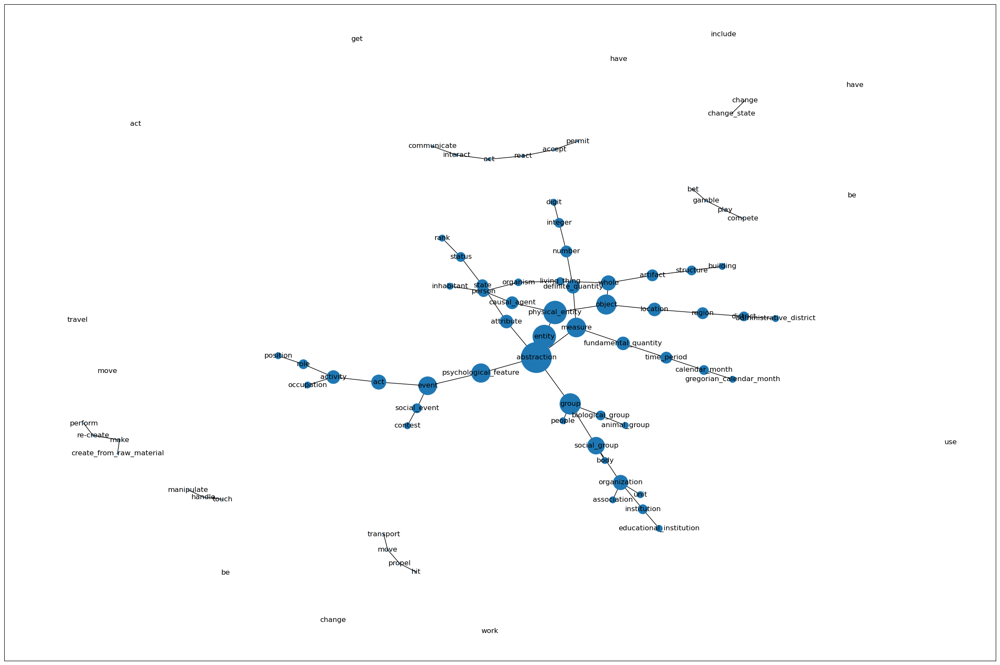

In [63]:
# create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_1_fd_50)

# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Agent Level 2 Hypernyms 

In [64]:
Agent_hyper_words_2_fd_50 = set()
for i in range(0,len(Agent_hyper_words_2_fd.most_common(50))):
    Agent_hyper_words_2_fd_50.add(Agent_hyper_words_2_fd.most_common(50)[i][0])

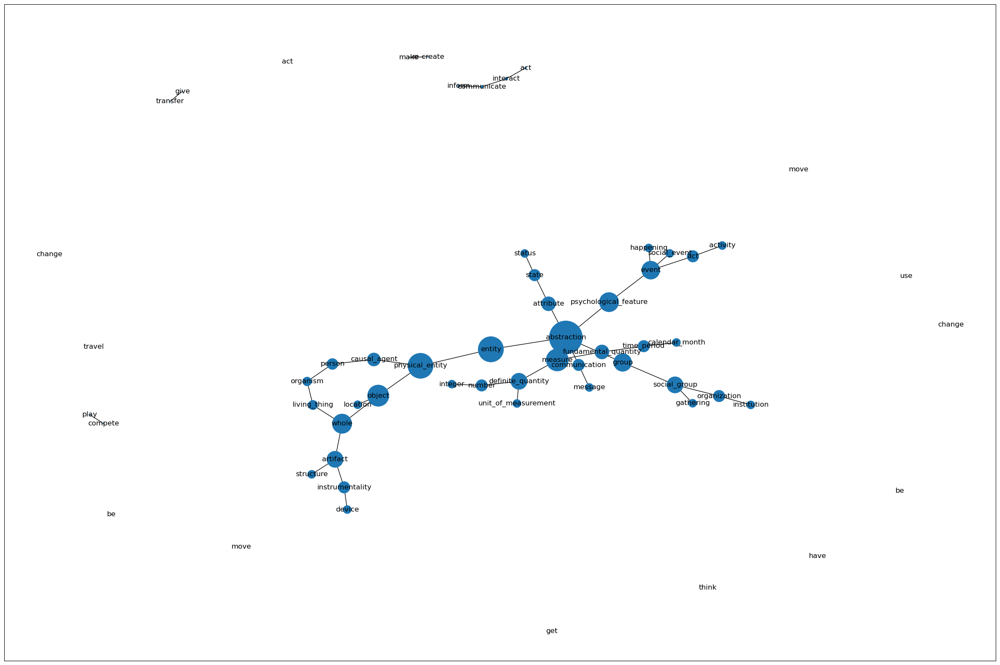

In [65]:
 # create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_2_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size,labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Agent Level 3 Hypernyms 

In [66]:
Agent_hyper_words_3_fd_50 = set()
for i in range(0,len(Agent_hyper_words_3_fd.most_common(50))):
    Agent_hyper_words_3_fd_50.add(Agent_hyper_words_3_fd.most_common(50)[i][0])

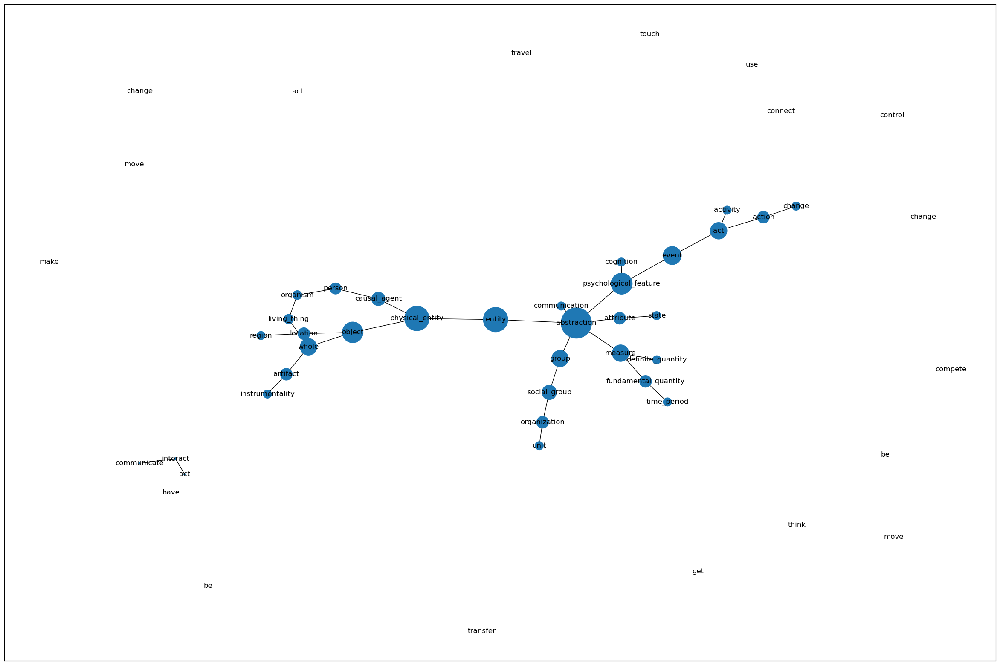

In [67]:
 # create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_3_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

### Event Topic

##### Hypernyms of Event topic words

In [68]:
Event_hyper_words_1 = []
for words in Event_words:
    for ss in wn.synsets(words):
        for hyper in ss.hypernyms():
#            print(hyper)
#            print (ss, hyper)
            Event_hyper_words_1.append(hyper.name())

In [69]:
Event_hyper_words_1_fd = FreqDist(Event_hyper_words_1)
Event_hyper_words_1_fd.most_common(20)

[('be.v.01', 89810),
 ('move.v.02', 64474),
 ('time_period.n.01', 59788),
 ('act.v.01', 59549),
 ('travel.v.01', 58307),
 ('contest.n.01', 51812),
 ('change.v.01', 49012),
 ('change.v.02', 39652),
 ('move.v.03', 34353),
 ('make.v.03', 33736),
 ('person.n.01', 33082),
 ('get.v.01', 28946),
 ('group.n.01', 28400),
 ('compete.v.01', 28298),
 ('evaluate.v.02', 25369),
 ('restrain.v.01', 24572),
 ('rank.n.02', 24330),
 ('aim.v.01', 24270),
 ('digit.n.01', 23596),
 ('use.v.01', 22619)]

In [70]:
Event_hyper_words_2 = []
for word in Event_hyper_words_1:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Event_hyper_words_2.append(word.split())
    else:
        Event_hyper_words_2.append(hyper)

In [71]:
Event_hyper_words_2_2 = []
for i in range (0,len(Event_hyper_words_2)):
    for hypers in Event_hyper_words_2[i]:
        if type(hypers) == str:
             Event_hyper_words_2_2.append(hypers)
        else:
            Event_hyper_words_2_2.append(hypers.name())

In [72]:
Event_hyper_words_2_fd = FreqDist(Event_hyper_words_2_2)
Event_hyper_words_2_fd.most_common(20)

[('change.v.01', 147431),
 ('be.v.01', 119968),
 ('move.v.02', 119714),
 ('change.v.02', 111995),
 ('travel.v.01', 101422),
 ('person.n.01', 96645),
 ('act.v.01', 91765),
 ('make.v.03', 87352),
 ('abstraction.n.06', 62748),
 ('get.v.01', 61635),
 ('social_event.n.01', 61039),
 ('fundamental_quantity.n.01', 60748),
 ('activity.n.01', 56888),
 ('measure.n.02', 51403),
 ('act.n.02', 50901),
 ('compete.v.01', 49773),
 ('think.v.03', 44967),
 ('move.v.03', 41395),
 ('status.n.01', 41163),
 ('location.n.01', 40766)]

In [73]:
Event_hyper_words_3 = []
for word in Event_hyper_words_2_2:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Event_hyper_words_3.append(word.split())
    else:
        Event_hyper_words_3.append(hyper)

In [74]:
Event_hyper_words_3_2 = []
for i in range (0,len(Event_hyper_words_3)):
    for hypers in Event_hyper_words_3[i]:
        if type(hypers) == str:
             Event_hyper_words_3_2.append(hypers)
        else:
            Event_hyper_words_3_2.append(hypers.name())

In [75]:
Event_hyper_words_3_fd = FreqDist(Event_hyper_words_3_2)
Event_hyper_words_3_fd.most_common(20)

[('change.v.02', 190917),
 ('change.v.01', 182122),
 ('move.v.02', 177276),
 ('event.n.01', 172892),
 ('make.v.03', 152284),
 ('travel.v.01', 137150),
 ('abstraction.n.06', 135936),
 ('act.n.02', 135888),
 ('be.v.01', 131157),
 ('act.v.01', 129103),
 ('organism.n.01', 97856),
 ('causal_agent.n.01', 96942),
 ('measure.n.02', 95091),
 ('physical_entity.n.01', 91091),
 ('artifact.n.01', 90332),
 ('think.v.03', 89336),
 ('person.n.01', 88714),
 ('entity.n.01', 87642),
 ('group.n.01', 82444),
 ('state.n.02', 79491)]

##### Network X - Event

##### Graph for Event Level 1 Hypernyms 

In [76]:
Event_hyper_words_1_fd_50 = set()
for i in range(0,len(Event_hyper_words_1_fd.most_common(50))):
    Event_hyper_words_1_fd_50.add(Event_hyper_words_1_fd.most_common(50)[i][0])

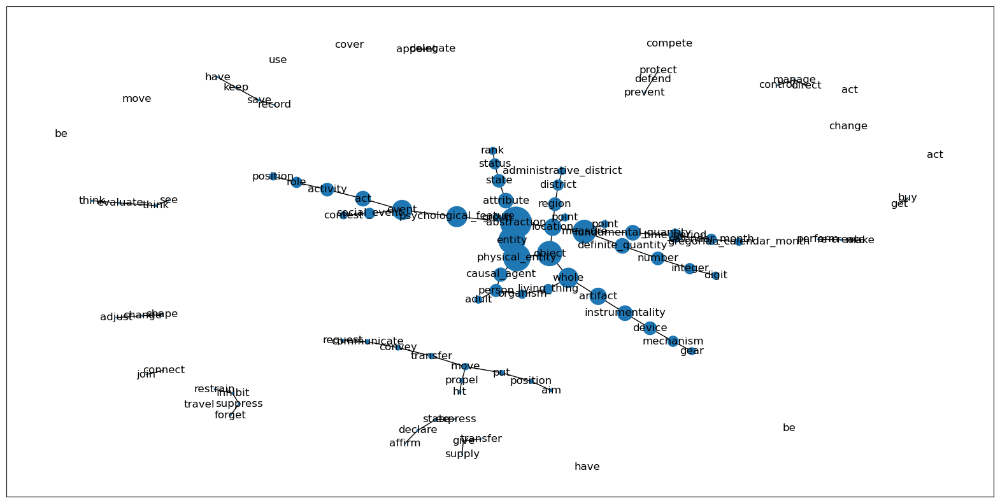

In [77]:
%matplotlib inline
# create the graph and labels
graph, labels = wordnet_graph(Event_hyper_words_1_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(20, 10))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Event Level 2 Hypernyms 

In [78]:
Event_hyper_words_2_fd_50 = set()
for i in range(0,len(Event_hyper_words_2_fd.most_common(50))):
    Event_hyper_words_2_fd_50.add(Event_hyper_words_2_fd.most_common(50)[i][0])

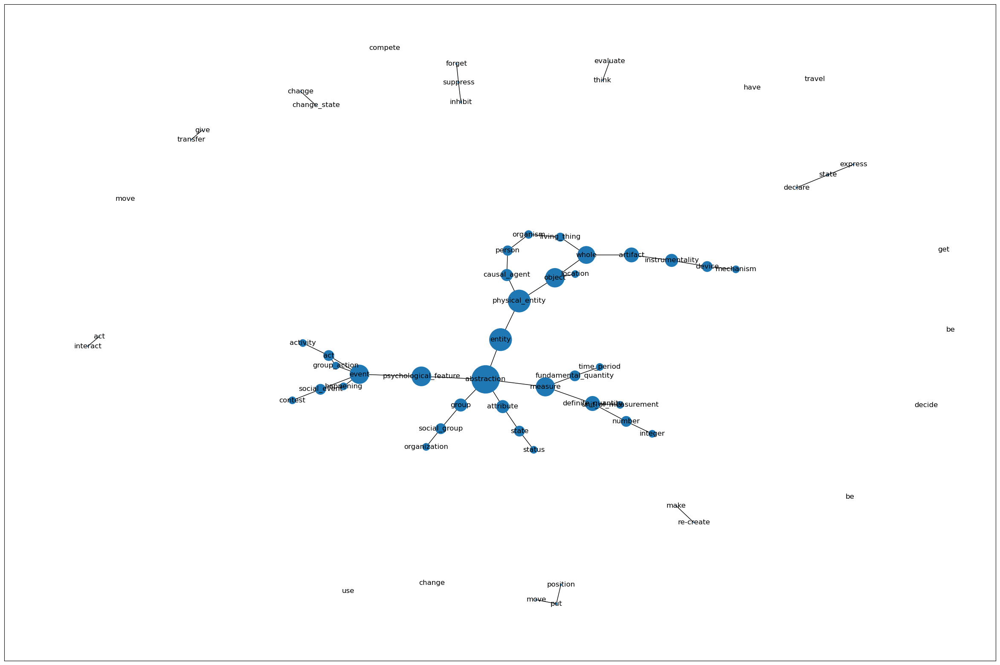

In [79]:
 # create the graph and labels
graph, labels = wordnet_graph(Event_hyper_words_2_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Event Level 3 Hypernyms 

In [80]:
Event_hyper_words_3_fd_50 = set()
for i in range(0,len(Event_hyper_words_3_fd.most_common(50))):
    Event_hyper_words_3_fd_50.add(Event_hyper_words_3_fd.most_common(50)[i][0])

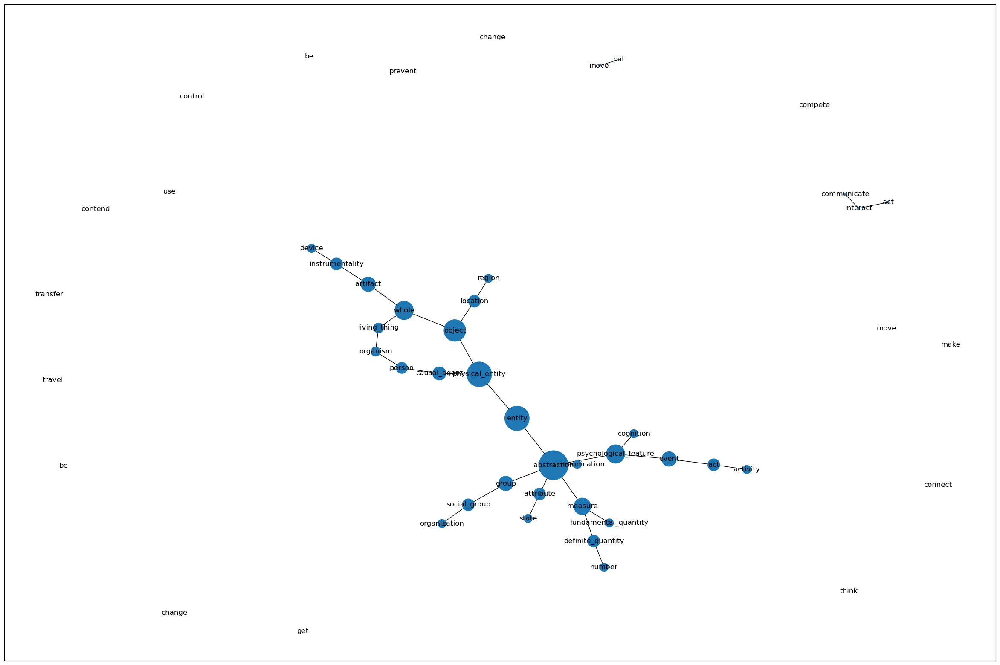

In [81]:
 # create the graph and labels
graph, labels = wordnet_graph(Event_hyper_words_3_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

### Place Topic

##### Hypernyms of Place topic words

In [82]:
Place_hyper_words_1 = []
for words in Place_words:
    for ss in wn.synsets(words):
        for hyper in ss.hypernyms():
#            print(hyper)
#            print (ss, hyper)
            Place_hyper_words_1.append(hyper.name())

In [83]:
Place_hyper_words_1_fd = FreqDist(Place_hyper_words_1)
Place_hyper_words_1_fd.most_common(20)

[('be.v.01', 113986),
 ('location.n.01', 94848),
 ('move.v.02', 88934),
 ('make.v.03', 79996),
 ('administrative_district.n.01', 78756),
 ('change.v.01', 77895),
 ('travel.v.01', 71489),
 ('change.v.02', 67903),
 ('time_period.n.01', 60017),
 ('structure.n.01', 59497),
 ('move.v.03', 56868),
 ('direction.n.02', 56229),
 ('linear_unit.n.01', 47088),
 ('activity.n.01', 45960),
 ('tract.n.01', 43621),
 ('act.v.01', 42697),
 ('cardinal_compass_point.n.01', 40886),
 ('building.n.01', 39759),
 ('be.v.03', 38861),
 ('supply.v.01', 38708)]

In [84]:
Place_hyper_words_2 = []
for word in Place_hyper_words_1:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Place_hyper_words_2.append(word.split())
    else:
        Place_hyper_words_2.append(hyper)

In [85]:
Place_hyper_words_2_2 = []
for i in range (0,len(Place_hyper_words_2)):
    for hypers in Place_hyper_words_2[i]:
        if type(hypers) == str:
             Place_hyper_words_2_2.append(hypers)
        else:
            Place_hyper_words_2_2.append(hypers.name())

In [86]:
Place_hyper_words_2_fd = FreqDist(Place_hyper_words_2_2)
Place_hyper_words_2_fd.most_common(20)

[('change.v.01', 260206),
 ('move.v.02', 230676),
 ('change.v.02', 184046),
 ('travel.v.01', 177166),
 ('artifact.n.01', 176301),
 ('make.v.03', 168320),
 ('be.v.01', 154454),
 ('object.n.01', 141041),
 ('location.n.01', 111705),
 ('act.v.01', 98193),
 ('district.n.01', 91265),
 ('abstraction.n.06', 90656),
 ('activity.n.01', 89370),
 ('act.n.02', 88287),
 ('person.n.01', 87671),
 ('unit_of_measurement.n.01', 86593),
 ('structure.n.01', 78993),
 ('move.v.03', 76885),
 ('be.v.03', 76531),
 ('give.v.03', 74420)]

In [87]:
Place_hyper_words_3 = []
for word in Place_hyper_words_2_2:
    hyper = wn.synset(word).hypernyms()
    if hyper == []:
        Place_hyper_words_3.append(word.split())
    else:
        Place_hyper_words_3.append(hyper)

In [88]:
Place_hyper_words_3_2 = []
for i in range (0,len(Place_hyper_words_3)):
    for hypers in Place_hyper_words_3[i]:
        if type(hypers) == str:
             Place_hyper_words_3_2.append(hypers)
        else:
            Place_hyper_words_3_2.append(hypers.name())

In [89]:
Place_hyper_words_3_fd = FreqDist(Place_hyper_words_3_2)
Place_hyper_words_3_fd.most_common(20)

[('change.v.01', 351125),
 ('move.v.02', 331931),
 ('change.v.02', 301734),
 ('abstraction.n.06', 266217),
 ('make.v.03', 254718),
 ('artifact.n.01', 249373),
 ('physical_entity.n.01', 238789),
 ('travel.v.01', 231745),
 ('object.n.01', 208386),
 ('whole.n.02', 204195),
 ('act.n.02', 176057),
 ('be.v.01', 172575),
 ('region.n.03', 169278),
 ('group.n.01', 165511),
 ('entity.n.01', 164640),
 ('attribute.n.02', 160982),
 ('location.n.01', 157157),
 ('event.n.01', 148035),
 ('act.v.01', 146817),
 ('think.v.03', 142244)]

##### Network X - Place

##### Graph for Place Level 1 Hypernyms 

In [90]:
Place_hyper_words_1_fd_50 = set()
for i in range(0,len(Place_hyper_words_1_fd.most_common(50))):
    Place_hyper_words_1_fd_50.add(Place_hyper_words_1_fd.most_common(50)[i][0])

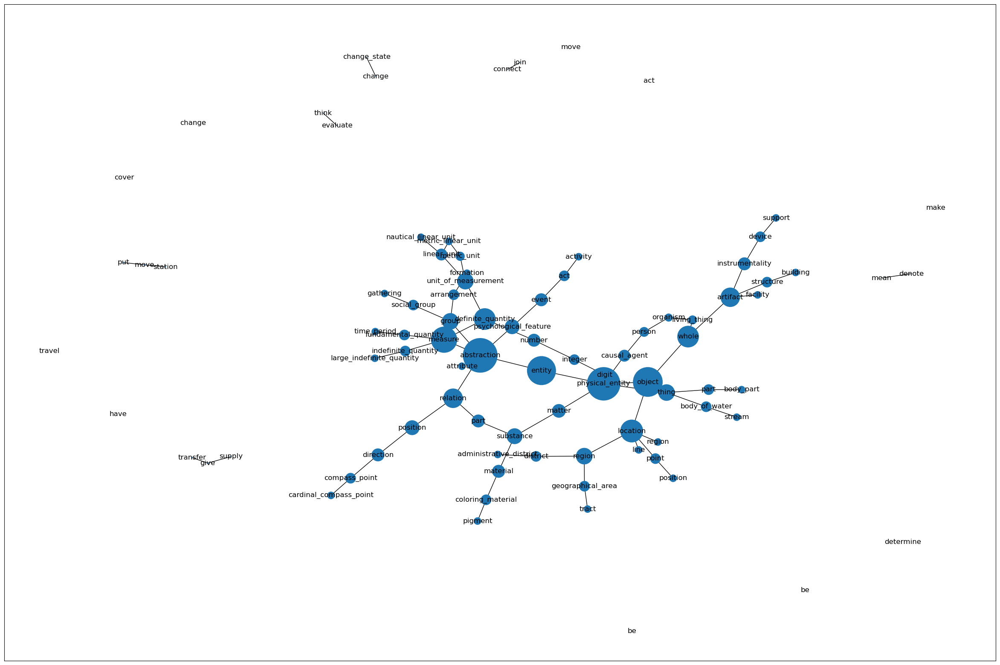

In [91]:
 # create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_1_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Place Level 2 Hypernyms 

In [92]:
Place_hyper_words_2_fd_50 = set()
for i in range(0,len(Place_hyper_words_2_fd.most_common(50))):
    Place_hyper_words_2_fd_50.add(Place_hyper_words_2_fd.most_common(50)[i][0])

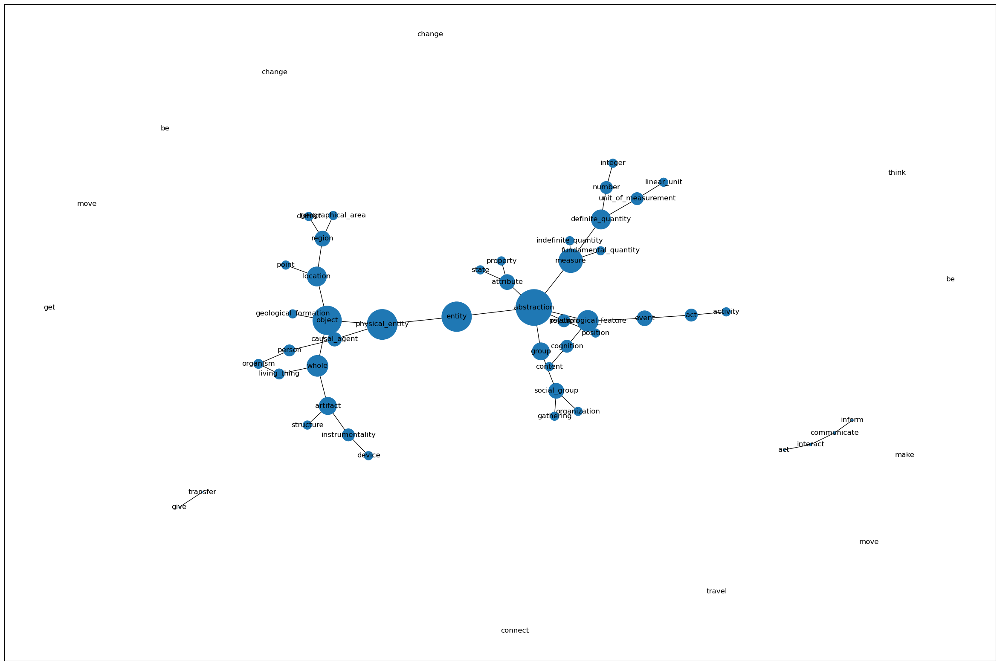

In [93]:
 # create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_2_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

##### Graph for Place Level 3 Hypernyms 

In [94]:
Place_hyper_words_3_fd_50 = set()
for i in range(0,len(Place_hyper_words_3_fd.most_common(50))):
    Place_hyper_words_3_fd_50.add(Place_hyper_words_3_fd.most_common(50)[i][0])

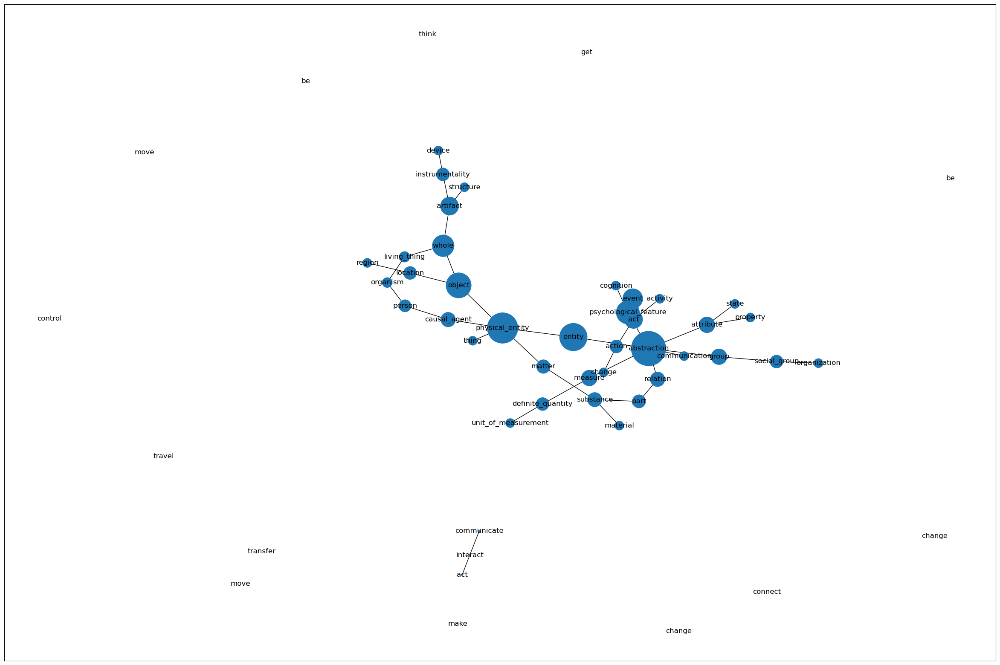

In [95]:
 # create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_3_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

Node group with the words Location, point, region, district and geographical area is taken into account. Observations in embedding space which tfidf scores are nonzero for the specific words 'Location', 'point', 'region', 'district' and 'geographical area' colored different colors. 

In [96]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [97]:
vectorizer = TfidfVectorizer()

In [98]:
vectorizer.fit(train_encoded_df.text)

TfidfVectorizer()

###### Location

In [99]:
location_index = vectorizer.vocabulary_["location"]

In [100]:
idf = vectorizer.idf_[location_index]

In [101]:
tfidf_vectors = vectorizer.transform(train_encoded_df.text)

In [102]:
score_for_location_word = []
for i,text in enumerate(train_encoded_df.text):
    tfidf_score = tfidf_vectors[i, location_index]* idf
    score_for_location_word.append(tfidf_score)

In [103]:
score_for_location_word_array = np.array(score_for_location_word)

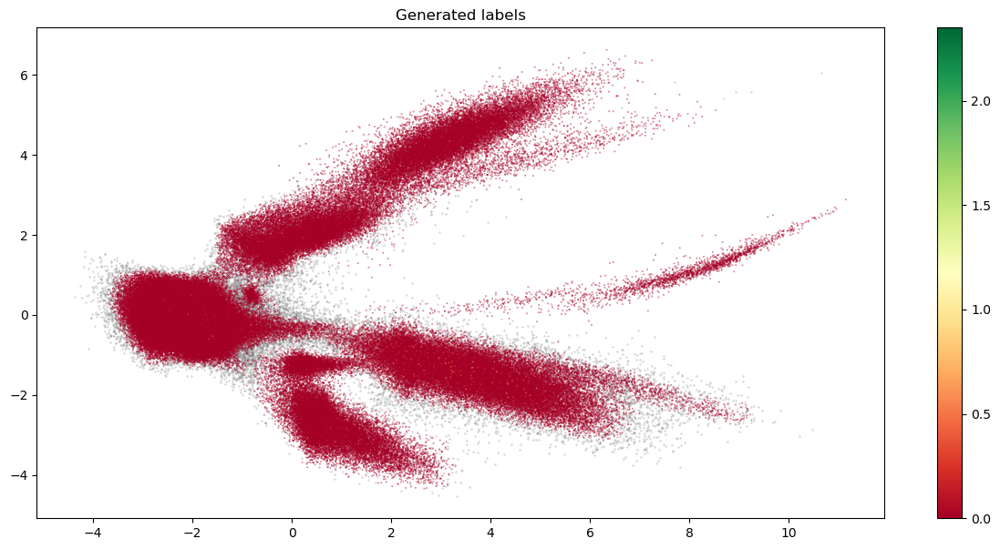

In [104]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_location_word_array[is_clustered]

# plot clustered points with tf-idf scores as colors
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x, y, c=tfidf_scores, s=0.05, cmap='RdYlGn')
plt.title('Generated labels')
plt.colorbar()

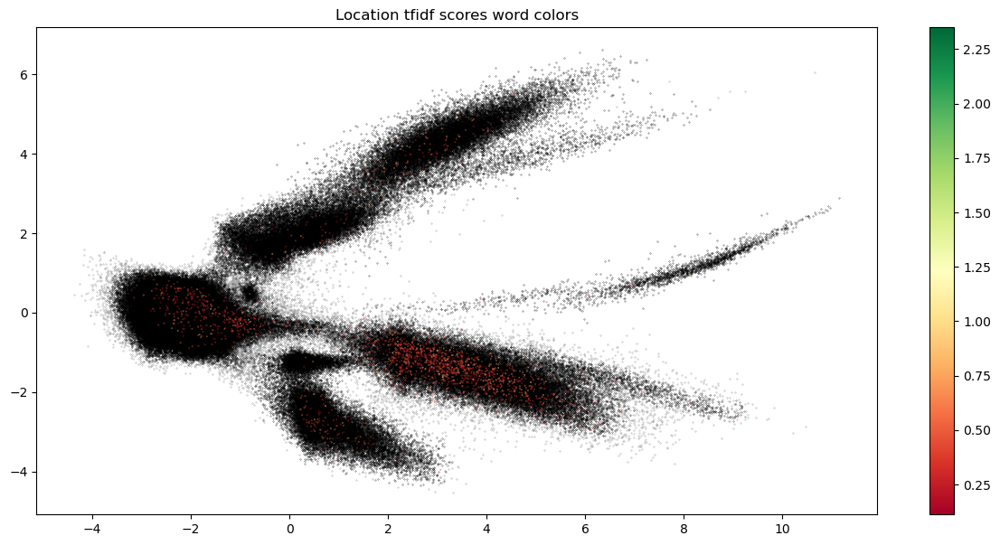

In [105]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_location_word_array[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Location tfidf scores word colors')
plt.colorbar()

###### Region

In [106]:
region_index = vectorizer.vocabulary_["region"]

In [107]:
region_idf = vectorizer.idf_[region_index]

In [108]:
score_for_region_word = []
for i,text in enumerate(train_encoded_df.text):
    tfidf_score = tfidf_vectors[i, region_index]* region_idf
    score_for_region_word.append(tfidf_score)

In [109]:
score_for_region_word_array = np.array(score_for_region_word)

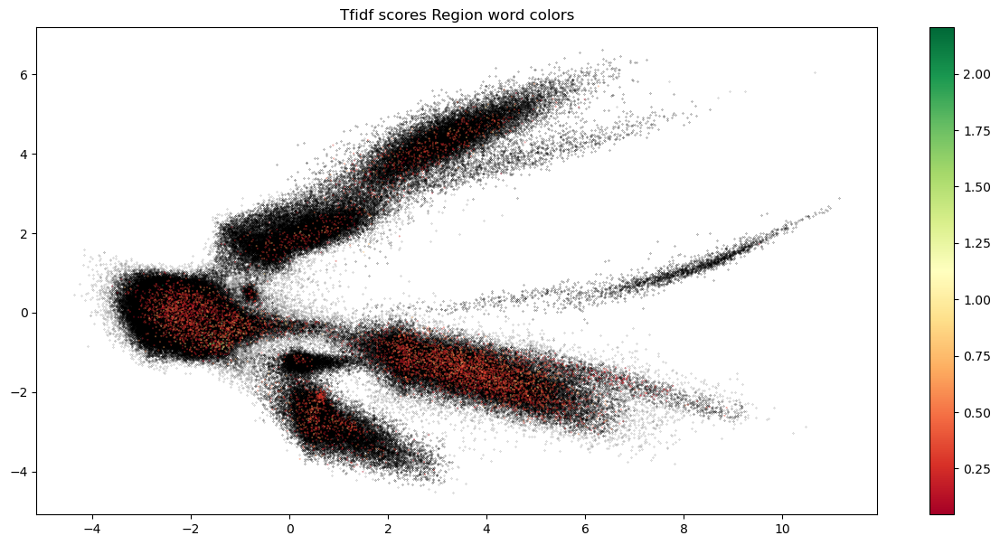

In [110]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_region_word_array[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Tfidf scores Region word colors')
plt.colorbar()

###### District

In [111]:
district_index = vectorizer.vocabulary_["district"]

In [112]:
district_idf = vectorizer.idf_[district_index]

In [113]:
score_for_district_word = []
for i,text in enumerate(train_encoded_df.text):
    tfidf_score = tfidf_vectors[i, district_index]* district_idf
    score_for_district_word.append(tfidf_score)

In [114]:
score_for_district_word_array = np.array(score_for_district_word)

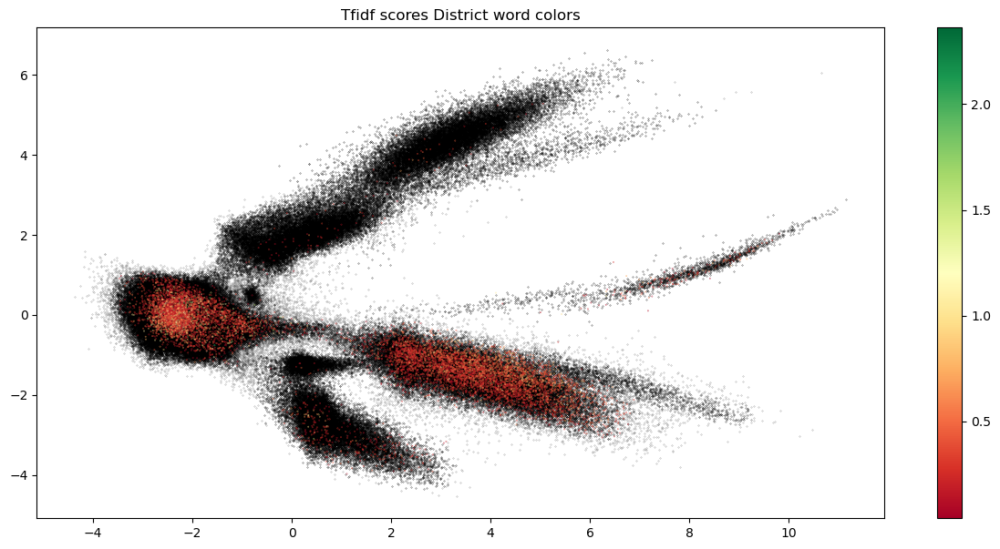

In [115]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_district_word_array[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Tfidf scores District word colors')
plt.colorbar()

###### Point

In [116]:
point_index = vectorizer.vocabulary_["point"]

In [117]:
point_idf = vectorizer.idf_[point_index]

In [118]:
score_for_point_word = []
for i,text in enumerate(train_encoded_df.text):
    tfidf_score = tfidf_vectors[i, point_index]* point_idf
    score_for_point_word.append(tfidf_score)

In [119]:
score_for_point_word_array = np.array(score_for_point_word)

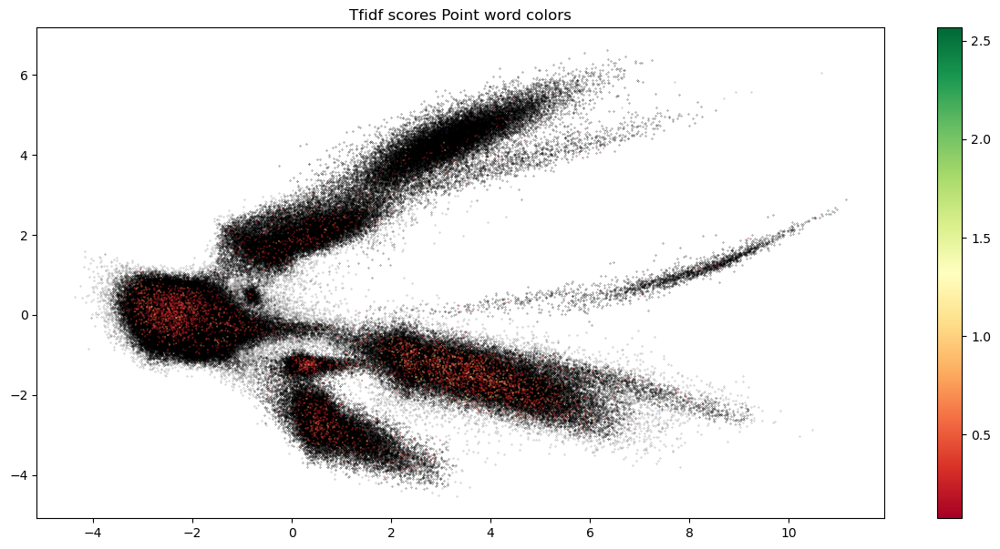

In [120]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_point_word_array[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Tfidf scores Point word colors')
plt.colorbar()

###### Area

In [121]:
area_index = vectorizer.vocabulary_["area"]

In [122]:
area_idf = vectorizer.idf_[area_index]

In [123]:
score_for_area_word = []
for i,text in enumerate(train_encoded_df.text):
    tfidf_score = tfidf_vectors[i, area_index]* area_idf
    score_for_area_word.append(tfidf_score)

In [124]:
score_for_area_word_array = np.array(score_for_area_word)

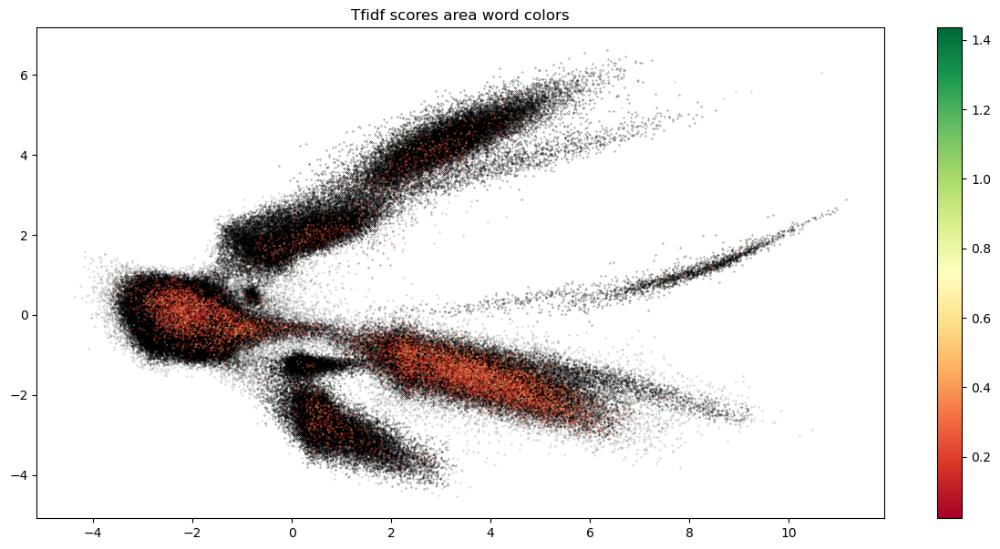

In [125]:
# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_area_word_array[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Tfidf scores area word colors')
plt.colorbar()

##### Finding Node community groups with community_louvain

conda install -c conda-forge python-louvain


###### GraphX node subgroups (communities)  for 'Agent' 

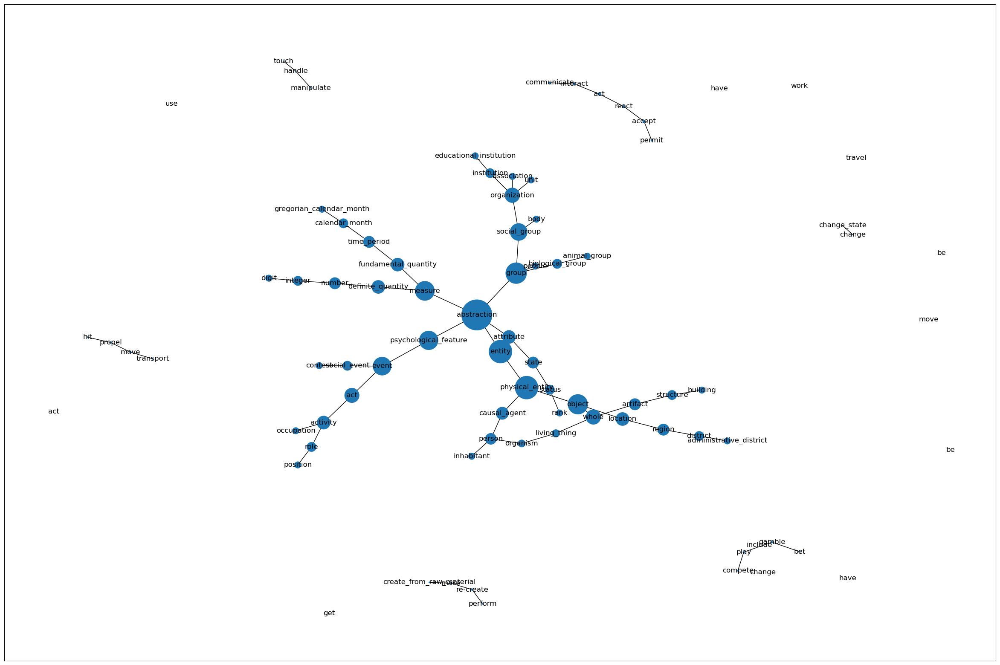

In [126]:
 # create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_1_fd_50)
 
# draw the graph
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/625017653.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)


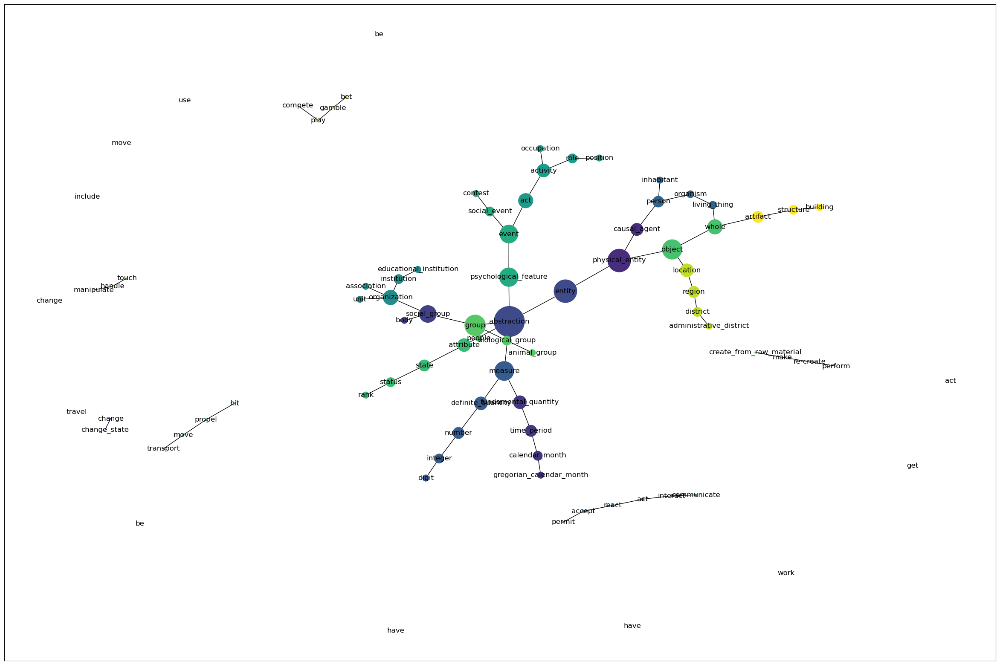

In [127]:
import networkx as nx
import community.community_louvain as cl

# create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_1_fd_50)

# apply Louvain community detection algorithm
partition = cl.best_partition(graph,resolution=5.0)

# draw the graph with community colors
pos = nx.spring_layout(graph)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                 node_color=[cmap(partition[node]) for node in graph.nodes()])
plt.show()

In [128]:
import pandas as pd
import networkx as nx
import community.community_louvain as cl
from networkx.algorithms import community


# create the graph and labels
graph, labels = wordnet_graph(Agent_hyper_words_1_fd_50)

# detect communities using Louvain algorithm
partition = cl.best_partition(graph,resolution=5.0)

# calculate centrality measures
degree_centrality = nx.degree_centrality(graph)
betweenness_centrality = nx.betweenness_centrality(graph)
closeness_centrality = nx.closeness_centrality(graph)
eigenvector_centrality = nx.eigenvector_centrality(graph)

# create a dataframe to store the nodes and their centrality measures
Agent_nodes_df = pd.DataFrame(columns=['community', 'node_label', 'degree_centrality', 'betweenness_centrality', 'closeness_centrality'])

# iterate through the nodes and assign their community labels and centrality measures to the dataframe
for node in graph.nodes():
    community_label = partition[node]
    node_label = labels[node]
    dc = degree_centrality[node]
    bc = betweenness_centrality[node]
    cc = closeness_centrality[node]
    ec = eigenvector_centrality[node]
    Agent_nodes_df = Agent_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc, 'eigenvector_centrality':ec }, ignore_index=True)

# display the dataframe
Agent_nodes_df

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Agent_nodes_df = Agent_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc, 'eigenvector_centrality':ec }, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Agent_nodes_df = Agent_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc, 'eigenvector_centrality':ec }, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The fram

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Agent_nodes_df = Agent_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc, 'eigenvector_centrality':ec }, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Agent_nodes_df = Agent_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc, 'eigenvector_centrality':ec }, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2454161358.py:30: FutureWarning: The fram

,community,node_label,degree_centrality,betweenness_centrality,closeness_centrality,eigenvector_centrality
0,0,be,0.000000,0.000000,0.000000,1.893121e-43
1,1,be,0.000000,0.000000,0.000000,1.893121e-43
2,2,change,0.011905,0.000000,0.011905,3.576004e-21
3,3,include,0.000000,0.000000,0.000000,1.893121e-43
4,17,unit,0.011905,0.000000,0.086879,5.833908e-02
...,...,...,...,...,...,...
80,25,touch,0.011905,0.000000,0.015873,3.418297e-15
81,12,administrative_district,0.011905,0.000000,0.067414,2.876618e-03
82,12,district,0.023810,0.013769,0.076020,7.769631e-03
83,12,region,0.023810,0.026965,0.086616,1.810952e-02


In [129]:
Agent_community_groups = Agent_nodes_df.groupby('community')['node_label'].apply(list)


In [130]:
# Community words
for i in range (0, len(Agent_community_groups)):
    print(Agent_community_groups[i])

['be']
['be']
['change', 'change_state']
['include']
['social_group', 'body']
['building', 'structure', 'artifact', 'whole']
['group', 'people', 'animal_group', 'biological_group']
['abstraction', 'attribute']
['entity', 'physical_entity']
['get']
['digit', 'integer', 'number', 'definite_quantity']
['inhabitant', 'person', 'causal_agent', 'organism', 'living_thing']
['object', 'location', 'administrative_district', 'district', 'region']
['permit', 'accept', 'react', 'act', 'communicate', 'interact']
['move', 'hit', 'propel', 'transport']
['have']
['use']
['unit', 'organization', 'educational_institution', 'institution', 'association']
['move']
['measure', 'gregorian_calendar_month', 'calendar_month', 'time_period', 'fundamental_quantity']
['position', 'role', 'activity', 'act', 'occupation']
['event', 'psychological_feature', 'contest', 'social_event']
['have']
['rank', 'status', 'state']
['act']
['manipulate', 'handle', 'touch']
['re-create', 'make', 'perform', 'create_from_raw_materi

##### Score for the community communication in the Agent class ('communicate', 'interact', 'act', 'permit', 'accept', 'react')

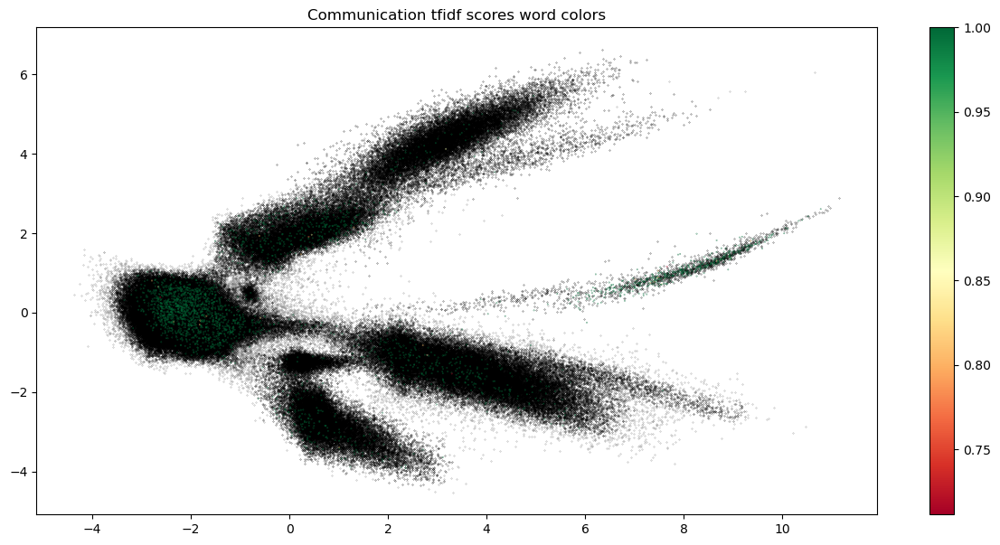

In [131]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_communication = ['communicate', 'interact', 'act', 'permit', 'accept', 'react']

vectorizer = TfidfVectorizer(vocabulary=community_communication)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_communication_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_communication_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Communication tfidf scores word colors')
plt.colorbar()

##### Score for the community animal in the Agent class ('animal_group', 'biological_group', 'group', 'people')


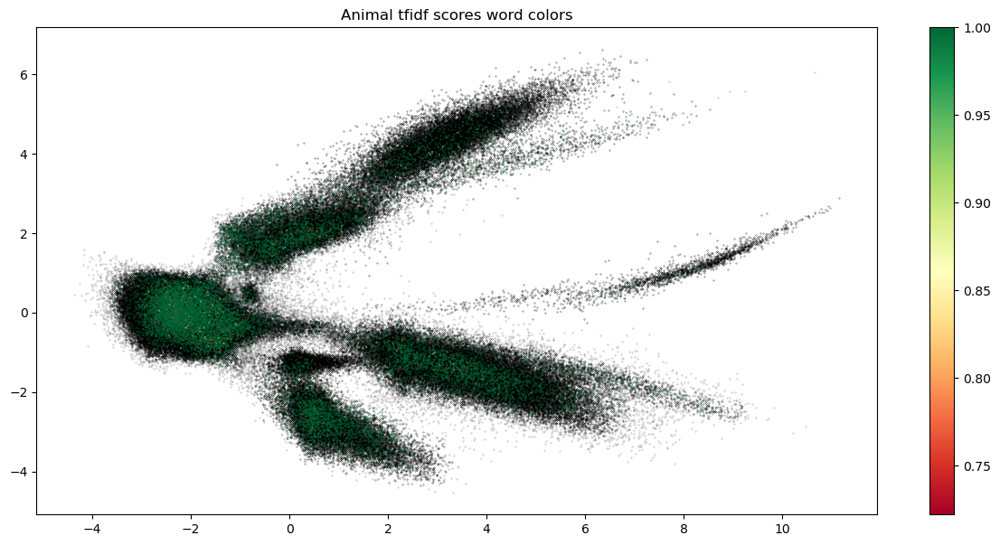

In [132]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_animal = ['animal group', 'biological group', 'group', 'people', 'animal']

vectorizer = TfidfVectorizer(vocabulary=community_animal)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_animal_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_animal_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Animal tfidf scores word colors')
plt.colorbar()

##### Score for the community creativity in the Agent class ('perform', 're-create', 'make', 'create_from_raw_material')


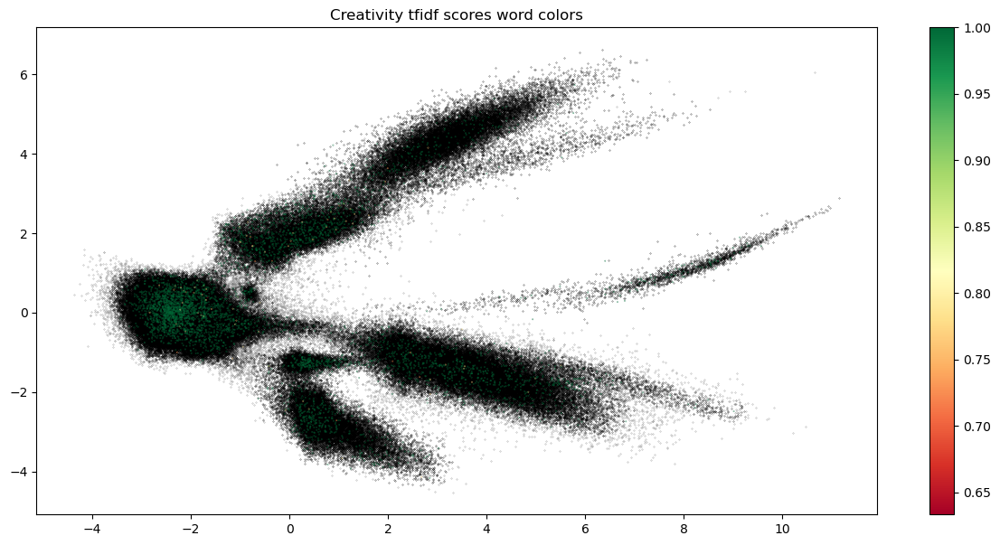

In [133]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_creativity = ['perform', 're-create', 'make', 'create from raw material','create','raw material','recreate']


vectorizer = TfidfVectorizer(vocabulary=community_creativity)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_creativity_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_creativity_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Creativity tfidf scores word colors')
plt.colorbar()

##### Score for the community compete in the Agent class ('bet', 'gamble', 'play', 'compete')¶


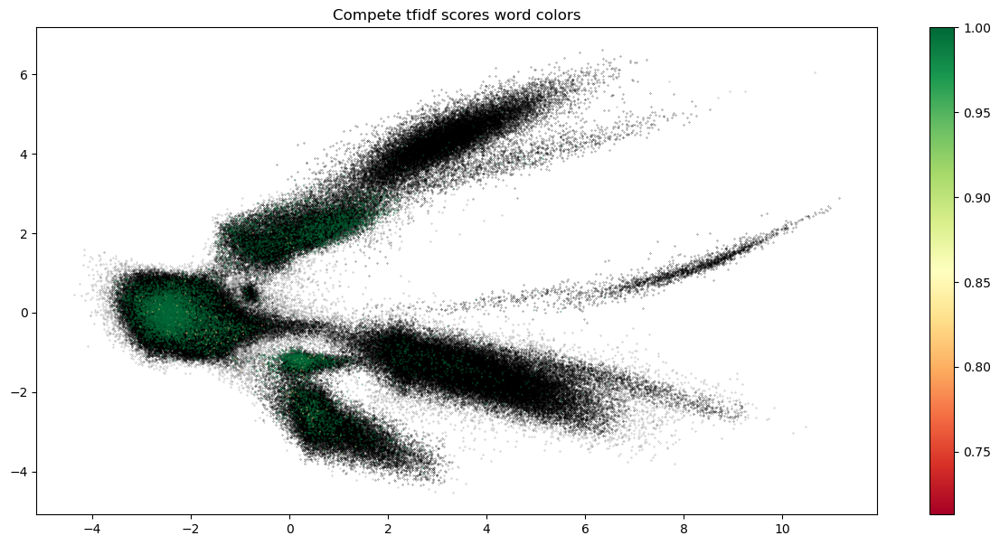

In [134]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_compete = ['bet', 'gamble', 'play', 'compete']

vectorizer = TfidfVectorizer(vocabulary=community_compete)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_compete_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_compete_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Compete tfidf scores word colors')
plt.colorbar()


###### GraphX node subgroups (communities)  for 'Place' 

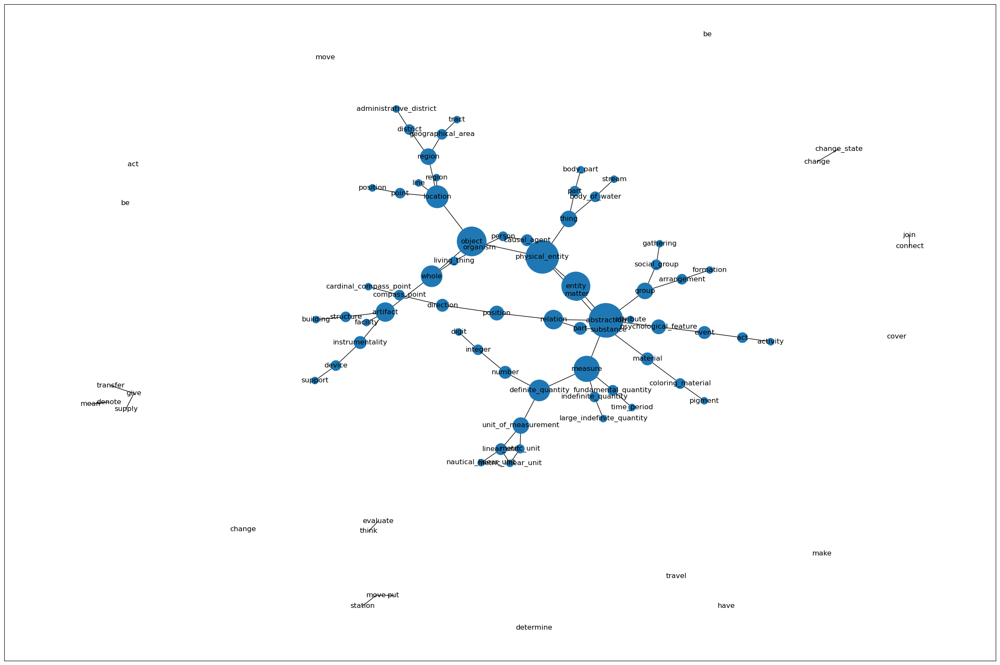

In [135]:
 # create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_1_fd_50)
 
# draw the graph
#nx.closure_graph(graph)
pos=nx.spring_layout(graph)
index = nx.betweenness_centrality(graph,endpoints=True)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
nx.draw_networkx(graph, pos=pos,node_size=node_size, labels=labels, alpha=1, linewidths=0)
pl.show()

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3733106484.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)


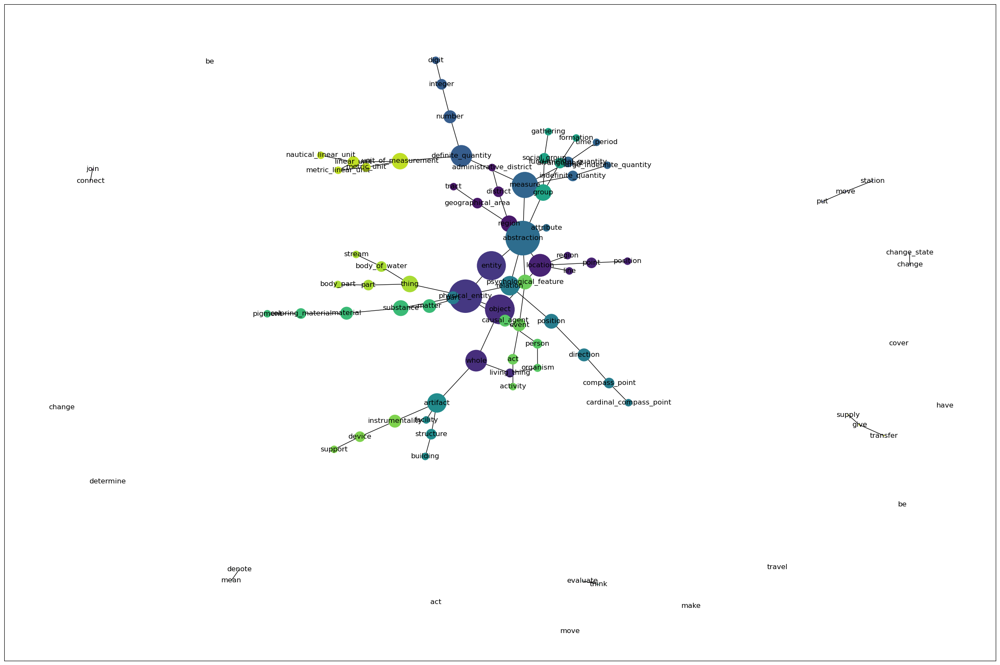

In [136]:
import networkx as nx
import community.community_louvain as cl

# create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_1_fd_50)

# apply Louvain community detection algorithm
partition = cl.best_partition(graph,resolution=5.0)

# draw the graph with community colors
pos = nx.spring_layout(graph)
plt.rc('figure', figsize=(30, 20))
node_size = [index[n]*10000 for n in graph]
cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                 node_color=[cmap(partition[node]) for node in graph.nodes()])
plt.show()

In [137]:
import pandas as pd
import networkx as nx
import community.community_louvain as cl
from networkx.algorithms import community


# create the graph and labels
graph, labels = wordnet_graph(Place_hyper_words_1_fd_50)

# detect communities using Louvain algorithm
partition = cl.best_partition(graph,resolution=5.0)

# calculate centrality measures
degree_centrality = nx.degree_centrality(graph)
betweenness_centrality = nx.betweenness_centrality(graph)
closeness_centrality = nx.closeness_centrality(graph)
#eigenvector_centrality = nx.eigenvector_centrality(graph)

# create a dataframe to store the nodes and their centrality measures
Place_nodes_df = pd.DataFrame(columns=['community', 'node_label', 'degree_centrality', 'betweenness_centrality', 'closeness_centrality'])

# iterate through the nodes and assign their community labels and centrality measures to the dataframe
for node in graph.nodes():
    community_label = partition[node]
    node_label = labels[node]
    dc = degree_centrality[node]
    bc = betweenness_centrality[node]
    cc = closeness_centrality[node]
#    ec = eigenvector_centrality[node]
    Place_nodes_df = Place_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc}, ignore_index=True)

# display the dataframe
Place_nodes_df

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/698937985.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Place_nodes_df = Place_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc}, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/698937985.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Place_nodes_df = Place_nodes_df.append({'community': community_label, 'node_label': node_label, 'degree_centrality': dc, 'betweenness_centrality': bc, 'closeness_centrality': cc}, ignore_index=True)
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/698937985.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas i

,community,node_label,degree_centrality,betweenness_centrality,closeness_centrality
0,0,be,0.000000,0.000000,0.000000
1,1,join,0.011236,0.000000,0.011236
2,1,connect,0.011236,0.000000,0.011236
3,2,region,0.033708,0.063330,0.125256
4,3,location,0.056180,0.135087,0.146972
...,...,...,...,...,...
85,2,tract,0.011236,0.000000,0.094004
86,2,geographical_area,0.022472,0.016343,0.107646
87,21,large_indefinite_quantity,0.011236,0.000000,0.113298
88,21,indefinite_quantity,0.022472,0.016343,0.133724


In [138]:
Place_community_groups = Place_nodes_df.groupby('community')['node_label'].apply(list)


In [139]:
# Community words
for i in range (0, len(Place_community_groups)):
    print(Place_community_groups[i])

['be']
['join', 'connect']
['region', 'administrative_district', 'district', 'tract', 'geographical_area']
['location', 'region', 'position', 'point', 'line']
['object', 'whole']
['physical_entity', 'entity']
['be']
['station', 'move', 'put']
['change', 'change_state']
['digit', 'integer', 'number']
['make']
['act']
['abstraction', 'attribute']
['denote', 'mean']
['cardinal_compass_point', 'compass_point', 'direction', 'position']
['relation', 'part']
['artifact', 'facility', 'building', 'structure']
['have']
['evaluate', 'think']
['determine']
['move']
['measure', 'time_period', 'fundamental_quantity', 'large_indefinite_quantity', 'indefinite_quantity']
['pigment', 'coloring_material', 'material', 'substance', 'matter']
['person', 'causal_agent', 'organism', 'living_thing']
['activity', 'act', 'event', 'psychological_feature']
['support', 'device', 'instrumentality']
['gathering', 'social_group', 'group', 'formation', 'arrangement']
['body_part', 'part', 'thing', 'stream', 'body_of_wa

##### Score for the community unit in the Place class ('linear unit', 'unit of measurement', 'metric linear unit', 'metric unit', 'nautical linear unit', 'unit','metric','measure','measurement','linear')


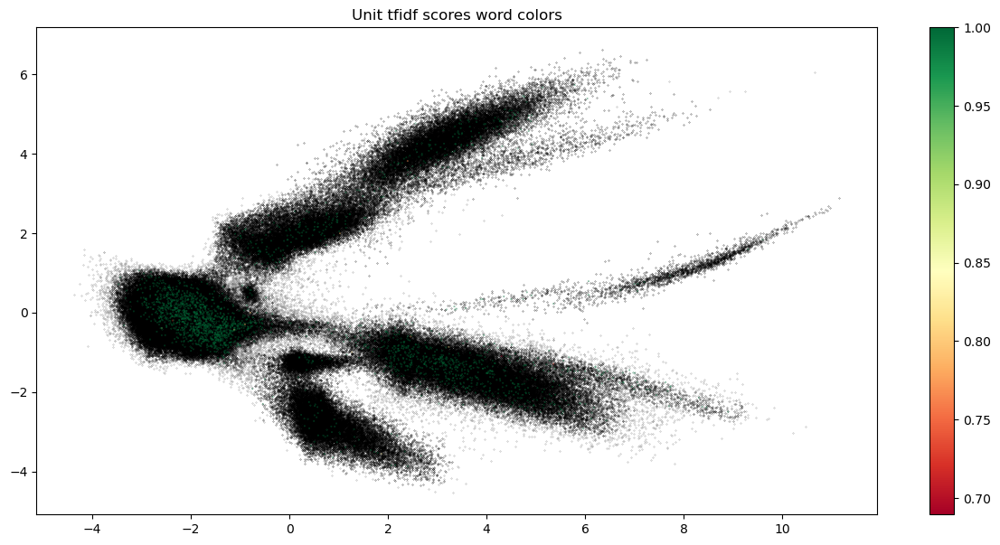

In [140]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_unit = ['linear unit', 'unit of measurement', 'metric linear unit', 'metric unit', 'nautical linear unit', 'unit','metric','measure','measurement','linear']


vectorizer = TfidfVectorizer(vocabulary=community_unit)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_unit_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_unit_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Unit tfidf scores word colors')
plt.colorbar()

##### Score for the community water in the Place class ('stream', 'body of water', 'lake','water','waterfall')


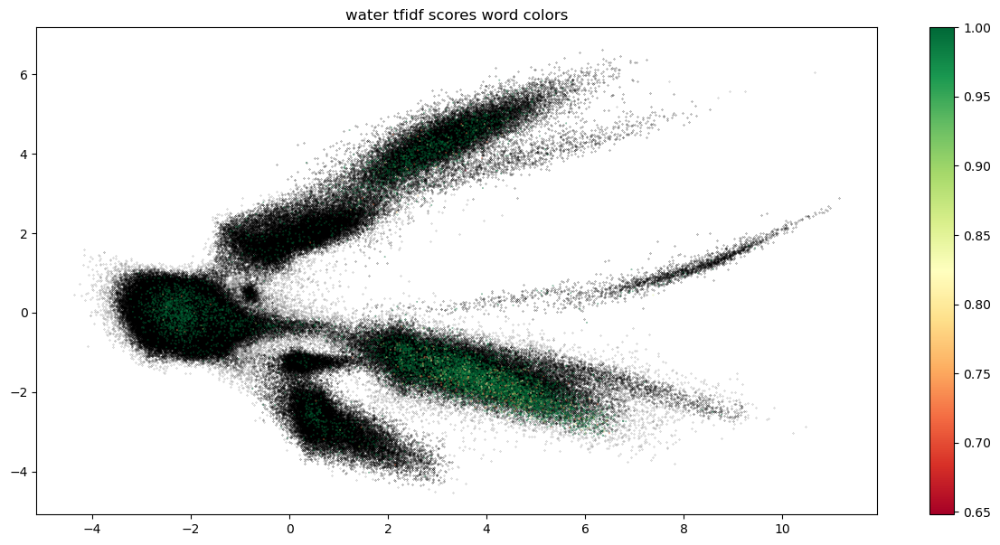

In [141]:

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_water = ['stream', 'body of water', 'lake','water','waterfall']

vectorizer = TfidfVectorizer(vocabulary=community_water)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_water_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_water_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('water tfidf scores word colors')
plt.colorbar()

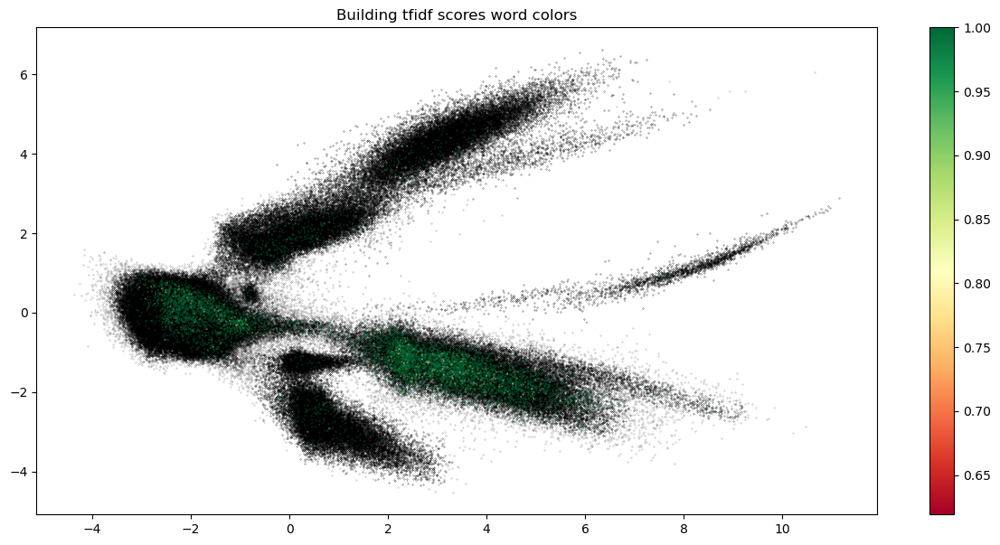

In [142]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
building_unit = ['artifact', 'building', 'structure', 'facility']


vectorizer = TfidfVectorizer(vocabulary=building_unit)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_building_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_building_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Building tfidf scores word colors')
plt.colorbar()

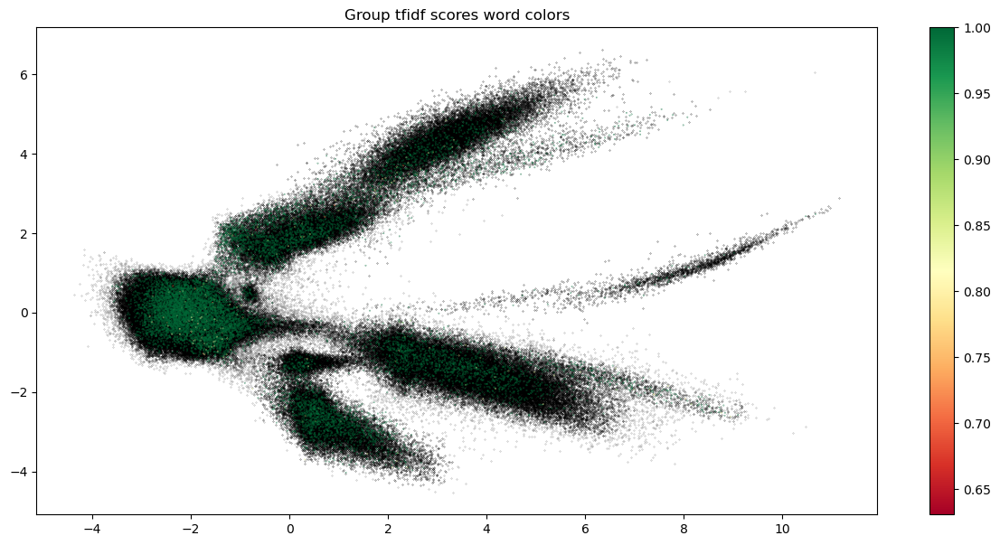

In [143]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_group = ['formation', 'arrangement', 'group', 'gathering', 'social group']


vectorizer = TfidfVectorizer(vocabulary=community_group)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_group_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_group_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Group tfidf scores word colors')
plt.colorbar()

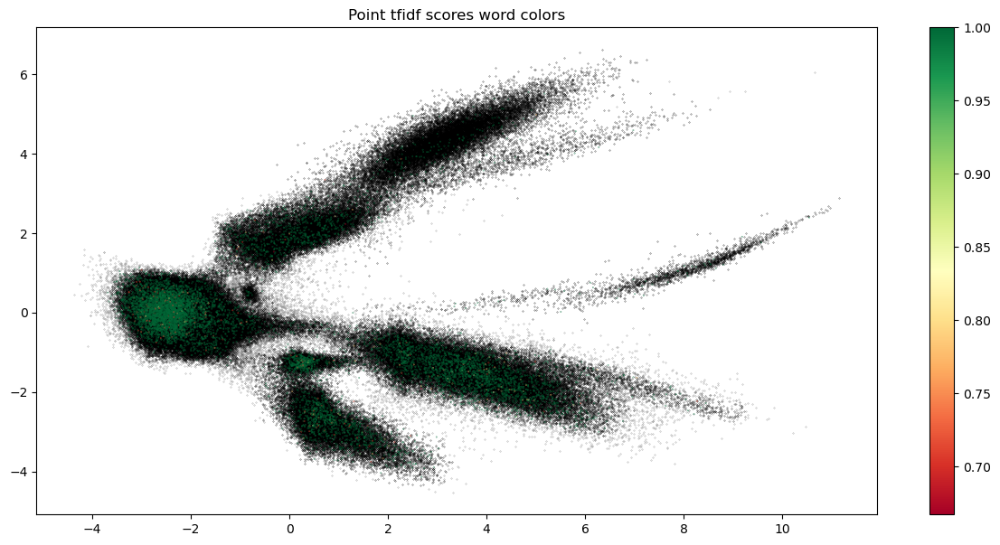

In [144]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_point = ['cardinal compass point', 'compass point', 'direction', 'position','point']


vectorizer = TfidfVectorizer(vocabulary=community_point)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_point_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_point_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Point tfidf scores word colors')
plt.colorbar()

##### How clusters are related  

In [145]:
train_encoded_df_with_pca = pd.merge(train_encoded_df, result[['x', 'y']], left_index=True, right_index=True)
train_encoded_df_with_pca = pd.merge(train_encoded_df_with_pca, df_train[['l2', 'l3']], left_index=True, right_index=True)
train_encoded_df_with_pca.head(3)

,text_encodings,text,encoded_l1_labels,l1,tokenized_text,hdbscan_predicted_labels,x,y,l2,l3
0,"[0.007814435288310051, 0.010714929550886154, 0...","William Alexander Massey (October 7, 1856 – Ma...",0,Agent,"[william, alexander, massey, october, march, u...",8,-2.654283,0.187735,Politician,Senator
1,"[0.007814435288310051, 0.010714929550886154, 0...",Lions is the sixth studio album by American ro...,8,Work,"[lion, sixth, studio, album, american, rock, b...",-1,0.223328,2.175429,MusicalWork,Album
2,"[0.007814435288310051, 0.010714929550886154, 0...","Pirqa (Aymara and Quechua for wall, hispaniciz...",3,Place,"[pirqa, aymara, quechua, wall, hispanicized, s...",6,5.875440,-2.038176,NaturalPlace,Mountain


##### Location community

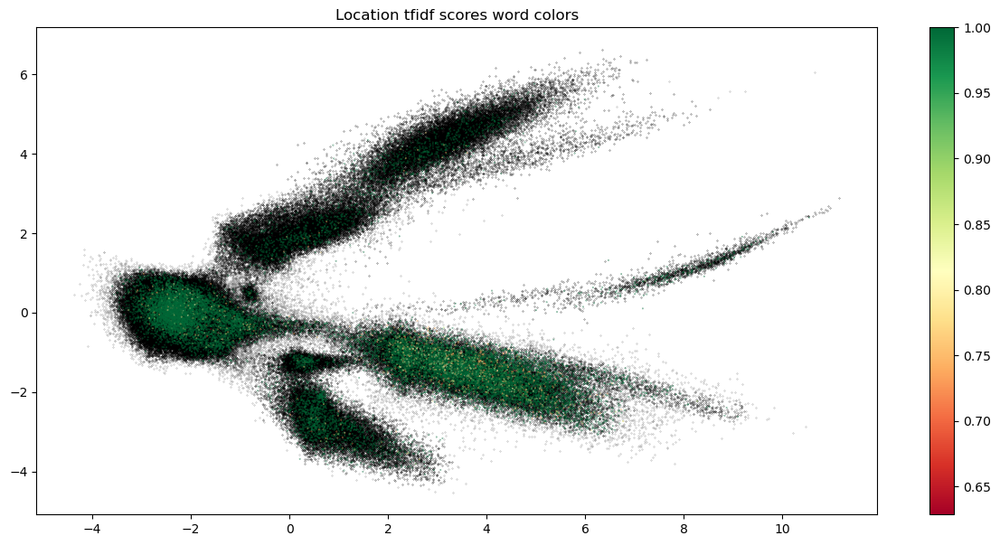

In [146]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# define list of words for the node community
community_location = ['location', 'region', 'district', 'administrative district', 'point']

vectorizer = TfidfVectorizer(vocabulary=community_location)
tfidf_vectors = vectorizer.fit_transform(train_encoded_df.text)
score_for_location_words = tfidf_vectors.max(axis=1).toarray().squeeze()

# create boolean array indicating clustered points
is_clustered = result.labels != -1

# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_location_words[is_clustered]

# separate points with zero and non-zero tf-idf scores
zero_scores_mask = tfidf_scores == 0
nonzero_scores_mask = tfidf_scores != 0

# plot green background with observations with zero tf-idf scores
fig, ax = plt.subplots(figsize=(15, 7))
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(x[zero_scores_mask], y[zero_scores_mask], c='black', s=0.05)

# plot observations with non-zero tf-idf scores
plt.scatter(x[nonzero_scores_mask], y[nonzero_scores_mask], c=tfidf_scores[nonzero_scores_mask], s=0.05, cmap='RdYlGn')

# show colorbar legend
plt.title('Location tfidf scores word colors')
plt.colorbar()

In [147]:
# extract x, y, and tf-idf scores for clustered points
x = result.loc[is_clustered, 'x']
y = result.loc[is_clustered, 'y']
tfidf_scores = score_for_location_words[is_clustered]

# create a new dataframe with the non-zero tf-idf scores observations
location_words_df = pd.DataFrame({'x': x[nonzero_scores_mask], 'y': y[nonzero_scores_mask], 'tfidf_scores': tfidf_scores[nonzero_scores_mask]})


In [148]:
# merge train_encoded_df and location_words_df dataframes based on their x and y coordinates
#location_df = pd.merge(train_encoded_df_with_pca, location_words_df, on=['x', 'y'], how='inner')
location_df = pd.merge(train_encoded_df_with_pca, location_words_df[['tfidf_scores']], left_index=True, right_index=True,how='inner')
location_df.head()

,text_encodings,text,encoded_l1_labels,l1,tokenized_text,hdbscan_predicted_labels,x,y,l2,l3,tfidf_scores
0,"[0.007814435288310051, 0.010714929550886154, 0...","William Alexander Massey (October 7, 1856 – Ma...",0,Agent,"[william, alexander, massey, october, march, u...",8,-2.654283,0.187735,Politician,Senator,1.000000
2,"[0.007814435288310051, 0.010714929550886154, 0...","Pirqa (Aymara and Quechua for wall, hispaniciz...",3,Place,"[pirqa, aymara, quechua, wall, hispanicized, s...",6,5.875440,-2.038176,NaturalPlace,Mountain,0.742211
13,"[0.007814435288310051, 0.010714929550886154, 0...",Dhadgaon (also known as Akrani or Akrani Mahal...,3,Place,"[dhadgaon, also, known, akrani, akrani, mahal,...",6,3.818336,-1.745133,Settlement,Town,1.000000
24,"[0.007814435288310051, 0.010714929550886154, 0...",Grand Arena is located south of Bucharest in B...,3,Place,"[grand, arena, located, south, bucharest, berc...",6,3.929391,-1.511434,Building,ShoppingMall,1.000000
43,"[0.007814435288310051, 0.010714929550886154, 0...",The 2010 Chicago Cardinals season was the thir...,5,SportsSeason,"[chicago, cardinal, season, third, season, con...",1,0.390784,-1.097756,FootballLeagueSeason,NationalFootballLeagueSeason,1.000000


In [149]:
location_df.l1.value_counts()

Place             9946
Agent             7370
Event             1449
Species            772
Work               599
SportsSeason       260
UnitOfWork         176
TopicalConcept      49
Device              10
Name: l1, dtype: int64

In [150]:
location_df_place = location_df[location_df.l1 == "Place"]
location_df_place.l2.value_counts()

Settlement                      2241
Building                        1583
NaturalPlace                    1504
Infrastructure                  1197
RouteOfTransportation            943
BodyOfWater                      554
Stream                           514
Tower                            367
CelestialBody                    285
Station                          237
SportFacility                    207
ClericalAdministrativeRegion     145
Satellite                         65
Venue                             59
AmusementParkAttraction           34
RaceTrack                         11
Name: l2, dtype: int64

In [151]:
location_df_agent = location_df[location_df.l1 == "Agent"]
location_df_agent.l2.value_counts()

Person                    1604
Politician                1292
EducationalInstitution    1054
Athlete                    811
Organisation               653
Company                    468
Broadcaster                395
SportsLeague               256
SportsTeam                 222
Cleric                     163
WinterSportPlayer           84
Coach                       78
Artist                      71
FictionalCharacter          36
Group                       34
RacingDriver                32
SportsManager               31
GridironFootballPlayer      26
Writer                      14
Scientist                   12
Actor                        6
Wrestler                     6
Boxer                        5
OrganisationMember           4
ComicsCharacter              3
MusicalArtist                2
BritishRoyalty               2
Presenter                    2
VolleyballPlayer             2
MotorcycleRider              2
Name: l2, dtype: int64

### Hierarchical Clustering on top of clustering validation data

In [20]:
import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy

# Run HDBSCAN clustering
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(val_prediction)

# Prepare data for visualization
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Perform hierarchical clustering on top of HDBSCAN clustering
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')

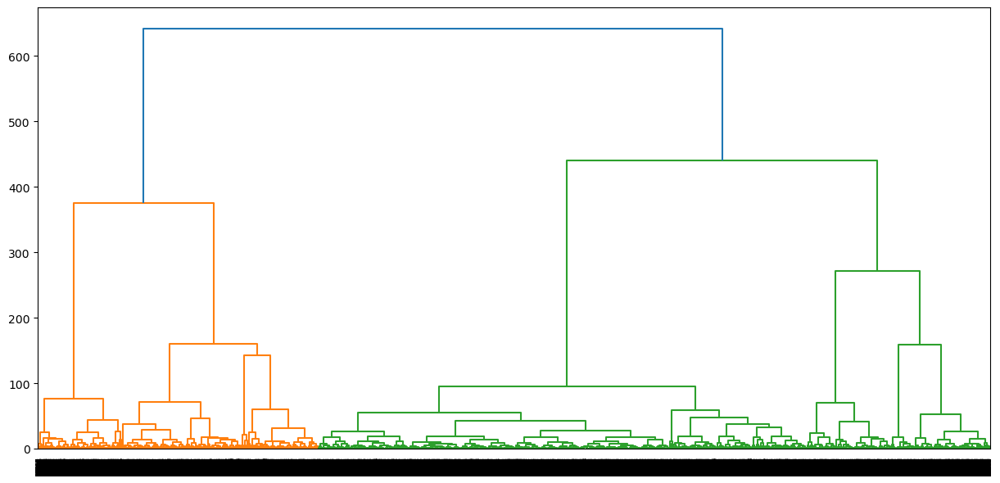

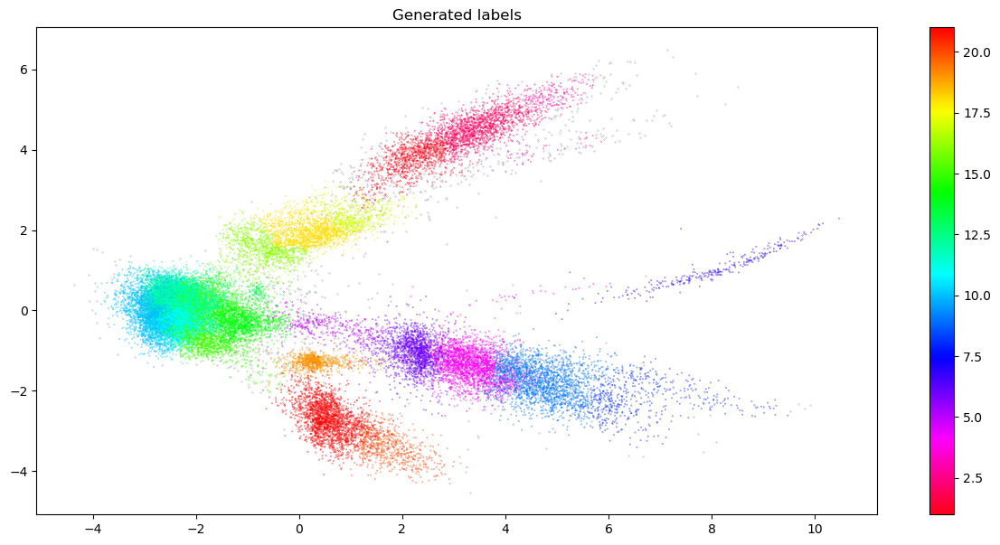

In [21]:
# Add hierarchical cluster labels to the result DataFrame
result['hierarchical_labels'] = flat_clusters

# Visualize dendrogram
fig, ax = plt.subplots(figsize=(15, 7))
dendrogram = hierarchy.dendrogram(linkage_matrix)

# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
plt.title('Generated labels')
plt.colorbar()


In [22]:
val_hier_df = pd.merge(df_val, result, left_index=True, right_index=True)
val_hier_df["text_encodings"] = val_prediction.tolist()
val_hier_df

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings
0,Li Curt is a station on the Bernina Railway li...,Place,Station,RailwayStation,1.726188,-0.914973,4,6,"[0.007814435288310051, 0.010714929550886154, 0..."
1,Grafton State Hospital was a psychiatric hospi...,Place,Building,Hospital,4.546166,-1.843933,4,4,"[0.007814435288310051, 0.010714929550886154, 0..."
2,The Democratic Patriotic Alliance of Kurdistan...,Agent,Organisation,PoliticalParty,-1.640161,-0.999509,6,15,"[0.007814435288310051, 0.010714929550886154, 0..."
3,"Ira Rakatansky (October 3, 1919 – March 4, 201...",Agent,Person,Architect,-2.612972,0.127929,6,12,"[0.007814435288310051, 0.010714929550886154, 0..."
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298840,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0..."
...,...,...,...,...,...,...,...,...,...
35998,The Great Pershing Balloon Derby is a hot air ...,Event,SocietalEvent,Convention,0.533597,-2.074033,5,21,"[0.007814435288310051, 0.010714929550886154, 0..."
35999,Microsystems was a personal computing magazine...,Work,PeriodicalLiterature,Magazine,-0.590401,1.340483,7,16,"[0.007814435288310051, 0.010714929550886154, 0..."
36000,The 1899 Open Championship was the 39th Open C...,Event,Tournament,GolfTournament,0.620415,-2.774530,5,21,"[0.007814435288310051, 0.010714929550886154, 0..."
36001,Kristina Repelewska (born 7 January 1981) is a...,Agent,Athlete,HandballPlayer,-3.297610,-0.588829,6,10,"[0.007814435288310051, 0.010714929550886154, 0..."


##### AGENT HIERARCHICAL CLUSTERS with L2 LABELS

In [155]:
val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels.value_counts()

12    5824
11    4066
15    3381
10    3379
14    1632
5      244
16      75
19      14
13      12
6        9
21       9
4        1
7        1
Name: hierarchical_labels, dtype: int64

In [156]:
label_12_counts = val_hier_df[val_hier_df.hierarchical_labels == 12].l2.value_counts()
label_12_counts_percentages = label_12_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_12_counts_percentages[label_12_counts_percentages > 1])

Person        7.899394
Athlete       7.835040
Politician    3.453639
Cleric        2.354266
Artist        2.295275
Name: l2, dtype: float64


In [157]:
label_11_counts = val_hier_df[val_hier_df.hierarchical_labels == 11].l2.value_counts()
label_11_counts_percentages = label_11_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_11_counts_percentages[label_11_counts_percentages > 1])

Athlete              8.188985
Person               3.555532
Politician           2.922722
WinterSportPlayer    2.080764
Name: l2, dtype: float64


In [158]:
label_15_counts = val_hier_df[val_hier_df.hierarchical_labels == 15].l2.value_counts()
label_15_counts_percentages = label_15_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_15_counts_percentages[label_15_counts_percentages > 1])

Organisation    2.659945
Company         2.252373
Athlete         2.053950
SportsTeam      1.855526
Person          1.732182
Broadcaster     1.490856
SportsLeague    1.394326
Group           1.222717
Name: l2, dtype: float64


In [159]:
label_10_counts = val_hier_df[val_hier_df.hierarchical_labels == 10].l2.value_counts()
label_10_counts_percentages = label_10_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_10_counts_percentages[label_10_counts_percentages > 1])

Athlete              6.639138
Person               1.732182
WinterSportPlayer    1.469405
SportsTeam           1.136912
Name: l2, dtype: float64


In [160]:
label_14_counts = val_hier_df[val_hier_df.hierarchical_labels == 14].l2.value_counts()
label_14_counts_percentages = label_14_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_14_counts_percentages[label_14_counts_percentages > 1])

Company                   2.611680
EducationalInstitution    1.571298
Organisation              1.442591
Name: l2, dtype: float64


In [161]:
label_5_counts = val_hier_df[val_hier_df.hierarchical_labels == 5].l2.value_counts()
label_5_counts_percentages = label_5_counts / len(val_hier_df[val_hier_df.l1 == "Agent"].hierarchical_labels) * 100
print(label_5_counts_percentages[label_5_counts_percentages > .5])

Organisation             0.622084
RouteOfTransportation    0.541642
Name: l2, dtype: float64


In [162]:
label_5_counts = val_hier_df[val_hier_df.hierarchical_labels == 5].l2.value_counts()
label_5_counts_percentages = label_5_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_5_counts_percentages[label_5_counts_percentages > .5])

Organisation              1.692195
RouteOfTransportation     1.473377
Building                  0.860686
EducationalInstitution    0.568928
Company                   0.539752
Name: l2, dtype: float64


##### PLACE HIERARCHICAL CLUSTERS with L2 LABELS

In [163]:
val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels.value_counts()

4     2334
9     2101
6     1654
8      551
5      199
21       6
14       5
15       2
20       1
12       1
16       1
Name: hierarchical_labels, dtype: int64

In [164]:
label_4_counts = val_hier_df[val_hier_df.hierarchical_labels == 4].l2.value_counts()
label_4_counts_percentages = label_4_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_4_counts_percentages[label_4_counts_percentages > 1])

Building                        8.242159
NaturalPlace                    4.843180
RouteOfTransportation           4.070022
Settlement                      2.844639
Infrastructure                  2.698760
SportFacility                   2.494530
Stream                          1.633844
BodyOfWater                     1.444201
ClericalAdministrativeRegion    1.342086
Tower                           1.254559
Station                         1.006565
Name: l2, dtype: float64


In [165]:
label_9_counts = val_hier_df[val_hier_df.hierarchical_labels == 9].l2.value_counts()
label_9_counts_percentages = label_9_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_9_counts_percentages[label_9_counts_percentages > 1])

Building                        6.024799
NaturalPlace                    4.770241
Settlement                      3.442743
RouteOfTransportation           2.669584
Infrastructure                  2.582057
Stream                          2.129832
BodyOfWater                     2.013129
CelestialBody                   1.881838
ClericalAdministrativeRegion    1.692195
Satellite                       1.531729
Name: l2, dtype: float64


In [166]:
label_6_counts = val_hier_df[val_hier_df.hierarchical_labels == 6].l2.value_counts()
label_6_counts_percentages = label_6_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_6_counts_percentages[label_6_counts_percentages > 1])

Building                 6.987600
RouteOfTransportation    4.318016
Infrastructure           2.056893
Station                  1.721371
Settlement               1.560904
SportFacility            1.517141
NaturalPlace             1.502553
Name: l2, dtype: float64


In [167]:
label_8_counts = val_hier_df[val_hier_df.hierarchical_labels == 8].l2.value_counts()
label_8_counts_percentages = label_8_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_8_counts_percentages[label_8_counts_percentages > 1])

CelestialBody    2.902991
Building         1.094092
Name: l2, dtype: float64


In [168]:
label_7_counts = val_hier_df[val_hier_df.hierarchical_labels == 7].l2.value_counts()
label_7_counts_percentages = label_7_counts / len(val_hier_df[val_hier_df.l1 == "Place"].hierarchical_labels) * 100
print(label_7_counts_percentages[label_7_counts_percentages > 1])

LegalCase    3.822028
Name: l2, dtype: float64


##### Deep look intp L2 = "Building" with L3 lABELS

In [169]:
val_hier_df.l1.value_counts()

Agent             18647
Place              6855
Species            3210
Work               3141
Event              2854
SportsSeason        879
UnitOfWork          263
TopicalConcept      117
Device               37
Name: l1, dtype: int64

In [170]:
val_hier_df[val_hier_df.l1 == "TopicalConcept"].hierarchical_labels.value_counts()

13    115
15      1
21      1
Name: hierarchical_labels, dtype: int64

In [171]:
label_13_counts = val_hier_df[val_hier_df.hierarchical_labels == 13].l2.value_counts()
label_13_counts_percentages = label_13_counts / len(val_hier_df[val_hier_df.l1 == "TopicalConcept"].hierarchical_labels) * 100
print(label_13_counts_percentages[label_13_counts_percentages > 1])

Genre          98.290598
Group           5.128205
Horse           1.709402
MusicalWork     1.709402
Company         1.709402
Person          1.709402
Name: l2, dtype: float64


In [172]:
val_hier_df[val_hier_df.hierarchical_labels == 13].l3.value_counts()

MusicGenre            115
Band                    6
RaceHorse               2
RecordLabel             2
Single                  1
FashionDesigner         1
MythologicalFigure      1
CultivatedVariety       1
ArtistDiscography       1
Religious               1
Judge                   1
Name: l3, dtype: int64

In [173]:
val_hier_df[val_hier_df.hierarchical_labels == 5].l3.value_counts()

PublicTransitSystem    101
RailwayLine             98
Museum                  31
University              19
Library                 13
                      ... 
Chef                     1
Poet                     1
GolfCourse               1
HockeyTeam               1
Castle                   1
Name: l3, Length: 66, dtype: int64

### Validation Word Tokens

In [23]:
from nltk.tokenize import word_tokenize
from collections import Counter, OrderedDict
import operator
from nltk.corpus import wordnet as wn
from nltk.corpus import stopwords
stop_words=stopwords.words("english")
print(stop_words)
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [24]:
val_hier_df.text

0        Li Curt is a station on the Bernina Railway li...
1        Grafton State Hospital was a psychiatric hospi...
2        The Democratic Patriotic Alliance of Kurdistan...
3        Ira Rakatansky (October 3, 1919 – March 4, 201...
4        Universitatea Reșița is a women handball club ...
                               ...                        
35998    The Great Pershing Balloon Derby is a hot air ...
35999    Microsystems was a personal computing magazine...
36000    The 1899 Open Championship was the 39th Open C...
36001    Kristina Repelewska (born 7 January 1981) is a...
36002    Lamhara is a small town and rural commune in T...
Name: text, Length: 36003, dtype: object

In [25]:
valid_word_tokens = val_hier_df.text.apply(word_tokenize)

In [26]:
valid_word_tokens

0        [Li, Curt, is, a, station, on, the, Bernina, R...
1        [Grafton, State, Hospital, was, a, psychiatric...
2        [The, Democratic, Patriotic, Alliance, of, Kur...
3        [Ira, Rakatansky, (, October, 3, ,, 1919, –, M...
4        [Universitatea, Reșița, is, a, women, handball...
                               ...                        
35998    [The, Great, Pershing, Balloon, Derby, is, a, ...
35999    [Microsystems, was, a, personal, computing, ma...
36000    [The, 1899, Open, Championship, was, the, 39th...
36001    [Kristina, Repelewska, (, born, 7, January, 19...
36002    [Lamhara, is, a, small, town, and, rural, comm...
Name: text, Length: 36003, dtype: object

In [27]:
import re
punctuation = re.compile(r'[-.?–//!,:;()\\|0-9]')

In [28]:
valid_punctuation = []
for i in range(0,len(valid_word_tokens)):
    sentence = valid_word_tokens[i]
    post_punctuation_valid = []
    for words in sentence:
        word = punctuation.sub("",words)
        word = re.sub(re.escape("''"),'',word)
        word = re.sub(re.escape("'s"),'',word)
        if len(word)>0:
            post_punctuation_valid.append(word)
    valid_punctuation.append(post_punctuation_valid)

In [29]:
valid_punctuation

[['Li',
  'Curt',
  'is',
  'a',
  'station',
  'on',
  'the',
  'Bernina',
  'Railway',
  'line',
  'Hourly',
  'services',
  'operate',
  'on',
  'this',
  'line'],
 ['Grafton',
  'State',
  'Hospital',
  'was',
  'a',
  'psychiatric',
  'hospital',
  'in',
  'Grafton',
  'Massachusetts',
  'that',
  'operated',
  'from',
  'to',
  'Today',
  'the',
  'site',
  'has',
  'been',
  'redeveloped',
  'with',
  'Tufts',
  'University',
  'Cummings',
  'School',
  'of',
  'Veterinary',
  'Medicine',
  'as',
  'a',
  'major',
  'occupant',
  'along',
  'with',
  'the',
  'Grafton',
  'Job',
  'Corps',
  'office',
  'and',
  'various',
  'other',
  'State',
  'agencies',
  'Because',
  'of',
  'its',
  'significance',
  'in',
  'the',
  'history',
  'of',
  'the',
  'treatment',
  'of',
  'the',
  'mentally',
  'ill',
  'and',
  'its',
  'layout',
  'and',
  'institutional',
  'architecture',
  'the',
  'hospital',
  'area',
  'was',
  'accepted',
  'to',
  'the',
  'National',
  'Register',

In [30]:
valid_punctuation_escaped = []
for i in range(0,len(valid_punctuation)):
    sentence = valid_punctuation[i]
    post_escaped_valid = []
    for words in sentence:
        word = re.sub("'s",'', words)
        if len(word)>0:
            post_escaped_valid.append(word)
    valid_punctuation_escaped.append(post_escaped_valid)
        
    
    
#     #re.sub(re.escape("-"), '', train_punctuation)

In [31]:
valid_punctuation_lower = []
for i in range (0,len(valid_punctuation)):
    sentence = valid_punctuation[i]
    lower_punctuation = []
    for words in sentence:
        words= words.lower()
        lower_punctuation.append(words)
    valid_punctuation_lower.append(lower_punctuation)

In [32]:
from nltk.corpus import stopwords
stop_words=stopwords.words("english")
print(stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [33]:
from nltk.stem import WordNetLemmatizer
  
lemmatizer = WordNetLemmatizer()

In [34]:
valid_stop_words_removed = []
for i in range(0,len(valid_punctuation_lower)):
    sentence = valid_punctuation_lower[i]
    filtered_sent=[]
    for w in sentence:
        if w not in stop_words:
            filtered_sent.append(w)
    valid_stop_words_removed.append(filtered_sent)

In [35]:
valid_stop_words_removed_lemmatized = []
for i in range(0,len(valid_stop_words_removed)):
    sentence = valid_stop_words_removed[i]
    lemmatize=[]
    for w in sentence:
        w = lemmatizer.lemmatize(w)
        lemmatize.append(w)
    valid_stop_words_removed_lemmatized.append(lemmatize)

In [36]:
val_hier_df["word_tokens"] = valid_stop_words_removed_lemmatized

In [37]:
val_hier_df

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens
0,Li Curt is a station on the Bernina Railway li...,Place,Station,RailwayStation,1.726188,-0.914973,4,6,"[0.007814435288310051, 0.010714929550886154, 0...","[li, curt, station, bernina, railway, line, ho..."
1,Grafton State Hospital was a psychiatric hospi...,Place,Building,Hospital,4.546166,-1.843933,4,4,"[0.007814435288310051, 0.010714929550886154, 0...","[grafton, state, hospital, psychiatric, hospit..."
2,The Democratic Patriotic Alliance of Kurdistan...,Agent,Organisation,PoliticalParty,-1.640161,-0.999509,6,15,"[0.007814435288310051, 0.010714929550886154, 0...","[democratic, patriotic, alliance, kurdistan, d..."
3,"Ira Rakatansky (October 3, 1919 – March 4, 201...",Agent,Person,Architect,-2.612972,0.127929,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[ira, rakatansky, october, march, modernist, a..."
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298840,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[universitatea, reșița, woman, handball, club,..."
...,...,...,...,...,...,...,...,...,...,...
35998,The Great Pershing Balloon Derby is a hot air ...,Event,SocietalEvent,Convention,0.533597,-2.074033,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[great, pershing, balloon, derby, hot, air, ba..."
35999,Microsystems was a personal computing magazine...,Work,PeriodicalLiterature,Magazine,-0.590401,1.340483,7,16,"[0.007814435288310051, 0.010714929550886154, 0...","[microsystems, personal, computing, magazine, ..."
36000,The 1899 Open Championship was the 39th Open C...,Event,Tournament,GolfTournament,0.620415,-2.774530,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[open, championship, th, open, championship, h..."
36001,Kristina Repelewska (born 7 January 1981) is a...,Agent,Athlete,HandballPlayer,-3.297610,-0.588829,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[kristina, repelewska, born, january, polish, ..."


In [38]:
import nltk
from collections import Counter
from nltk.corpus import wordnet as wn

# Function to extract most frequent words from a list of word tokens
def get_most_frequent_words(word_tokens, n=10):
    all_words = [word for sublist in word_tokens for word in sublist]
    word_counts = Counter(all_words)
    top_words = [word for word, count in word_counts.most_common(n)]
    return top_words

# Function to extract most frequent hypernyms from a list of word tokens
def get_most_frequent_hypernyms(word_tokens, n=10):
    hypernym_counts = Counter()
    for word in [word for sublist in word_tokens for word in sublist]:
        synsets = wn.synsets(word)
        for synset in synsets:
            hypernyms = synset.hypernyms()
            for hypernym in hypernyms:
                hypernym_name = hypernym.name().split('.')[0]
                if '_' in hypernym_name:
                    hypernym_name = ' '.join(hypernym_name.split('_'))
                hypernym_counts[hypernym_name] += 1
    top_hypernyms = [hypernym for hypernym, count in hypernym_counts.most_common(n)]
    return top_hypernyms

def get_hypernyms_for_words(words, n=10):
    hypernyms = {}
    for word in words:
        synsets = wn.synsets(word)
        hypernyms[word] = []
        for synset in synsets:
            for hypernym in synset.hypernyms():
                hypernym_name = hypernym.name().split('.')[0]
                if '_' in hypernym_name:
                    hypernym_name = ' '.join(hypernym_name.split('_'))
                hypernyms[word].append(hypernym_name)
    hypernyms = {word: list(set(hypernym_counts[word])) for word in hypernyms}
    top_hypernyms = {word: hypernyms[word][:n] for word in hypernyms}
    return top_hypernyms


In [39]:
# Assign hierarchical cluster labels to data points
result['hierarchical_labels'] = flat_clusters

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()

# For each hierarchical cluster, extract most frequent words and hypernyms
for label in hierarchical_labels:
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == label]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])

    # Print cluster label and corresponding topic names
    print(f'Cluster {label}:')
    print(f'Top words: {top_words}')
    print(f'Top hypernyms: {top_hypernyms}')
    



Cluster 6:
Top words: ['line', 'located', 'station', 'museum', 'railway', 'state', 'airport', 'city', 'also', 'new']
Top hypernyms: ['move', 'change', 'be', 'travel', 'make', 'position', 'location', 'act', 'mark', 'administrative district']
Cluster 4:
Top words: ['located', 'river', 'state', 'bridge', 'lake', 'mountain', 'county', 'also', 'airport', 'km']
Top hypernyms: ['change', 'move', 'be', 'structure', 'make', 'location', 'travel', 'administrative district', 'position', 'act']
Cluster 15:
Top words: ['team', 'league', 'party', 'first', 'also', 'record', 'new', 'club', 'one', 'national']
Top hypernyms: ['change', 'act', 'be', 'move', 'time period', 'make', 'travel', 'person', 'unit', 'perform']
Cluster 12:
Top words: ['born', 'also', 'state', 'school', 'american', 'first', 'year', 'university', 'played', 'one']
Top hypernyms: ['act', 'change', 'be', 'move', 'make', 'time period', 'have', 'travel', 'work', 'gregorian calendar month']
Cluster 10:
Top words: ['born', 'team', 'played',

In [40]:
import nltk
from collections import Counter
from nltk.corpus import wordnet as wn

# Function to extract most frequent words from a list of word tokens
def get_most_frequent_words(word_tokens, n=20):
    all_words = [word for sublist in word_tokens for word in sublist]
    word_counts = Counter(all_words)
    top_words = [word for word, count in word_counts.most_common(n)]
    return top_words

# Function to extract most frequent hypernyms from a list of word tokens
def get_most_frequent_hypernyms(word_tokens, n=20):
    hypernym_counts = Counter()
    for word in [word for sublist in word_tokens for word in sublist]:
        synsets = wn.synsets(word)
        for synset in synsets:
            hypernyms = synset.hypernyms()
            for hypernym in hypernyms:
                hypernym_name = hypernym.name().split('.')[0]
                if '_' in hypernym_name:
                    hypernym_name = ' '.join(hypernym_name.split('_'))
                hypernym_counts[hypernym_name] += 1
    top_hypernyms = [hypernym for hypernym, count in hypernym_counts.most_common(n)]
    return top_hypernyms

# Function to extract hypernyms for a given word
def get_hypernyms_for_word(word, n=20):
    hypernyms = []
    synsets = wn.synsets(word)
    for synset in synsets:
        for hypernym in synset.hypernyms():
            hypernym_name = hypernym.name().split('.')[0]
            if '_' in hypernym_name:
                hypernym_name = ' '.join(hypernym_name.split('_'))
            hypernyms.append(hypernym_name)
    top_hypernyms = list(set(hypernyms))[:n]
    return top_hypernyms


# Assign hierarchical cluster labels to data points
result['hierarchical_labels'] = flat_clusters

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()

# For each hierarchical cluster, extract most frequent words and hypernyms
for label in hierarchical_labels:
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == label]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Print cluster label and corresponding topic names
    print(f'Cluster {label}:')
    print(f'Top words: {top_words}')
    print(f'Top word hypernyms: {top_word_hypernyms}')
    print(f'Top hypernyms: {top_hypernyms}')


Cluster 6:
Top words: ['line', 'located', 'station', 'museum', 'railway', 'state', 'airport', 'city', 'also', 'new', 'bridge', 'one', 'county', 'hospital', 'river', 'first', 'built', 'north', 'opened', 'south']
Top word hypernyms: {'line': ['text', 'pipe', 'score', 'road', 'depression', 'series', 'music', 'cover', 'location', 'conductor', 'differentiation', 'reinforce', 'credit', 'genealogy', 'conformity', 'artifact', 'connection', 'carrier', 'electromagnetic radiation', 'activity'], 'located': ['station', 'find', 'determine'], 'station': ['facility', 'move', 'social station', 'position', 'radio frequency'], 'museum': ['depository'], 'railway': ['line', 'track'], 'state': ['political unit', 'express', 'executive department', 'denote', 'attribute', 'chemical phenomenon', 'emotional state', 'government', 'propose', 'administrative district'], 'airport': ['airfield'], 'city': ['municipality', 'administrative district'], 'also': [], 'new': [], 'bridge': ['support', 'link', 'upper deck', 'c

Cluster 14:
Top words: ['school', 'university', 'state', 'service', 'city', 'one', 'new', 'also', 'bank', 'company', 'n', 'library', '*', 'team', 'club', 'first', 'located', 'public', 'league', 'national']
Top word hypernyms: {'school': ['building', 'time period', 'polish', 'swim', 'educate', 'education', 'educational institution', 'animal group', 'body'], 'university': ['establishment', 'body', 'educational institution'], 'state': ['political unit', 'express', 'executive department', 'denote', 'attribute', 'chemical phenomenon', 'emotional state', 'government', 'propose', 'administrative district'], 'service': ['aid', 'delivery', 'copulate', 'activity', 'force', 'tableware', 'helpfulness', 'coupling', 'tennis stroke', 'function', 'tune', 'company', 'religious ceremony', 'employment', 'work', 'care', 'accommodation'], 'city': ['municipality', 'administrative district'], 'one': ['digit', 'unit'], 'new': [], 'also': [], 'bank': ['act', 'ridge', 'financial institution', 'funds', 'slope', 

Cluster 16:
Top words: ['album', 'song', 'released', 'single', 'first', 'band', 'music', 'also', 'one', 'series', 'magazine', 'published', 'studio', 'chart', 'two', 'number', 'record', 'game', 'video', 'new']
Top word hypernyms: {'album': ['medium', 'book'], 'song': ['dynasty', 'bargain', 'vocal music', 'animal communication', 'musical composition', 'sound'], 'released': ['exude', 'transmit', 'publicize', 'issue', 'generate', 'pass'], 'single': ['digit', 'base hit', 'hit'], 'first': ['rank', 'point', 'position', 'ordinal number', 'gear', 'honours'], 'band': ['jewelry', 'musical organization', 'tissue', 'stripe', 'adornment', 'range', 'strip', 'restraint', 'tie', 'social group', 'attach', 'belt', 'loop'], 'music': ['activity', 'auditory communication', 'sound', 'punishment'], 'also': [], 'one': ['digit', 'unit'], 'series': ['ordering', 'broadcast', 'periodical', 'polynomial', 'contest', 'group', 'connection'], 'magazine': ['product', 'publication', 'supply chamber', 'press', 'storehouse

Cluster 21:
Top words: ['held', 'event', 'first', 'cup', 'race', 'final', 'tournament', 'match', 'championship', 'team', 'festival', 'year', 'one', 'place', 'th', 'played', 'world', 'competition', 'football', 'two']
Top word hypernyms: {'held': ['have', 'resist', 'continue', 'affirm', 'restrain', 'aim', 'exist', 'cover', 'postpone', 'include', 'protect', 'prevent', 'capture', 'keep', 'evaluate', 'think', 'refer', 'be', 'see', 'stop'], 'event': ['physical phenomenon', 'circumstance', 'psychological feature', 'phenomenon'], 'first': ['rank', 'point', 'position', 'ordinal number', 'gear', 'honours'], 'cup': ['punch', 'crockery', 'container', 'containerful', 'plant organ', 'hole', 'shape', 'united states liquid unit', 'concave shape', 'insert', 'trophy', 'treat'], 'race': ['act', 'move', 'flow', 'taxonomic group', 'compete', 'contest', 'canal', 'travel', 'group'], 'final': ['match', 'examination'], 'tournament': ['contest'], 'match': ['supply', 'change', 'adult', 'duplicate', 'counterpart'

Cluster 5:
Top words: ['line', 'railway', 'service', 'station', 'system', 'city', 'rail', 'also', 'new', 'operated', 'metro', 'one', 'state', 'route', 'first', 'located', 'railroad', 'company', 'transit', 'part']
Top word hypernyms: {'line': ['text', 'pipe', 'score', 'road', 'depression', 'series', 'music', 'cover', 'location', 'conductor', 'differentiation', 'reinforce', 'credit', 'genealogy', 'conformity', 'artifact', 'connection', 'carrier', 'electromagnetic radiation', 'activity'], 'railway': ['line', 'track'], 'service': ['aid', 'delivery', 'copulate', 'activity', 'force', 'tableware', 'helpfulness', 'coupling', 'tennis stroke', 'function', 'tune', 'company', 'religious ceremony', 'employment', 'work', 'care', 'accommodation'], 'station': ['facility', 'move', 'social station', 'position', 'radio frequency'], 'system': ['method', 'live body', 'matter', 'instrumentality', 'orderliness', 'plan of action', 'structure', 'body part', 'group'], 'city': ['municipality', 'administrative di

### Node graphs for hierarchical clusters

In [360]:
"""
import networkx as nx
import community.community_louvain as cl

# create the graph and labels
def create_wordnet_graph(top_words, top_hypernyms):
    graph = nx.Graph()
    for word in top_words:
        graph.add_node(word)
    for hypernym in top_hypernyms:
        graph.add_node(hypernym)
    for word in top_words:
        hypernyms = get_hypernyms_for_word(word)
        for hypernym in hypernyms:
            if hypernym in top_hypernyms:
                graph.add_edge(word, hypernym)
    return graph

def draw_node_graph(graph, labels):
    partition = cl.best_partition(graph, resolution=5.0)
    pos = nx.spring_layout(graph)
    node_size = [partition[n]*50 for n in graph]
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                     node_color=[cmap(partition[node]) for node in graph.nodes()])
    plt.show()

# Assign hierarchical cluster labels to data points
result['hierarchical_labels'] = flat_clusters

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()

# Define the cluster to display
selected_cluster = 12

if selected_cluster in hierarchical_labels:
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create node graph
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)

    # Draw the graph
    draw_node_graph(graph, {node: node for node in graph.nodes()})
else:
    print("Invalid cluster label. Please try again.")

"""

'\nimport networkx as nx\nimport community.community_louvain as cl\n\n# create the graph and labels\ndef create_wordnet_graph(top_words, top_hypernyms):\n    graph = nx.Graph()\n    for word in top_words:\n        graph.add_node(word)\n    for hypernym in top_hypernyms:\n        graph.add_node(hypernym)\n    for word in top_words:\n        hypernyms = get_hypernyms_for_word(word)\n        for hypernym in hypernyms:\n            if hypernym in top_hypernyms:\n                graph.add_edge(word, hypernym)\n    return graph\n\ndef draw_node_graph(graph, labels):\n    partition = cl.best_partition(graph, resolution=5.0)\n    pos = nx.spring_layout(graph)\n    node_size = [partition[n]*50 for n in graph]\n    cmap = plt.cm.get_cmap(\'viridis\', max(partition.values()) + 1)\n    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,\n                     node_color=[cmap(partition[node]) for node in graph.nodes()])\n    plt.show()\n\n# Assign hierarchica

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_96842/670133154.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
/opt/anaconda3/envs/ayalcin/lib/python3.8/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


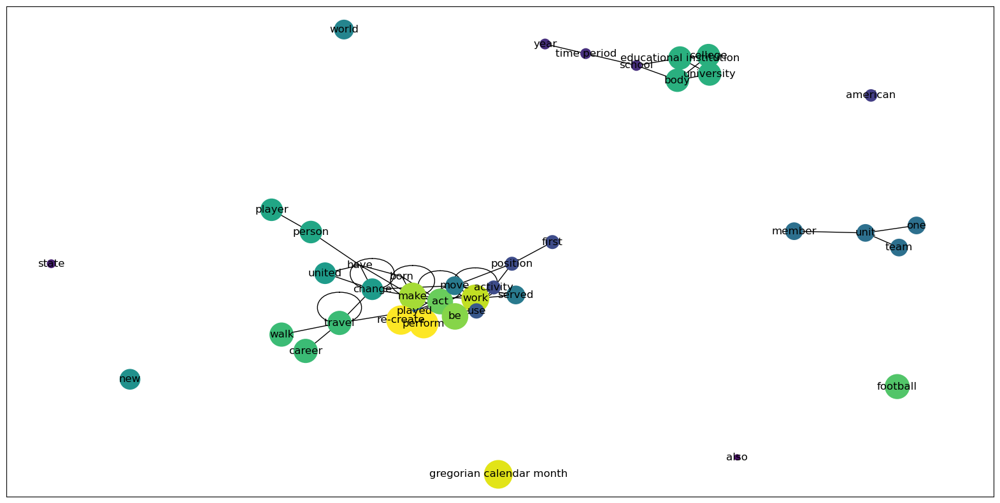

In [41]:
import networkx as nx
import community.community_louvain as cl
import matplotlib.pyplot as plt

# create the graph and labels
def create_wordnet_graph(top_words, top_hypernyms):
    graph = nx.Graph()
    for word in top_words:
        graph.add_node(word)
    for hypernym in top_hypernyms:
        graph.add_node(hypernym)
    for word in top_words:
        hypernyms = get_hypernyms_for_word(word)
        for hypernym in hypernyms:
            if hypernym in top_hypernyms:
                graph.add_edge(word, hypernym)
    return graph

def draw_node_graph(graph, labels):
    partition = cl.best_partition(graph, resolution=5.0)
    pos = nx.spring_layout(graph, k=0.2)
    node_size = [partition[n]*50 for n in graph]
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    node_color = [cmap(partition[node]) for node in graph.nodes()]
    fig, ax = plt.subplots(figsize=(20, 10))
    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                     cmap=cmap, node_color=node_color)
    plt.show()

# Assign hierarchical cluster labels to data points
result['hierarchical_labels'] = flat_clusters

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()

# Define the cluster to display
selected_cluster = 12

if selected_cluster in hierarchical_labels:
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create node graph
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)

    # Draw the graph
    draw_node_graph(graph, {node: node for node in graph.nodes()})
else:
    print("Invalid cluster label. Please try again.")


In [42]:
val_hier_df

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens
0,Li Curt is a station on the Bernina Railway li...,Place,Station,RailwayStation,1.726188,-0.914973,4,6,"[0.007814435288310051, 0.010714929550886154, 0...","[li, curt, station, bernina, railway, line, ho..."
1,Grafton State Hospital was a psychiatric hospi...,Place,Building,Hospital,4.546166,-1.843933,4,4,"[0.007814435288310051, 0.010714929550886154, 0...","[grafton, state, hospital, psychiatric, hospit..."
2,The Democratic Patriotic Alliance of Kurdistan...,Agent,Organisation,PoliticalParty,-1.640161,-0.999509,6,15,"[0.007814435288310051, 0.010714929550886154, 0...","[democratic, patriotic, alliance, kurdistan, d..."
3,"Ira Rakatansky (October 3, 1919 – March 4, 201...",Agent,Person,Architect,-2.612972,0.127929,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[ira, rakatansky, october, march, modernist, a..."
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298840,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[universitatea, reșița, woman, handball, club,..."
...,...,...,...,...,...,...,...,...,...,...
35998,The Great Pershing Balloon Derby is a hot air ...,Event,SocietalEvent,Convention,0.533597,-2.074033,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[great, pershing, balloon, derby, hot, air, ba..."
35999,Microsystems was a personal computing magazine...,Work,PeriodicalLiterature,Magazine,-0.590401,1.340483,7,16,"[0.007814435288310051, 0.010714929550886154, 0...","[microsystems, personal, computing, magazine, ..."
36000,The 1899 Open Championship was the 39th Open C...,Event,Tournament,GolfTournament,0.620415,-2.774530,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[open, championship, th, open, championship, h..."
36001,Kristina Repelewska (born 7 January 1981) is a...,Agent,Athlete,HandballPlayer,-3.297610,-0.588829,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[kristina, repelewska, born, january, polish, ..."


In [195]:
topic_names = {1: 'Species', 2: 'Species-Plants', 3: 'Species - Animals (Horses)', 4: 'Natural places and structures', 5: 'Railway and Public Transit System', 6: 'Railways and Museums', 7: 'Legal cases and Law', 8: 'Celestial body and Astronomy', 9: 'Natural Places', 10: 'Sport player', 11: 'Sport player', 12: 'Person', 13: 'Music Genre', 14: 'Educational institutions and companies', 
               15: 'Sport organizations', 16: 'Music', 17: 'Games and Music', 18: 'Periodical Publications and Musical works', 19: 'Sport Season', 20: 'Contests, sport events and Elections', 21: 'Contest and Sport events'}
val_hier_df['topic_names'] = val_hier_df['hierarchical_labels'].map(topic_names)


In [196]:
val_hier_df[val_hier_df.labels == 6].hierarchical_labels.value_counts()
#Person(12), Sport player(11), Sport player(10),Sport organizations(15), Educational institutions and companies(14)

12    5816
11    4066
10    3351
15    3308
14    1609
5      233
16      30
Name: hierarchical_labels, dtype: int64

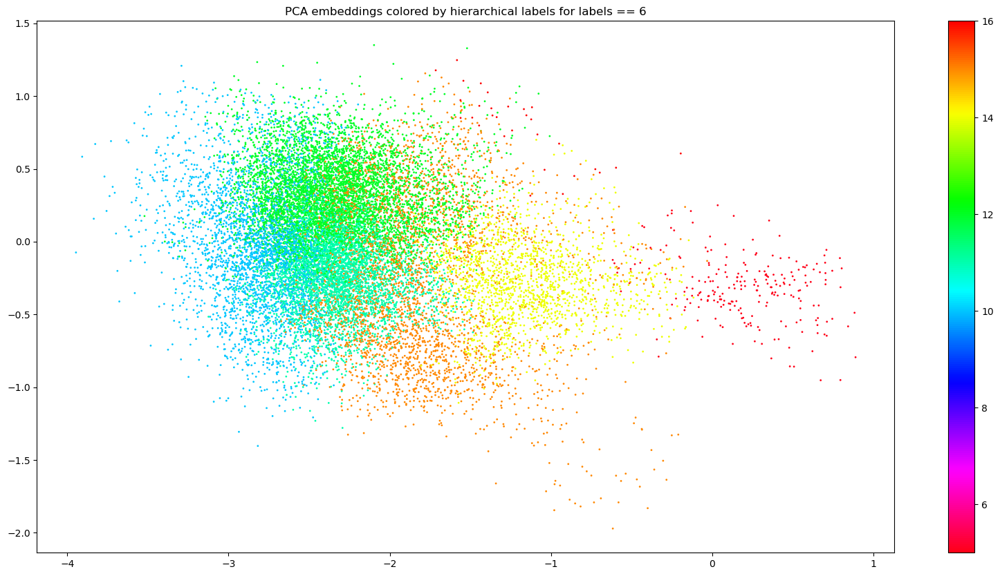

In [197]:
import matplotlib.pyplot as plt

# Filter the val_hier_df dataframe to include only the rows where labels 6 (Agent)
df_labels_6 = val_hier_df[val_hier_df['labels'] == 6]

plt.figure(figsize=(20, 10))
plt.scatter(df_labels_6['x'], df_labels_6['y'], c=df_labels_6['hierarchical_labels'], cmap='hsv_r', s=1)
plt.title('PCA embeddings colored by hierarchical labels for labels == 6')
plt.colorbar()
plt.show()



In [198]:
df_labels_6.head()

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
2,The Democratic Patriotic Alliance of Kurdistan...,Agent,Organisation,PoliticalParty,-1.640161,-0.999517,6,15,"[0.007814435288310051, 0.010714929550886154, 0...","[democratic, patriotic, alliance, kurdistan, d...",Sport organizations
3,"Ira Rakatansky (October 3, 1919 – March 4, 201...",Agent,Person,Architect,-2.612971,0.127930,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[ira, rakatansky, october, march, modernist, a...",Person
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298839,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[universitatea, reșița, woman, handball, club,...",Sport player
5,The Special Broadcasting Service (SBS) is a hy...,Agent,Broadcaster,BroadcastNetwork,-1.593310,-0.945044,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[special, broadcasting, service, sb, hybridfun...",Educational institutions and companies
8,"Bryan Leyva (born February 8, 1992 in Chihuahu...",Agent,Athlete,SoccerPlayer,-2.170459,-0.098744,6,15,"[0.007814435288310051, 0.010714929550886154, 0...","[bryan, leyva, born, february, chihuahua, chih...",Sport organizations


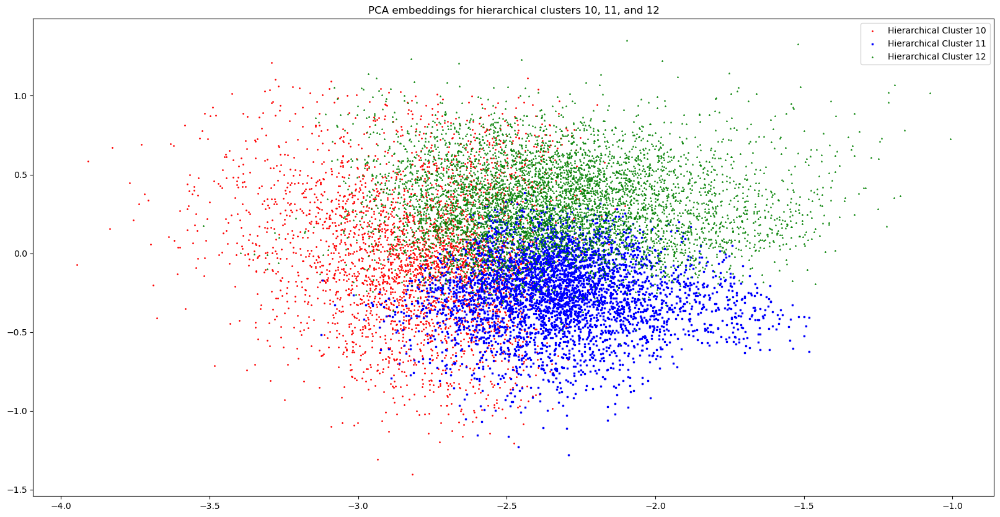

In [199]:
# Filter the val_hier_df dataframe to include only the rows where labels 6 (Agent) and hierarchical labels 10, 11, or 12
df_labels_6_10 = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)]
df_labels_6_11 = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 11)]
df_labels_6_12 = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 12)]

# Plot the embeddings for each hierarchical cluster separately using different markers
plt.figure(figsize=(20, 10))
plt.scatter(df_labels_6_10['x'], df_labels_6_10['y'], c='red', marker='o', s=1)
plt.scatter(df_labels_6_11['x'], df_labels_6_11['y'], c='blue', marker='s', s=1)
plt.scatter(df_labels_6_12['x'], df_labels_6_12['y'], c='green', marker='^', s=1)
plt.title('PCA embeddings for hierarchical clusters 10, 11, and 12')
plt.legend(['Hierarchical Cluster 10', 'Hierarchical Cluster 11', 'Hierarchical Cluster 12'])
plt.show()


### Subcluster similarity scores within the cluster and between the clusters

In [200]:
# Agent Subcluster similarity scores

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
#AGENT: 12,11,15,10,14
# Extract the x and y values for each cluster
cluster_10_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)][['x', 'y']].values
cluster_11_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 11)][['x', 'y']].values
cluster_12_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 12)][['x', 'y']].values
cluster_14_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)][['x', 'y']].values
cluster_15_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 15)][['x', 'y']].values
# Compute the pairwise cosine similarity between the data points within each cluster
cluster_10_similarity = cosine_similarity(cluster_10_data)
cluster_11_similarity = cosine_similarity(cluster_11_data)
cluster_12_similarity = cosine_similarity(cluster_12_data)
cluster_14_similarity = cosine_similarity(cluster_14_data)
cluster_15_similarity = cosine_similarity(cluster_15_data)
# Compute the

cluster_10_11_similarity = cosine_similarity(cluster_10_data, cluster_11_data)
cluster_10_12_similarity = cosine_similarity(cluster_10_data, cluster_12_data)
cluster_10_14_similarity = cosine_similarity(cluster_10_data, cluster_14_data)
cluster_10_15_similarity = cosine_similarity(cluster_10_data, cluster_15_data)

cluster_11_12_similarity = cosine_similarity(cluster_11_data, cluster_12_data)
cluster_11_14_similarity = cosine_similarity(cluster_11_data, cluster_14_data)
cluster_11_15_similarity = cosine_similarity(cluster_11_data, cluster_15_data)

cluster_12_14_similarity = cosine_similarity(cluster_12_data, cluster_14_data)
cluster_12_15_similarity = cosine_similarity(cluster_12_data, cluster_15_data)
cluster_14_15_similarity = cosine_similarity(cluster_14_data, cluster_15_data)


# Print the average pairwise similarity within each cluster
print("Cluster 10 similarity:", np.mean(cluster_10_similarity))
print("Cluster 11 similarity:", np.mean(cluster_11_similarity))
print("Cluster 12 similarity:", np.mean(cluster_12_similarity))
print("Cluster 14 similarity:", np.mean(cluster_14_similarity))
print("Cluster 15 similarity:", np.mean(cluster_15_similarity))

# Print the average pairwise similarity across the different clusters
print("Cluster 10-11 similarity:", np.mean(cluster_10_11_similarity))
print("Cluster 10-12 similarity:", np.mean(cluster_10_12_similarity))
print("Cluster 10-14 similarity:", np.mean(cluster_10_14_similarity))
print("Cluster 10-15 similarity:", np.mean(cluster_10_15_similarity))
print("Cluster 11-12 similarity:", np.mean(cluster_11_12_similarity))
print("Cluster 11-14 similarity:", np.mean(cluster_11_14_similarity))
print("Cluster 11-15 similarity:", np.mean(cluster_11_15_similarity))
print("Cluster 12-14 similarity:", np.mean(cluster_12_14_similarity))
print("Cluster 12-15 similarity:", np.mean(cluster_12_15_similarity))
print("Cluster 14-15 similarity:", np.mean(cluster_14_15_similarity))

Cluster 10 similarity: 0.9771872
Cluster 11 similarity: 0.98921174
Cluster 12 similarity: 0.98747367
Cluster 14 similarity: 0.93810725
Cluster 15 similarity: 0.9047561
Cluster 10-11 similarity: 0.9779853
Cluster 10-12 similarity: 0.9721816
Cluster 10-14 similarity: 0.9290903
Cluster 10-15 similarity: 0.931915
Cluster 11-12 similarity: 0.9584367
Cluster 11-14 similarity: 0.9537417
Cluster 11-15 similarity: 0.9455986
Cluster 12-14 similarity: 0.8910179
Cluster 12-15 similarity: 0.9091226
Cluster 14-15 similarity: 0.91565704


In [201]:
# Set the threshold similarity score
threshold = 0.7

# Filter the similarity matrices to include only the pairs of texts with a similarity score below the threshold
cluster_10_similarities_far = cluster_10_similarity[cluster_10_similarity < threshold]
cluster_11_similarities_far = cluster_11_similarity[cluster_11_similarity < threshold]
cluster_12_similarities_far = cluster_12_similarity[cluster_12_similarity < threshold]
cluster_14_similarities_far = cluster_14_similarity[cluster_14_similarity < threshold]
cluster_15_similarities_far = cluster_15_similarity[cluster_15_similarity < threshold]

# Print the number of text pairs below the threshold for each cluster
print("Number of text pairs below threshold in Cluster 10:", len(cluster_10_similarities_far))
print("Number of text pairs below threshold in Cluster 11:", len(cluster_11_similarities_far))
print("Number of text pairs below threshold in Cluster 12:", len(cluster_12_similarities_far))
print("Number of text pairs below threshold in Cluster 14:", len(cluster_14_similarities_far))
print("Number of text pairs below threshold in Cluster 15:", len(cluster_15_similarities_far))


Number of text pairs below threshold in Cluster 10: 206
Number of text pairs below threshold in Cluster 11: 0
Number of text pairs below threshold in Cluster 12: 1144
Number of text pairs below threshold in Cluster 14: 87554
Number of text pairs below threshold in Cluster 15: 778114


In [1]:
# Get the indices of text pairs below threshold for cluster 10
cluster_10_indices_far = np.argwhere(cluster_10_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_10_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].iloc[cluster_10_indices_far.flatten()]

# Get the indices of text pairs below threshold for cluster 12
cluster_12_indices_far = np.argwhere(cluster_12_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_12_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 12)].iloc[cluster_12_indices_far.flatten()]

# Get the indices of text pairs below threshold for cluster 14
cluster_14_indices_far = np.argwhere(cluster_14_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_14_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].iloc[cluster_14_indices_far.flatten()]

# Get the indices of text pairs below threshold for cluster 15
cluster_15_indices_far = np.argwhere(cluster_15_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_15_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 15)].iloc[cluster_15_indices_far.flatten()]

# Print the text pairs below threshold for cluster 10
print("Text pairs below threshold in Cluster 10:\n", cluster_10_pairs_far[['text']])

# Print the text pairs below threshold for cluster 12
print("Text pairs below threshold in Cluster 12:\n", cluster_12_pairs_far[['text']])


NameError: name 'np' is not defined

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/875073001.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/875073001.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_10_pairs_far.x, cluster_10_pairs_far.y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/875073001.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/875073001.py:9: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_14_pairs_far.x, cluster_14_

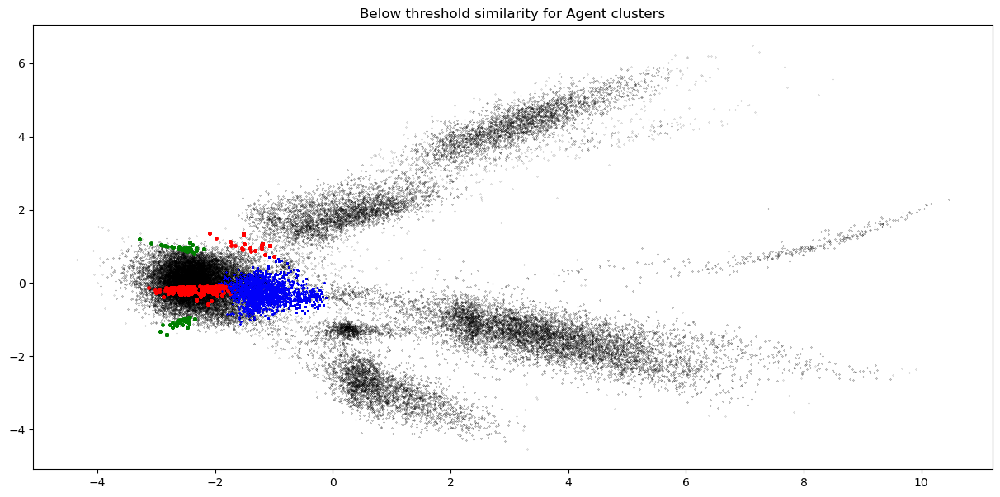

In [203]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_10_pairs_far.x, cluster_10_pairs_far.y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=5, cmap='hsv_r')
plt.scatter(cluster_14_pairs_far.x, cluster_14_pairs_far.y, color='blue', s=0.01, cmap='hsv_r')
#plt.scatter(cluster_15_pairs_far.x, cluster_15_pairs_far.y, color='yellow', s=1, cmap='hsv_r')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1546225974.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1546225974.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_10_pairs_far.x, cluster_10_pairs_far.y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1546225974.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=5, cmap='hsv_r')


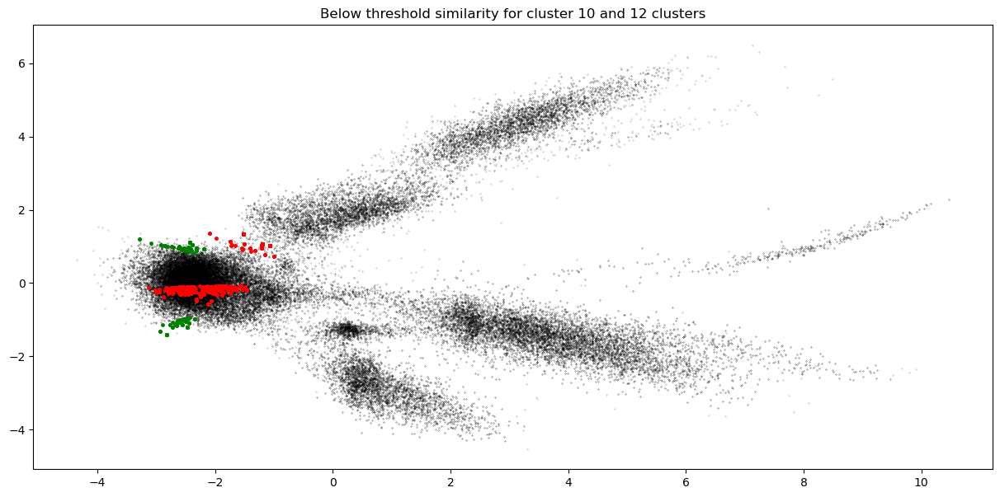

In [204]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_10_pairs_far.x, cluster_10_pairs_far.y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=5, cmap='hsv_r')

plt.title('Below threshold similarity for cluster 10 and 12 clusters')
#plt.colorbar()
            
plt.show()

### Cluster 10 Subclusters

##### Comparison of index 425 and 423,739,1041,2420,3141 - Real data index (4708;) groups of pairs which have less than threshold similarity score

In [205]:
cluster_10_pairs_far[cluster_10_pairs_far.index == 4708].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
4708,Joakim Hykkerud (born 10 February 1986) is a N...,Agent,Athlete,HandballPlayer,-2.935634,-1.306676,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[joakim, hykkerud, born, february, norwegian, ...",Sport player


In [206]:
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_10_pairs_far_new_index = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].reset_index(drop=True).iloc[cluster_10_indices_far.flatten()]


In [207]:
cluster_10_pairs_far_new_index[cluster_10_pairs_far_new_index.index == 425].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
425,Joakim Hykkerud (born 10 February 1986) is a N...,Agent,Athlete,HandballPlayer,-2.935634,-1.306676,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[joakim, hykkerud, born, february, norwegian, ...",Sport player


In [208]:
index_numbers = [425, 423, 739, 1041, 2420, 3141]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens']
text_pairs_4708 = cluster_10_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]

In [209]:
import ast

# convert lists to tuples
for column in text_pairs_4708.columns:
    if isinstance(text_pairs_4708[column].iloc[0], list):
        text_pairs_4708[column] = text_pairs_4708[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_4708.drop_duplicates(inplace=True)


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/383403482.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


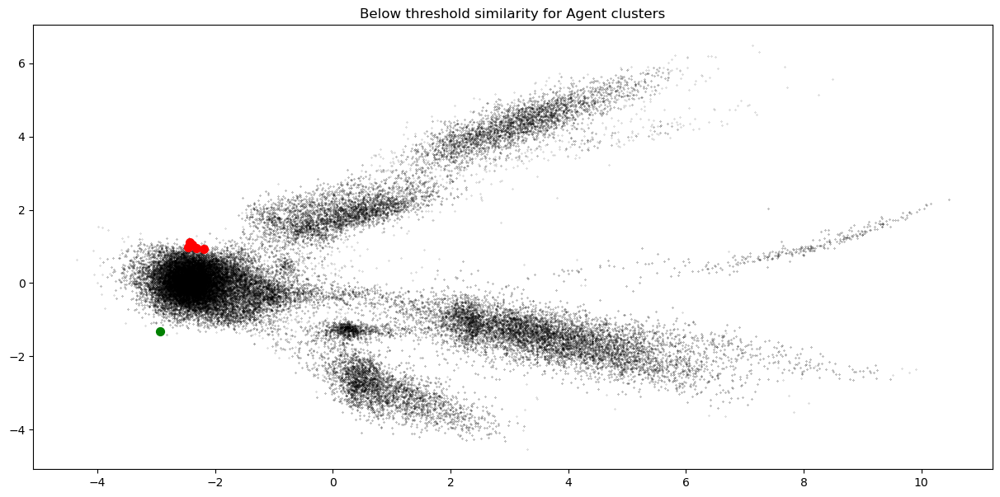

In [210]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 425
red_indices = [423, 739, 1041, 2420, 3141]
green_observation = text_pairs_4708.loc[green_index]
red_observations = text_pairs_4708.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=50, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=50, marker='o')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()


In [211]:
# import nltk
# from collections import Counter
# from nltk.corpus import wordnet as wn

# # Function to extract most frequent words from a list of word tokens
# def get_most_frequent_words(word_tokens, n=10):
#     all_words = [word for sublist in word_tokens for word in sublist]
#     word_counts = Counter(all_words)
#     top_words = [word for word, count in word_counts.most_common(n)]
#     return top_words

# # Function to extract most frequent hypernyms from a list of word tokens
# def get_most_frequent_hypernyms(word_tokens, n=10):
#     hypernym_counts = Counter()
#     for word in [word for sublist in word_tokens for word in sublist]:
#         synsets = wn.synsets(word)
#         for synset in synsets:
#             hypernyms = synset.hypernyms()
#             for hypernym in hypernyms:
#                 hypernym_name = hypernym.name().split('.')[0]
#                 if '_' in hypernym_name:
#                     hypernym_name = ' '.join(hypernym_name.split('_'))
#                 hypernym_counts[hypernym_name] += 1
#     top_hypernyms = [hypernym for hypernym, count in hypernym_counts.most_common(n)]
#     return top_hypernyms

# # Function to extract hypernyms for a given word
# def get_hypernyms_for_word(word, n=10):
#     hypernyms = []
#     synsets = wn.synsets(word)
#     for synset in synsets:
#         for hypernym in synset.hypernyms():
#             hypernym_name = hypernym.name().split('.')[0]
#             if '_' in hypernym_name:
#                 hypernym_name = ' '.join(hypernym_name.split('_'))
#             hypernyms.append(hypernym_name)
#     top_hypernyms = list(set(hypernyms))[:n]
#     return top_hypernyms


# # Get top words, top word hypernyms, and top hypernyms for specific observations
# for index in [423, 425, 739, 1041, 2420, 3141]:
#     # Get word tokens for current observation
#     word_tokens = text_pairs_4708.loc[index, 'word_tokens']

#     # Extract most frequent words and hypernyms
#     top_words = get_most_frequent_words([word_tokens])
#     top_hypernyms = get_most_frequent_hypernyms([word_tokens])
#     top_word_hypernyms = {}
#     for word in top_words:
#         top_word_hypernyms[word] = get_hypernyms_for_word(word)

#     # Print observation index and corresponding topic names
#     print(f'Observation {index}:')
#     print(f'Top words: {top_words}')
#     print(f'Top word hypernyms: {top_word_hypernyms}')
#     print(f'Top hypernyms: {top_hypernyms}')


In [212]:
for i, row in text_pairs_4708.iterrows():
    print(f"Text {i}: {row['text']} \n L2: {row['l2']}    L3: {row['l3']}\n")

Text 425: Joakim Hykkerud (born 10 February 1986) is a Norwegian handball player. He plays for TSV Hannover-Burgdorf and the Norwegian national team. He competed at the 2016 European Men's Handball Championship. 
 L2: Athlete    L3: HandballPlayer

Text 423: Johnson College Prep is a public four-year charter high school located in the Englewood neighborhood on the south side of Chicago, Illinois, United States. It is a part of the Noble Network of Charter Schools. The school is named for African-American businessman and founder of the Chicago-based Johnson Publishing Company John H. Johnson and his wife Eunice Johnson. 
 L2: EducationalInstitution    L3: School

Text 739: Maki Minami (南 マキ Minami Maki) is a Japanese manga author best known for the high school series Special A. 
 L2: Artist    L3: ComicsCreator

Text 1041: The Daniel J. Evans School of Public Policy and Governance (the Evans School) at the University of Washington in Seattle is a school of public policy and management i

##### Another groups of pairs which have less than threshold similarity score ( 2174 ; 50,163,353,423,477,622,717,739,1041,1107,1126,1422,1476,1508,1735,1773,2083,2420,2727,3141)

In [213]:
cluster_10_pairs_far[cluster_10_pairs_far.index == 23761].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
23761,Nina Wörz (born 14 November 1980 in Bremen) is...,Agent,Athlete,HandballPlayer,-2.475461,-1.207429,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[nina, wörz, born, november, bremen, german, h...",Sport player


In [214]:
cluster_10_pairs_far_new_index[cluster_10_pairs_far_new_index.index == 2174].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
2174,Nina Wörz (born 14 November 1980 in Bremen) is...,Agent,Athlete,HandballPlayer,-2.475461,-1.207429,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[nina, wörz, born, november, bremen, german, h...",Sport player


In [215]:
index_numbers = [2174,50,163,353,423,477,622,717,739,1041,1107,1126,1422,1476,1508,1735,1773,2083,2420,2727,3141]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens']
text_pairs_23761 = cluster_10_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]

In [216]:
import ast

# convert lists to tuples
for column in text_pairs_23761.columns:
    if isinstance(text_pairs_23761[column].iloc[0], list):
        text_pairs_23761[column] = text_pairs_23761[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_23761.drop_duplicates(inplace=True)


In [217]:
text_pairs_23761

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens
2174,Nina Wörz (born 14 November 1980 in Bremen) is...,Agent,Athlete,HandballPlayer,-2.475461,-1.207429,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(nina, wörz, born, november, bremen, german, h..."
50,The Rollins School of Public Health (RSPH) is ...,Agent,EducationalInstitution,University,-2.324696,0.889388,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(rollins, school, public, health, rsph, public..."
163,Michael H. Riordan (born 1951) is an American ...,Agent,Person,Economist,-2.858218,1.023762,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(michael, h, riordan, born, american, economic..."
353,Nicolaas Wilhelmus Posthumus or N.W. Posthumus...,Agent,Person,Economist,-2.403582,0.873162,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(nicolaas, wilhelmus, posthumus, nw, posthumus..."
423,Johnson College Prep is a public four-year cha...,Agent,EducationalInstitution,School,-2.394065,1.040892,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(johnson, college, prep, public, fouryear, cha..."
477,Wharton School Publishing (known colloquially ...,Agent,Company,Publisher,-2.716278,0.978279,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(wharton, school, publishing, known, colloquia..."
622,The California Academy of Mathematics and Scie...,Agent,EducationalInstitution,School,-2.529964,0.956276,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(california, academy, mathematics, science, ca..."
717,DNA Songs is a songwriting and production comp...,Agent,Group,Band,-2.574085,0.920051,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(dna, song, songwriting, production, company, ..."
739,Maki Minami (南 マキ Minami Maki) is a Japanese m...,Agent,Artist,ComicsCreator,-2.323191,0.965486,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(maki, minami, 南, マキ, minami, maki, japanese, ..."
1041,The Daniel J. Evans School of Public Policy an...,Agent,EducationalInstitution,School,-2.430646,1.111916,6,10,"(0.007814435288310051, 0.010714929550886154, 0...","(daniel, j, evans, school, public, policy, gov..."


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3633876023.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


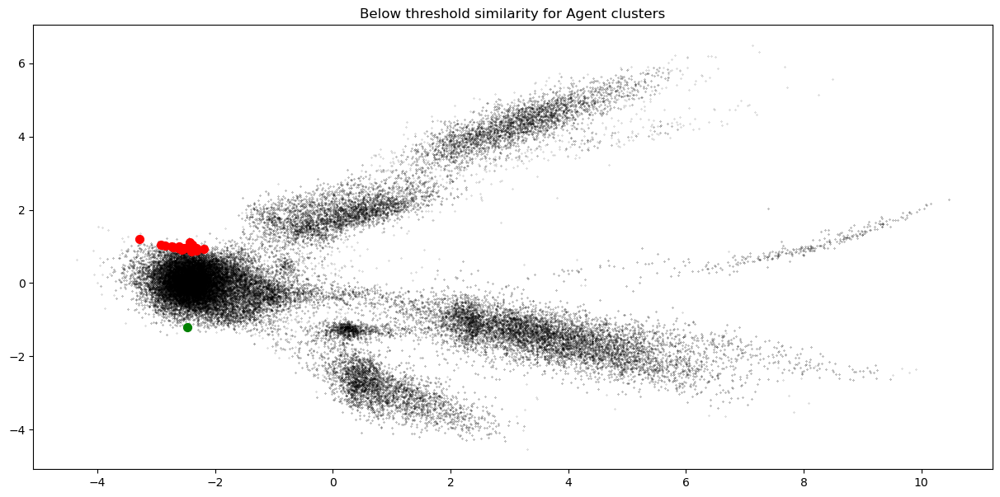

In [218]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 2174
red_indices = [50,163,353,423,477,622,717,739,1041,1107,1126,1422,1476,1508,1735,1773,2083,2420,2727,3141]
green_observation = text_pairs_23761.loc[green_index]
red_observations = text_pairs_23761.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=50, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=50, marker='o')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()


In [219]:
for i, row in text_pairs_23761.iterrows():
    print(f"Text {i}: {row['text']} \n L2: {row['l2']}    L3: {row['l3']}\n")

Text 2174: Nina Wörz (born 14 November 1980 in Bremen) is a German handball player. She plays for the German club Siófok KC and for the German national team, having made her international debut on 19 February 1999 against Poland. Wörz was member of the German national team that won the World Championship bronze medal in 2007 and also participated at the 2008 Summer Olympic Games in Beijing, where Germany placed eleventh. She was also present at the 2008 European Women's Handball Championship and the 2009 World Women's Handball Championship in China. In 2010 she took part on the European Championship, where Germany achieved the thirteenth position. 
 L2: Athlete    L3: HandballPlayer

Text 50: The Rollins School of Public Health (RSPH) is the public health school of Emory University. Founded in 1990, RSPH has more than 850 students pursuing master's degrees (MPH/MSPH) and over 100 students pursuing doctorate degrees (PhD). The school comprises six departments: Behavioral Sciences/Health

### Cluster 10 Educational Institutions similarities with Cluster 14 (Educational Institution)

##### For cluster 10 values which belong to Educational Institutes and Companies similarities with Cluster 14(Educational institutions and companies

In [220]:
val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].head()

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298839,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[universitatea, reșița, woman, handball, club,...",Sport player
13,Deng Yalan (Chinese: 邓娅兰; pinyin: Dèng Yǎlán; ...,Agent,Athlete,Gymnast,-2.759670,-0.120173,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[deng, yalan, chinese, 邓娅兰, pinyin, dèng, yǎlá...",Sport player
25,BSC Raiffeisen Panthers Fürstenfeld is an Aust...,Agent,SportsTeam,BasketballTeam,-2.458818,-0.084844,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[bsc, raiffeisen, panther, fürstenfeld, austri...",Sport player
34,The Qatari Basketball League is the top-tier b...,Agent,SportsLeague,BasketballLeague,-2.547230,-0.846615,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[qatari, basketball, league, toptier, basketba...",Sport player
35,Ruaridh McConnochie (born 16 August 1989) is a...,Agent,Athlete,RugbyPlayer,-2.529696,0.090302,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[ruaridh, mcconnochie, born, august, men, rugb...",Sport player


In [221]:
val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].head()

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
5,The Special Broadcasting Service (SBS) is a hy...,Agent,Broadcaster,BroadcastNetwork,-1.593310,-0.945044,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[special, broadcasting, service, sb, hybridfun...",Educational institutions and companies
53,The Toronto St. Michael's Majors were a major ...,Agent,SportsTeam,HockeyTeam,-0.942985,-0.481335,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[toronto, st, michael, major, major, junior, i...",Educational institutions and companies
55,"STS Sanok is an ice hockey team in Sanok, Pola...",Agent,SportsTeam,HockeyTeam,-1.042256,-0.521762,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[sts, sanok, ice, hockey, team, sanok, poland,...",Educational institutions and companies
64,WeLab is a financial technology (fintech) comp...,Agent,Company,Bank,-1.398655,-0.813123,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[welab, financial, technology, fintech, compan...",Educational institutions and companies
131,The 6th Mechanized Infantry Regiment “Saboya” ...,Agent,Organisation,MilitaryUnit,-1.494127,-0.232388,6,14,"[0.007814435288310051, 0.010714929550886154, 0...","[th, mechanized, infantry, regiment, “, saboya...",Educational institutions and companies


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/831792732.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/831792732.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].y, color='green', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/831792732.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_label

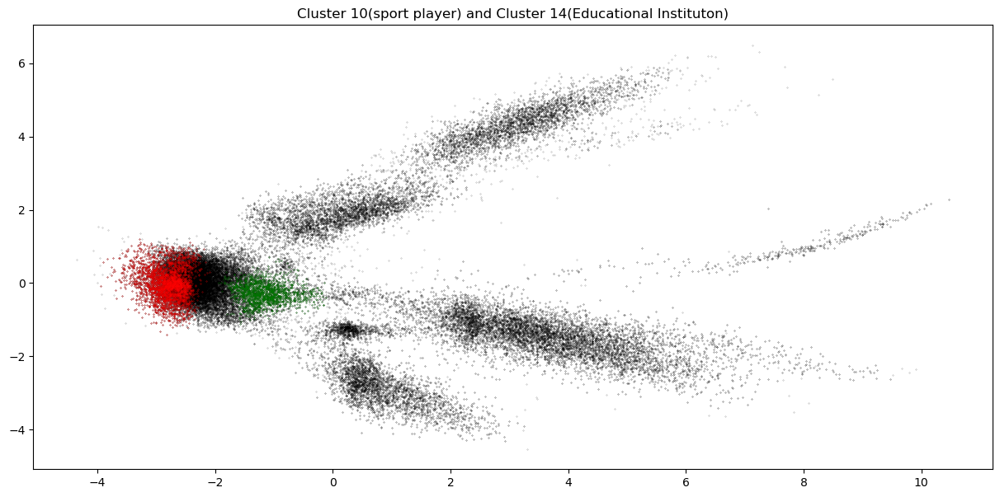

In [222]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].y, color='green', s=0.05, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10)].y, color='red', s=0.05, cmap='hsv_r')

plt.title('Cluster 10(sport player) and Cluster 14(Educational Instituton)')
#plt.colorbar()
            
plt.show()

##### Company, EducationalInstitutions and Organizations pairwise comparisons for cluster 10 and all cluster 14

In [223]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Extract the x and y values for each cluster
cluster_10_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10) & ((val_hier_df['l2'] == "Company") | (val_hier_df['l2'] == "EducationalInstitution") | (val_hier_df['l2'] == "Organisation"))][['x', 'y']].values
cluster_14_data = val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)][['x', 'y']].values

# Compute the pairwise cosine similarity between the data points within each cluster
cluster_10_similarity = cosine_similarity(cluster_10_data)
cluster_14_similarity = cosine_similarity(cluster_14_data)

# Compute the pairwise cosine similarity between the data points across the different clusters
cluster_10_14_similarity = cosine_similarity(cluster_10_data, cluster_14_data)

# Print the average pairwise similarity within each cluster
print("Cluster 10 similarity:", np.mean(cluster_10_similarity))
print("Cluster 14 similarity:", np.mean(cluster_14_similarity))

# Print the average pairwise similarity across the different clusters
print("Cluster 10-14 similarity:", np.mean(cluster_10_14_similarity))

Cluster 10 similarity: 0.97711354
Cluster 14 similarity: 0.93810725
Cluster 10-14 similarity: 0.87890786


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3427582241.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3427582241.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10) & ((val_hier_df['l2'] == "EducationalInstitution"))].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10) & ((val_hier_df['l2'] == "EducationalInstitution"))].y, color='red', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3427582241.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierar

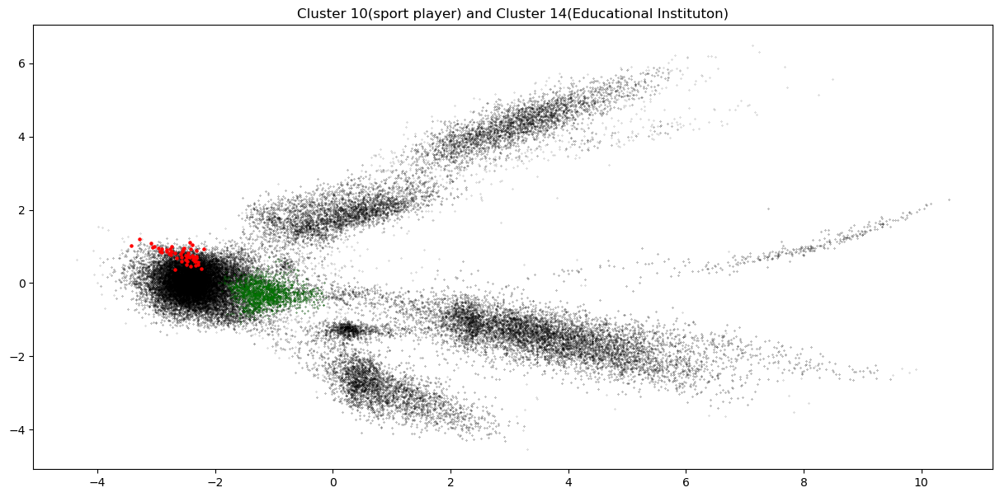

In [224]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10) & ((val_hier_df['l2'] == "EducationalInstitution"))].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 10) & ((val_hier_df['l2'] == "EducationalInstitution"))].y, color='red', s=5, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].x, val_hier_df[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 14)].y, color='green', s=0.05, cmap='hsv_r')

plt.title('Cluster 10(sport player) and Cluster 14(Educational Instituton)')
#plt.colorbar()
            
plt.show()

### Cluster 12 subclusters

In [225]:
cluster_12_pairs_far[cluster_12_pairs_far.x < -3 ]

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
28548,"Reef Karim, known as Dr. Reef, is a double boa...",Agent,Presenter,RadioHost,-3.128734,-0.130472,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[reef, karim, known, dr, reef, double, board, ...",Person
35589,"Tregaye Fraser (born September 6, 1984) is an ...",Agent,Person,Chef,-3.016643,-0.184254,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[tregaye, fraser, born, september, american, c...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
28548,"Reef Karim, known as Dr. Reef, is a double boa...",Agent,Presenter,RadioHost,-3.128734,-0.130472,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[reef, karim, known, dr, reef, double, board, ...",Person
35589,"Tregaye Fraser (born September 6, 1984) is an ...",Agent,Person,Chef,-3.016643,-0.184254,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[tregaye, fraser, born, september, american, c...",Person


In [226]:
cluster_12_pairs_far[cluster_12_pairs_far.index == 15134]

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
15134,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person


#### index 15134 (new index 2408) 

In [227]:
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_12_pairs_far_new_index = val_hier_df.loc[(val_hier_df['labels'] == 6) & (val_hier_df['hierarchical_labels'] == 12)].reset_index(drop=True).iloc[cluster_12_indices_far.flatten()]


In [228]:
cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.index == 2408]

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person
2408,"Heba El Torky (born January 15, 1991 in Alexan...",Agent,Athlete,SquashPlayer,-3.008841,-0.261657,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[heba, el, torky, born, january, alexandria, e...",Person


In [229]:
cluster_12_indices_far[cluster_12_indices_far[:,0] == 2408]

array([[2408, 1397],
       [2408, 4131],
       [2408, 4529]])

In [230]:
index_numbers = [2408, 1397, 4131, 4529]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens']
text_pairs_2408 = cluster_12_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]


In [231]:
import ast

# convert lists to tuples
for column in text_pairs_2408.columns:
    if isinstance(text_pairs_2408[column].iloc[0], list):
        text_pairs_2408[column] = text_pairs_2408[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_2408.drop_duplicates(inplace=True)


In [232]:
for i, row in text_pairs_2408.iterrows():
    print(f"Text {i}: {row['text']} \n L2: {row['l2']}    L3: {row['l3']}\n")

Text 2408: Heba El Torky (born January 15, 1991 in Alexandria) is an Egyptian professional squash player. 
 L2: Athlete    L3: SquashPlayer

Text 1397: Glen Miller Campbell (September 23, 1916 – February 1, 2005) was a Canadian curler. He played as second on a team consisting of 3 of his brothers, winning the 1955 Brier. 
 L2: WinterSportPlayer    L3: Curler

Text 4131: Walter Earl (1890–1950) was a British Thoroughbred racehorse trainer. After a riding career of limited importance he became a private trainer, first for Solomon Joel and later for Lord Derby. He was one of the most successful trainers of the 1940s, sending out the winners of six classics and winning the title of Champion Trainer in 1945. His best horse was Alycidon who won the Ascot Gold Cup in 1949. 
 L2: Person    L3: HorseTrainer

Text 4529: Hugh Brown (born c. 1850) was a Scottish professional golfer who played during the late 19th century. He finished seventh in the 1872 Open Championship. 
 L2: Athlete    L3: Golf

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2647148102.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


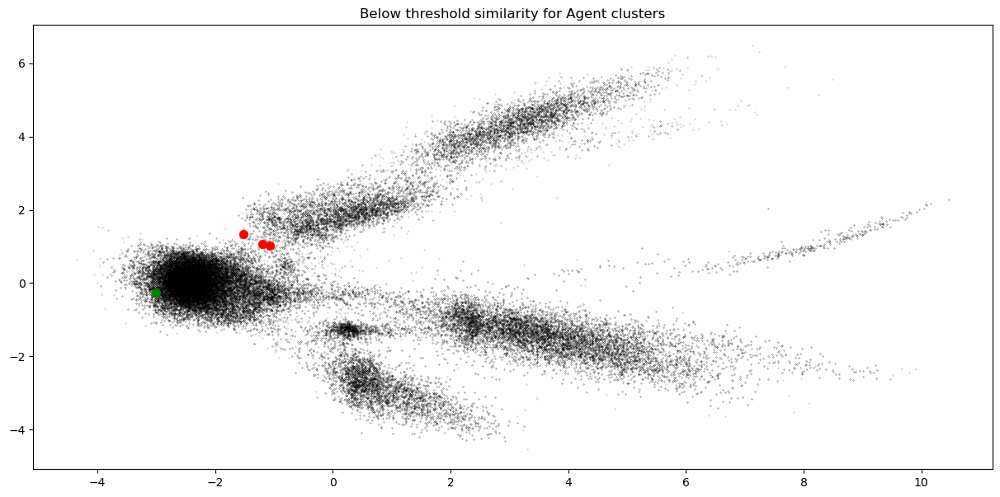

In [233]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 2408
red_indices = [1397, 4131, 4529]
green_observation = text_pairs_2408.loc[green_index]
red_observations = text_pairs_2408.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=50, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=50, marker='o')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()


In [234]:
cluster_12_pairs_far[cluster_12_pairs_far.x > -1.5].index.value_counts()

8696     504
28096    258
7473     108
3487      28
24726     10
5327       8
1225       6
27582      6
35392      6
34117      4
21723      2
dtype: int64

##### Second example for index 24726 (3958 new index)

In [235]:
cluster_12_pairs_far[cluster_12_pairs_far.index == 24726].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
24726,Dong Huling or Dong Hu Ling (董虎岭) (1918 – 29 N...,Agent,Athlete,MartialArtist,-1.462364,-0.195479,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[dong, huling, dong, hu, ling, 董虎岭, november, ...",Person


In [236]:
cluster_12_indices_far[cluster_12_indices_far[:,0] == 3958]

array([[3958,  539],
       [3958, 1219],
       [3958, 1397],
       [3958, 4131],
       [3958, 4529]])

In [237]:
index_numbers = [3958, 539, 1219, 1397, 4131, 4529]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens']
text_pairs_24726 = cluster_12_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]


In [238]:
import ast

# convert lists to tuples
for column in text_pairs_24726.columns:
    if isinstance(text_pairs_24726[column].iloc[0], list):
        text_pairs_24726[column] = text_pairs_24726[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_24726.drop_duplicates(inplace=True)


In [239]:
for i, row in text_pairs_24726.iterrows():
    print(f"Text {i}: {row['text']} \n L2: {row['l2']}    L3: {row['l3']}\n")

Text 3958: Dong Huling or Dong Hu Ling (董虎岭) (1918 – 29 November 1992) was a teacher of Dong-style t'ai chi ch'uan (taijiquan) and Yang-style t'ai chi ch'uan. He taught in Hong Kong, Singapore, Malaysia, Thailand, and the US. Born in Hebei, China, he moved to Hong Kong with his father Tung Ying-chieh in 1947. He emigrated to the United States in 1966 and taught Dong-style t'ai chi ch'uan in Hawaii and California. Dong Huling is followed by Tung Kai Ying and Dong Zeng Chen. The members of the Tung family teach t'ai chi ch'uan in Asia, Hawaii, North America and Europe. 
 L2: Athlete    L3: MartialArtist

Text 539: Lazaro Sosa Barrera (May 8, 1924 – April 25, 1991) was a Cuban-born American Hall of Fame thoroughbred racehorse trainer. Born in Havana, \"Laz\" Barrera was one of nine brothers who went on to become involved in thoroughbred horse racing in the United States. While in his teens, he began working at a racetrack in his native Cuba and within a few years was one of the country's 

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2264804065.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


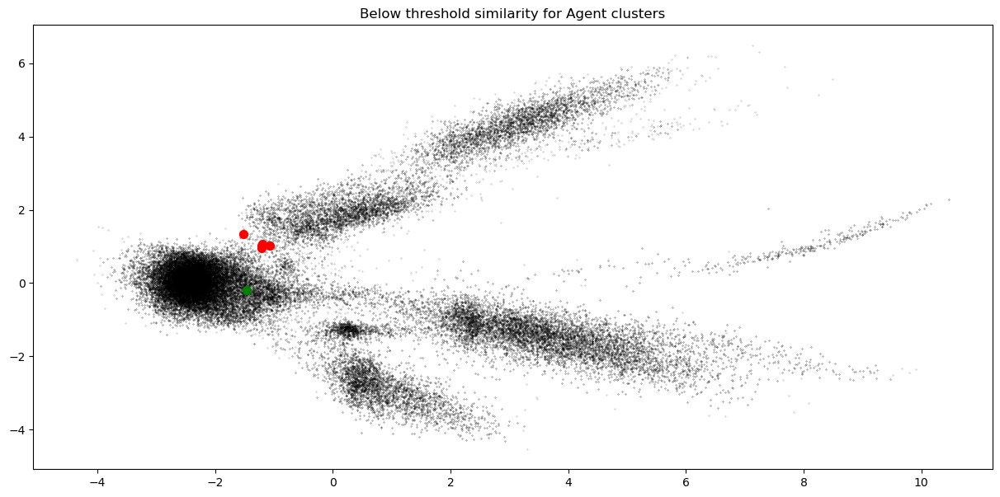

In [240]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 3958
red_indices = [539, 1219, 1397, 4131, 4529]
green_observation = text_pairs_24726.loc[green_index]
red_observations = text_pairs_24726.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=50, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=50, marker='o')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3225860097.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3225860097.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=1, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3225860097.py:9: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].x, cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].y, color='green', s=10, cmap='hsv_r')


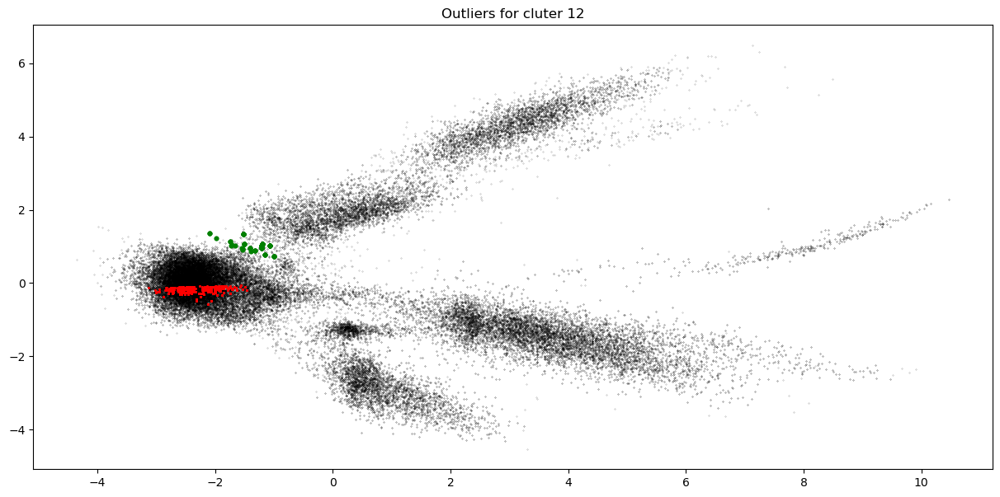

In [241]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_12_pairs_far.x, cluster_12_pairs_far.y, color='red', s=1, cmap='hsv_r')
#plt.scatter(cluster_12_pairs_far[cluster_12_pairs_far.l2 =="WinterSportPlayer"].x, cluster_12_pairs_far[cluster_12_pairs_far.l2 =="WinterSportPlayer"].y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].x, cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].y, color='green', s=10, cmap='hsv_r')


plt.title("Outliers for cluter 12")
#plt.colorbar()
            
plt.show()

As it can be seen from these sum below, all similarity scores lower than threshold belongs to the outlier values

In [242]:
cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].index.value_counts().sum()

1144

In [243]:
cluster_12_pairs_far_new_index[cluster_12_pairs_far_new_index.y > 0.5].l2.value_counts()

WinterSportPlayer     504
Athlete               398
Person                228
RacingDriver            6
FictionalCharacter      4
Scientist               2
Artist                  2
Name: l2, dtype: int64

### Cluster 1,2,3  subclusters

In [244]:
val_hier_df[val_hier_df.hierarchical_labels == 1]

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
26,Banshee Breeze (1995–2001) was an American Cha...,Species,Horse,RaceHorse,1.496989,3.089621,-1,1,"[0.007814435288310051, 0.010714929550886154, 0...","[banshee, breeze, american, champion, thorough...",Species
32,The snow-capped manakin (Lepidothrix nattereri...,Species,Animal,Bird,1.897381,4.419032,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[snowcapped, manakin, lepidothrix, nattereri, ...",Species
66,Xerarionta is a genus of land snails in the fa...,Species,Animal,Mollusca,2.319610,4.051808,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[xerarionta, genus, land, snail, family, helmi...",Species
85,Cephaloscypha is a fungal genus in the family ...,Species,Eukaryote,Fungus,1.981139,4.195099,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[cephaloscypha, fungal, genus, family, marasmi...",Species
91,Lizardfishes are benthic marine and estuarine ...,Species,Animal,Fish,2.664398,3.961230,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[lizardfish, benthic, marine, estuarine, bony,...",Species
...,...,...,...,...,...,...,...,...,...,...,...
35767,"The Red gurnard, also East Atlantic red gurnar...",Species,Animal,Fish,2.425548,3.738266,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[red, gurnard, also, east, atlantic, red, gurn...",Species
35787,"Aesculus (Carnea Group) 'Pendula', or Weeping ...",Species,Plant,CultivatedVariety,2.447833,3.874870,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[aesculus, carnea, group, 'pendula, ', weeping...",Species
35792,Porcellio parenzani is a species of woodlouse ...,Species,Animal,Crustacean,1.944036,4.242577,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[porcellio, parenzani, specie, woodlouse, genu...",Species
35820,Jensenia is a bryophyte plant genus in the liv...,Species,Plant,Moss,2.339267,3.895159,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[jensenia, bryophyte, plant, genus, liverwort,...",Species


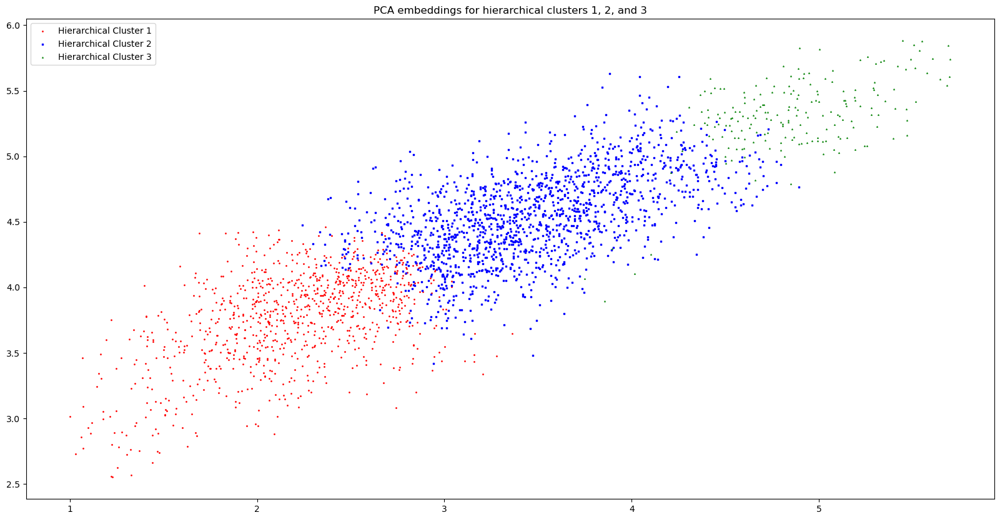

In [245]:
# Filter the val_hier_df dataframe to include only the rows where labels 6 (Agent) and hierarchical labels 10, 11, or 12
df_labels_9_1 = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)]
df_labels_9_2 = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)]
df_labels_9_3 = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)]

# Plot the embeddings for each hierarchical cluster separately using different markers
plt.figure(figsize=(20, 10))
plt.scatter(df_labels_9_1['x'], df_labels_9_1['y'], c='red', marker='o', s=1)
plt.scatter(df_labels_9_2['x'], df_labels_9_2['y'], c='blue', marker='s', s=1)
plt.scatter(df_labels_9_3['x'], df_labels_9_3['y'], c='green', marker='^', s=1)
plt.title('PCA embeddings for hierarchical clusters 1, 2, and 3')
plt.legend(['Hierarchical Cluster 1', 'Hierarchical Cluster 2', 'Hierarchical Cluster 3'])
plt.show()


In [246]:
# Agent Subcluster similarity scores

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
#AGENT: 12,11,15,10,14
# Extract the x and y values for each cluster
cluster_1_data = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)][['x', 'y']].values
cluster_2_data = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)][['x', 'y']].values
cluster_3_data = val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)][['x', 'y']].values
# Compute the pairwise cosine similarity between the data points within each cluster
cluster_1_similarity = cosine_similarity(cluster_1_data)
cluster_2_similarity = cosine_similarity(cluster_2_data)
cluster_3_similarity = cosine_similarity(cluster_3_data)
# Compute the pairwise cosine similarity between the data points across the different clusters
cluster_1_2_similarity = cosine_similarity(cluster_1_data, cluster_2_data)
cluster_1_3_similarity = cosine_similarity(cluster_1_data, cluster_3_data)
cluster_2_3_similarity = cosine_similarity(cluster_2_data, cluster_3_data)

# Print the average pairwise similarity within each cluster
print("Cluster 1 similarity:", np.mean(cluster_1_similarity))
print("Cluster 2 similarity:", np.mean(cluster_2_similarity))
print("Cluster 3 similarity:", np.mean(cluster_3_similarity))

# Print the average pairwise similarity across the different clusters
print("Cluster 1-2 similarity:", np.mean(cluster_1_2_similarity))
print("Cluster 1-3 similarity:", np.mean(cluster_1_3_similarity))
print("Cluster 2-3 similarity:", np.mean(cluster_2_3_similarity))


Cluster 1 similarity: 0.9942356
Cluster 2 similarity: 0.99670595
Cluster 3 similarity: 0.99895644
Cluster 1-2 similarity: 0.9877443
Cluster 1-3 similarity: 0.97338593
Cluster 2-3 similarity: 0.9936511


In [247]:
# Set the threshold similarity score
threshold = 0.92

# Filter the similarity matrices to include only the pairs of texts with a similarity score below the threshold
cluster_1_similarities_far = cluster_1_similarity[cluster_1_similarity < threshold]
cluster_2_similarities_far = cluster_2_similarity[cluster_2_similarity < threshold]
cluster_3_similarities_far = cluster_3_similarity[cluster_3_similarity < threshold]

# Print the number of text pairs below the threshold for each cluster
print("Number of text pairs below threshold in Cluster 1:", len(cluster_1_similarities_far))
print("Number of text pairs below threshold in Cluster 2:", len(cluster_2_similarities_far))
print("Number of text pairs below threshold in Cluster 3:", len(cluster_3_similarities_far))


Number of text pairs below threshold in Cluster 1: 162
Number of text pairs below threshold in Cluster 2: 0
Number of text pairs below threshold in Cluster 3: 0


In [248]:
# Get the indices of text pairs below threshold for cluster 1
cluster_1_indices_far = np.argwhere(cluster_1_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_1_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].iloc[cluster_1_indices_far.flatten()]

# Get the indices of text pairs below threshold for cluster 2
cluster_2_indices_far = np.argwhere(cluster_2_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_2_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].iloc[cluster_2_indices_far.flatten()]

# # Get the indices of text pairs below threshold for cluster 3
# cluster_3_indices_far = np.argwhere(cluster_14_similarity < threshold)
# # Get the corresponding text pairs from the val_hier_df dataframe
# cluster_3_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].iloc[cluster_3_indices_far.flatten()]



/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/224251094.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/224251094.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/224251094.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] ==

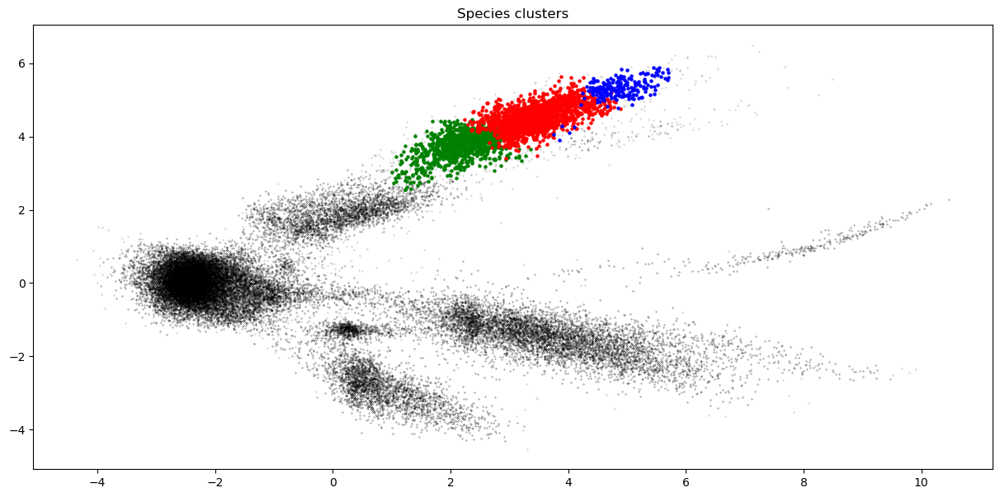

In [249]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].y, color='green', s=5, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].y, color='red', s=5, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].y, color='blue', s=5, cmap='hsv_r')

#plt.scatter(cluster_3_pairs_far.x, cluster_3_pairs_far.y, color='blue', s=5, cmap='hsv_r')

plt.title("Species clusters")
#plt.colorbar()
            
plt.show()

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1916968220.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1916968220.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_1_pairs_far.x, cluster_1_pairs_far.y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1916968220.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_2_pairs_far.x, cluster_2_pairs_far.y, color='red', s=5, cmap='hsv_r')


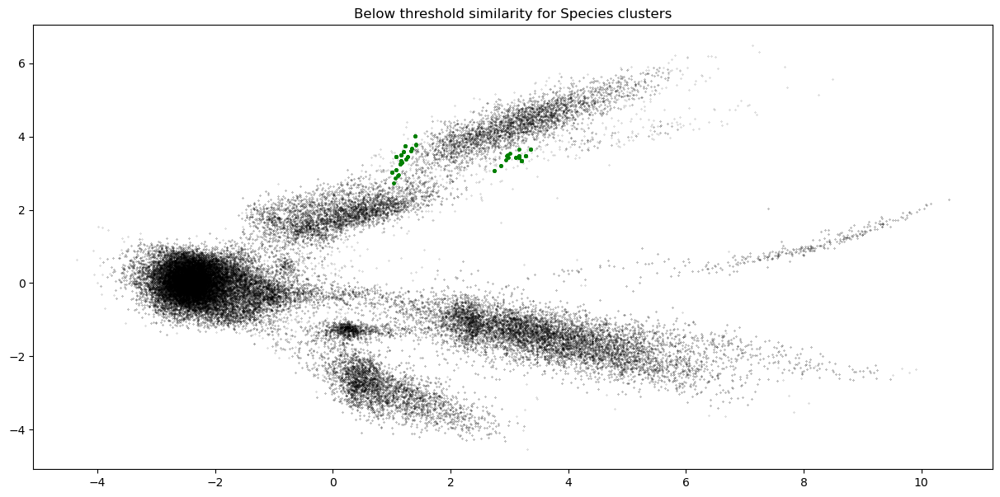

In [250]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_1_pairs_far.x, cluster_1_pairs_far.y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_2_pairs_far.x, cluster_2_pairs_far.y, color='red', s=5, cmap='hsv_r')
#plt.scatter(cluster_3_pairs_far.x, cluster_3_pairs_far.y, color='blue', s=5, cmap='hsv_r')

plt.title('Below threshold similarity for Species clusters')
#plt.colorbar()
            
plt.show()

### Cluster 1

In [251]:
cluster_1_indices_far

array([[ 44, 699],
       [ 89, 142],
       [ 89, 205],
       [ 89, 458],
       [ 89, 699],
       [ 89, 738],
       [ 92, 142],
       [ 92, 205],
       [ 92, 458],
       [ 92, 699],
       [ 92, 738],
       [104, 699],
       [142,  89],
       [142,  92],
       [142, 239],
       [142, 273],
       [142, 460],
       [142, 577],
       [142, 728],
       [142, 785],
       [143, 460],
       [164, 460],
       [164, 577],
       [165, 460],
       [205,  89],
       [205,  92],
       [205, 239],
       [205, 273],
       [205, 460],
       [205, 577],
       [205, 728],
       [205, 785],
       [234, 699],
       [239, 142],
       [239, 205],
       [239, 458],
       [239, 699],
       [239, 738],
       [273, 142],
       [273, 205],
       [273, 308],
       [273, 458],
       [273, 699],
       [273, 738],
       [308, 273],
       [308, 460],
       [308, 577],
       [308, 728],
       [308, 785],
       [338, 460],
       [338, 577],
       [386, 460],
       [403,

In [252]:
cluster_1_pairs_far.index.value_counts()

16759    40
26164    28
21249    28
27109    20
29125    20
5197     16
7745     16
16679    16
27376    16
9759     12
3121     10
3253     10
8653     10
11091    10
22519     8
17068     8
27989     8
24948     8
5878      4
34318     4
11986     4
29080     4
33642     2
31584     2
17988     2
1426      2
5908      2
24488     2
14450     2
13762     2
8541      2
5213      2
3834      2
34288     2
dtype: int64

In [253]:
cluster_1_pairs_far_new_index = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 1)].reset_index(drop=True).iloc[cluster_1_indices_far.flatten()]


#### Example with observation (new index) 460

In [254]:
cluster_1_pairs_far[cluster_1_pairs_far.index == 16759].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
16759,Fluvanna (1921) was an American Thoroughbred C...,Species,Horse,RaceHorse,3.203525,3.339803,9,1,"[0.007814435288310051, 0.010714929550886154, 0...","[fluvanna, american, thoroughbred, champion, r...",Species


In [255]:
cluster_1_pairs_far.l2.value_counts()

Horse        162
Animal       108
Eukaryote     36
Plant         18
Name: l2, dtype: int64

In [256]:
index_numbers = cluster_1_indices_far[cluster_1_indices_far[:,0] == 460][:,1]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens', 'topic_names']
text_pairs_460 = cluster_1_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]


In [257]:
import ast

# convert lists to tuples
for column in text_pairs_460.columns:
    if isinstance(text_pairs_460[column].iloc[0], list):
        text_pairs_460[column] = text_pairs_460[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_460.drop_duplicates(inplace=True)


In [258]:
text_pairs_460

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
142,"The Gadidae are a family of marine fish, inclu...",Species,Animal,Fish,1.194663,3.598045,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(gadidae, family, marine, fish, included, orde...",Species
143,Mesothen pyrrha is a moth of the Arctiidae fam...,Species,Animal,Insect,1.062106,2.857317,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(mesothen, pyrrha, moth, arctiidae, family, de...",Species
164,The augur buzzard (Buteo augur) is a 55–60 cm ...,Species,Animal,Bird,1.318882,3.602993,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(augur, buzzard, buteo, augur, cm, long, afric...",Species
165,The Smooth-eye poacher (Xeneretmus leiops) is ...,Species,Animal,Fish,1.406437,3.781455,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(smootheye, poacher, xeneretmus, leiops, fish,...",Species
205,Cyathea macarthurii is a fern in the Cyatheac...,Species,Plant,Fern,1.221932,3.752528,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(cyathea, macarthurii, fern, cyatheaceae, fami...",Species
308,Pumiliopareiasaurians are a group of pareiasau...,Species,Animal,Reptile,1.155317,3.343344,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(pumiliopareiasaurians, group, pareiasaurid, r...",Species
338,The powan (Coregonus clupeoides) is a kind of ...,Species,Animal,Fish,1.247423,3.379929,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(powan, coregonus, clupeoides, kind, freshwate...",Species
386,'Mrs. Harkness' (syn. Paul's Early Blush) is a...,Species,Plant,CultivatedVariety,1.097498,2.929458,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","('mrs, harkness, ', syn, paul, early, blush, r...",Species
458,Barbus is a genus of ray-finned fish in the fa...,Species,Animal,Fish,1.164291,3.488364,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(barbu, genus, rayfinned, fish, family, cyprin...",Species
477,Shokawa ikoi was a 1.8 m long choristoderan di...,Species,Animal,Reptile,1.142983,3.245170,9,1,"(0.007814435288310051, 0.010714929550886154, 0...","(shokawa, ikoi, long, choristoderan, diapsid, ...",Species


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2977530144.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


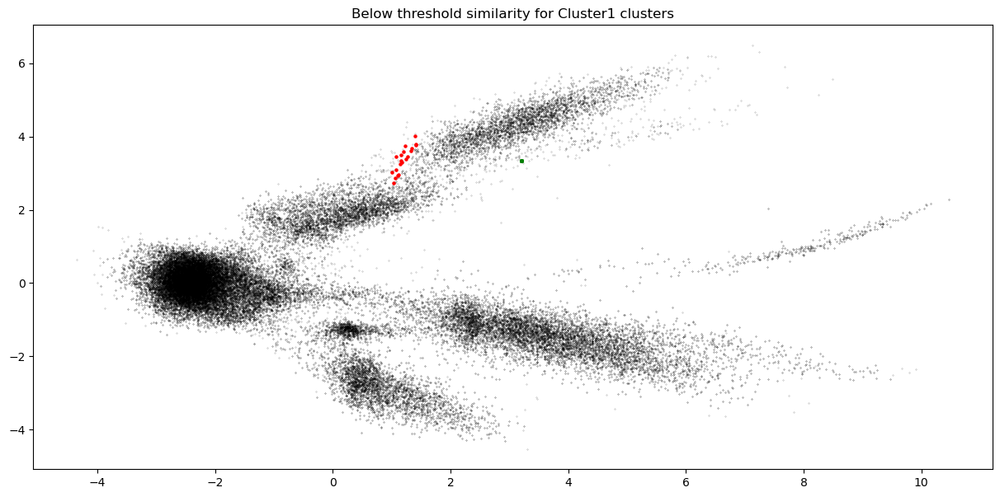

In [259]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 460
red_indices = index_numbers
green_observation = cluster_1_pairs_far_new_index[cluster_1_pairs_far_new_index.index == 460]
red_observations = text_pairs_460.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=5, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=5, marker='o')

plt.title('Below threshold similarity for Cluster1 clusters')
#plt.colorbar()
            
plt.show()


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1900003959.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1900003959.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Horse"].x, cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Horse"].y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1900003959.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Animal"].x, cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Animal"].y, color='red', s=5, cmap='hsv_r')


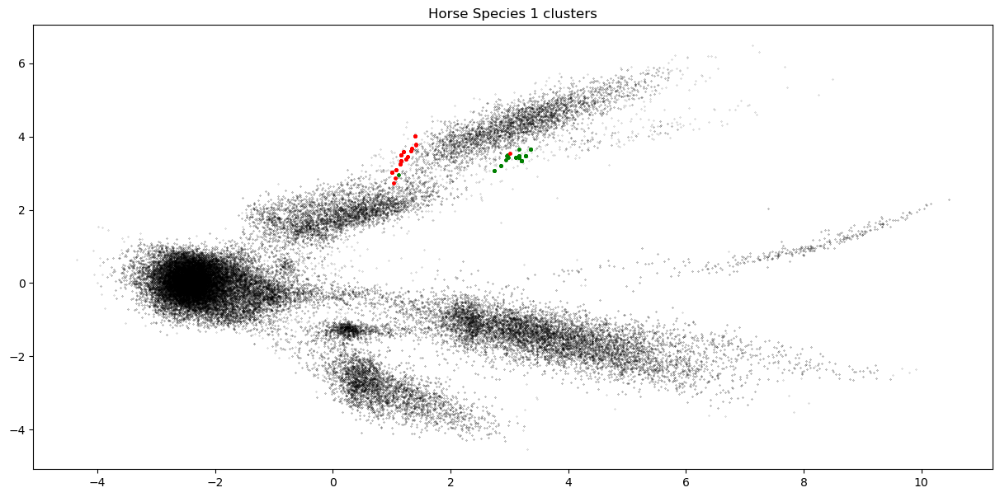

In [260]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Horse"].x, cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Horse"].y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Animal"].x, cluster_1_pairs_far[cluster_1_pairs_far.l2 == "Animal"].y, color='red', s=5, cmap='hsv_r')
#plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].y, color='blue', s=5, cmap='hsv_r')

#plt.scatter(cluster_3_pairs_far.x, cluster_3_pairs_far.y, color='blue', s=5, cmap='hsv_r')

plt.title("Horse Species 1 clusters")
#plt.colorbar()
            
plt.show()

##### Cluster 2

In [261]:
# Set the threshold similarity score
threshold = 0.955


# Filter the similarity matrices to include only the pairs of texts with a similarity score below the threshold

cluster_2_similarities_far = cluster_2_similarity[cluster_2_similarity < threshold]

# Print the number of text pairs below the threshold for each cluster
print("Number of text pairs below threshold in Cluster 2:", len(cluster_2_similarities_far))


Number of text pairs below threshold in Cluster 2: 158


In [262]:
# Get the indices of text pairs below threshold for cluster 2
cluster_2_indices_far = np.argwhere(cluster_2_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_2_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].iloc[cluster_2_indices_far.flatten()]


In [263]:
cluster_2_pairs_far_new_index = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2)].reset_index(drop=True).iloc[cluster_2_indices_far.flatten()]


##### New Index 601

In [264]:
cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.index == 601].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
601,Libocedrus is a genus of five species of conif...,Species,Plant,Conifer,4.722222,4.775268,9,2,"[0.007814435288310051, 0.010714929550886154, 0...","[libocedrus, genus, five, specie, coniferous, ...",Species-Plants


In [265]:
index_numbers = cluster_2_indices_far[cluster_2_indices_far[:,0] == 601][:,1]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens', 'topic_names']
text_pairs_601 = cluster_2_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]


In [266]:
import ast

# convert lists to tuples
for column in text_pairs_601.columns:
    if isinstance(text_pairs_601[column].iloc[0], list):
        text_pairs_601[column] = text_pairs_601[column].apply(lambda x: tuple(ast.literal_eval(str(x))))

# drop duplicates
text_pairs_601.drop_duplicates(inplace=True)


In [267]:
text_pairs_601.l2.value_counts()

Animal    3
Name: l2, dtype: int64

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/644579065.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


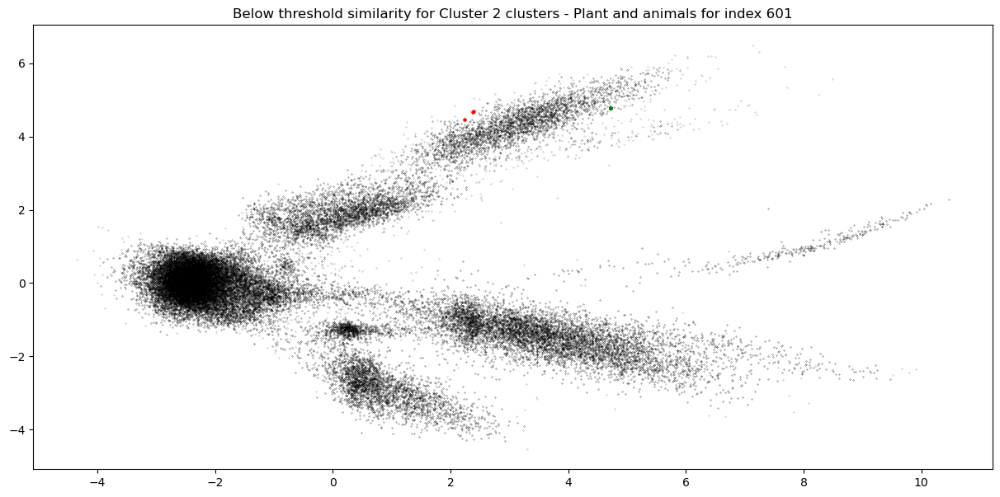

In [268]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 601
red_indices = index_numbers
green_observation = cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.index == 601]
red_observations = text_pairs_601.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=5, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=5, marker='o')

plt.title('Below threshold similarity for Cluster 2 clusters - Plant and animals for index 601')
#plt.colorbar()
            
plt.show()


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3580067202.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3580067202.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Plant"].x, cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Plant"].y, color='green', s=5, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/3580067202.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Animal"].x, cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Animal"].y, color='red', s=5, cmap='hsv_r')

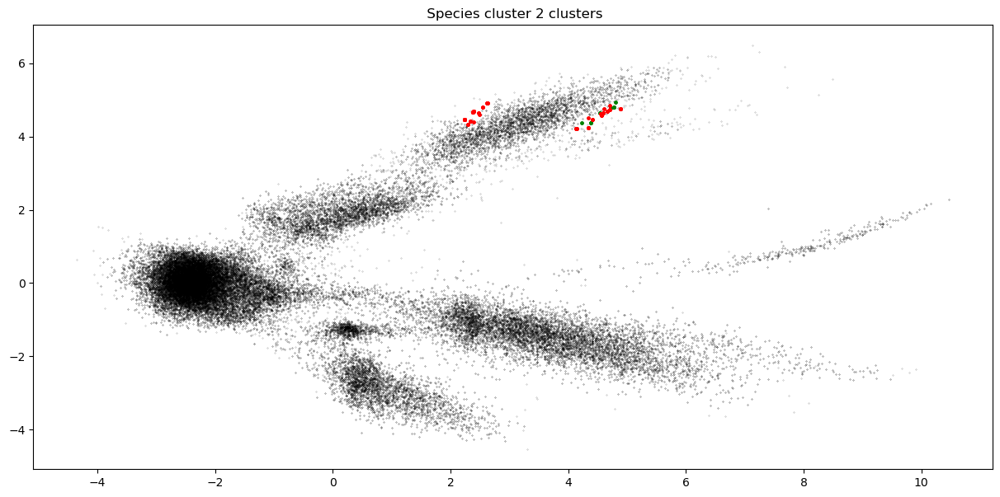

In [269]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Plant"].x, cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Plant"].y, color='green', s=5, cmap='hsv_r')
plt.scatter(cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Animal"].x, cluster_2_pairs_far_new_index[cluster_2_pairs_far_new_index.l2 == "Animal"].y, color='red', s=5, cmap='hsv_r')
#plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].y, color='blue', s=5, cmap='hsv_r')

#plt.scatter(cluster_3_pairs_far.x, cluster_3_pairs_far.y, color='blue', s=5, cmap='hsv_r')

plt.title(" Species cluster 2 clusters")
#plt.colorbar()
            
plt.show()

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1389861874.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/1389861874.py:7: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Plant")].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Plant")].y, color='red', s=5, cmap='hsv_r')


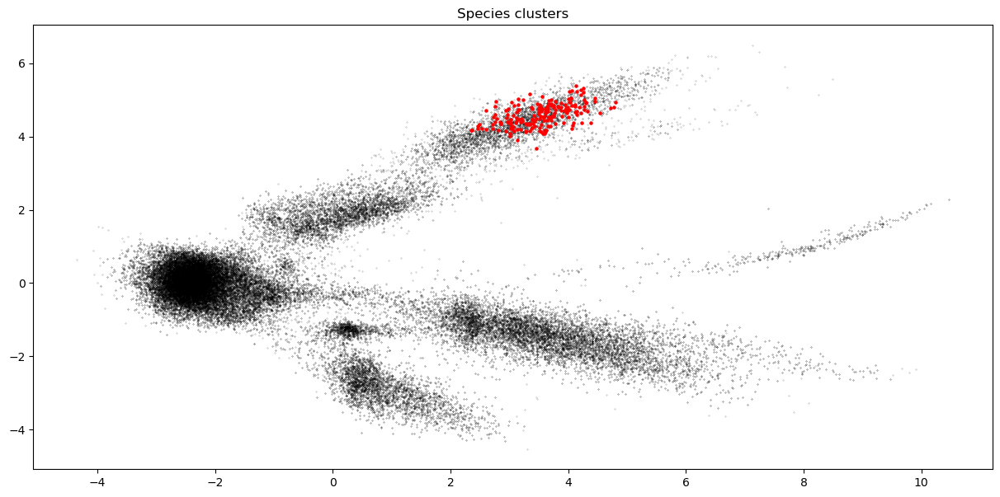

In [270]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')
plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Plant")].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Plant")].y, color='red', s=5, cmap='hsv_r')
#plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Eukaryote")].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Eukaryote")].y, color='green', s=5, cmap='hsv_r')
#plt.scatter(val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Animal")].x, val_hier_df[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 2) & (val_hier_df['l2'] == "Animal")].y, color='blue', s=0.1, cmap='hsv_r')

#plt.scatter(cluster_3_pairs_far.x, cluster_3_pairs_far.y, color='blue', s=5, cmap='hsv_r')

plt.title("Species clusters")
#plt.colorbar()
            
plt.show()

##### Cluster 3

In [271]:
# Set the threshold similarity score
threshold = 0.993


# Filter the similarity matrices to include only the pairs of texts with a similarity score below the threshold

cluster_3_similarities_far = cluster_3_similarity[cluster_3_similarity < threshold]

# Print the number of text pairs below the threshold for each cluster
print("Number of text pairs below threshold in Cluster 3:", len(cluster_3_similarities_far))


Number of text pairs below threshold in Cluster 3: 188


In [272]:
# Get the indices of text pairs below threshold for cluster 10
cluster_3_indices_far = np.argwhere(cluster_3_similarity < threshold)
# Get the corresponding text pairs from the val_hier_df dataframe
cluster_3_pairs_far = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].iloc[cluster_3_indices_far.flatten()]


In [273]:
cluster_3_pairs_far_new_index = val_hier_df.loc[(val_hier_df['labels'] == 9) & (val_hier_df['hierarchical_labels'] == 3)].reset_index(drop=True).iloc[cluster_3_indices_far.flatten()]


In [274]:
cluster_3_pairs_far_new_index.index.value_counts()

183    34
104    28
30     26
75     26
130    24
160    20
89     20
68     18
78     16
108    16
188    16
148    14
180    14
60     14
28     12
110    10
47      8
70      8
126     8
17      6
131     6
11      6
77      6
12      4
46      4
155     2
106     2
6       2
74      2
65      2
175     2
dtype: int64

In [275]:
cluster_3_pairs_far_new_index[cluster_3_pairs_far_new_index.index==183].head(1)

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens,topic_names
183,"Chalcides bedriagai, commonly known as Bedriag...",Species,Animal,Reptile,4.418434,5.594036,9,3,"[0.007814435288310051, 0.010714929550886154, 0...","[chalcides, bedriagai, commonly, known, bedria...",Species - Animals (Horses)


In [276]:
index_numbers = cluster_3_indices_far[cluster_3_indices_far[:,0] == 183][:,1]
columns_to_retrieve = ['text', 'l1', 'l2', 'l3', 'x', 'y', 'labels', 'hierarchical_labels', 'text_encodings', 'word_tokens', 'topic_names']
text_pairs_183 = cluster_3_pairs_far_new_index.loc[index_numbers, columns_to_retrieve]


/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_80419/2770790404.py:6: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')


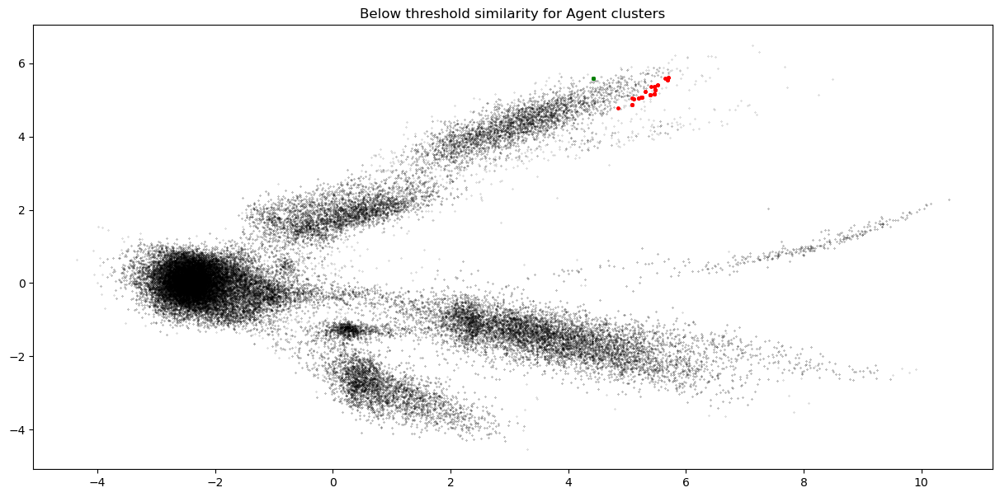

In [277]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(15, 7))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='gray', s=0.05)
plt.scatter(clustered.x, clustered.y, color='black', s=0.05, cmap='hsv_r')

# Add new scatter points for green and red observations
green_index = 183
red_indices = index_numbers
green_observation = cluster_3_pairs_far_new_index[cluster_3_pairs_far_new_index.index == 183]
red_observations = text_pairs_183.loc[red_indices]

plt.scatter(green_observation['x'], green_observation['y'], color='green', s=5, marker='o')
plt.scatter(red_observations['x'], red_observations['y'], color='red', s=5, marker='o')

plt.title('Below threshold similarity for Agent clusters')
#plt.colorbar()
            
plt.show()


In [278]:
text_pairs_183.l2.value_counts()

Animal       86
Plant        54
Eukaryote    48
Name: l2, dtype: int64

In [43]:
print('checkpoint')

checkpoint


### How to make Interactive tools ? 

In [316]:
import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Perform clustering and prepare data for visualization
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(val_prediction)
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')
result['hierarchical_labels'] = flat_clusters
cmap = plt.get_cmap('hsv_r')
scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))




In [317]:
max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
cluster_slider.max = max_cluster
    
# Update the step size of the threshold slider based on the current value
if threshold >= 500:
    t_slider.step = 100
elif threshold >= 100:
    t_slider.step = 50
else:
    t_slider.step = 10

In [318]:
max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
# Define and initialize cluster_slider
cluster_slider = widgets.IntSlider(
    value=0,
    min=0,
    max=100,
    step=1,
    description='Cluster:',
    orientation='horizontal'
)

# Assign the max value based on the max_cluster variable
cluster_slider.max = max_cluster


In [49]:
# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]
    fig, ax = plt.subplots(figsize=(15, 7))
    scatter = ax.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_ticks(clustered.hierarchical_labels.unique())
    cbar.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter.set_cmap('hsv_r')
    cbar.ax.set_title('Cluster Label')
    ax.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax.set_title('Generated labels')
    plt.show()

# Define the slider widget for threshold
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=1, description='Threshold')

# Call the function with the initial threshold value
hierarchical_clustering(40)

# Define function to update the plot when the slider value is changed
def update(threshold):
    # Update the hierarchical labels based on the new threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters
    # Call the visualization function with the updated labels
    hierarchical_clustering(threshold)

# Create and display the slider widget and visualization
widgets.interact(update, threshold=t_slider)

NameError: name 'widgets' is not defined

In [284]:
"""import ipywidgets as widgets
from IPython.display import display
import networkx as nx
import community.community_louvain as cl
import matplotlib.pyplot as plt

# create the graph and labels
def create_wordnet_graph(top_words, top_hypernyms):
    graph = nx.Graph()
    for word in top_words:
        graph.add_node(word)
    for hypernym in top_hypernyms:
        graph.add_node(hypernym)
    for word in top_words:
        hypernyms = get_hypernyms_for_word(word)
        for hypernym in hypernyms:
            if hypernym in top_hypernyms:
                graph.add_edge(word, hypernym)
    return graph

def draw_node_graph(graph, labels):
    partition = cl.best_partition(graph, resolution=5.0)
    pos = nx.spring_layout(graph, k=0.2)
    node_size = [partition[n]*50 for n in graph]
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    node_color = [cmap(partition[node]) for node in graph.nodes()]
    fig, ax = plt.subplots(figsize=(20, 10))
    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                     cmap=cmap, node_color=node_color)
    plt.show()

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()
num_clusters = len(hierarchical_labels)

# Define the cluster to display
selected_cluster = hierarchical_labels[0]

# Get initial data points belonging to current hierarchical cluster
cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster]

# Extract most frequent words and hypernyms
top_words = get_most_frequent_words(cluster_data["word_tokens"])
top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
top_word_hypernyms = {}
for word in top_words:
    top_word_hypernyms[word] = get_hypernyms_for_word(word)

# Create initial node graph
graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
labels = {node: node for node in graph.nodes()}

# Define slider widget
slider = widgets.IntSlider(min=1, max=num_clusters, step=1, value=1)

# Define function to update node graph when slider is changed
def update(selected_cluster):
    # Convert selected slider value to corresponding hierarchical cluster label
    selected_cluster_label = hierarchical_labels[selected_cluster - 1]
    
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster_label]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels)

# Link slider to update function
widgets.interact(update, selected_cluster=slider)"""


'import ipywidgets as widgets\nfrom IPython.display import display\nimport networkx as nx\nimport community.community_louvain as cl\nimport matplotlib.pyplot as plt\n\n# create the graph and labels\ndef create_wordnet_graph(top_words, top_hypernyms):\n    graph = nx.Graph()\n    for word in top_words:\n        graph.add_node(word)\n    for hypernym in top_hypernyms:\n        graph.add_node(hypernym)\n    for word in top_words:\n        hypernyms = get_hypernyms_for_word(word)\n        for hypernym in hypernyms:\n            if hypernym in top_hypernyms:\n                graph.add_edge(word, hypernym)\n    return graph\n\ndef draw_node_graph(graph, labels):\n    partition = cl.best_partition(graph, resolution=5.0)\n    pos = nx.spring_layout(graph, k=0.2)\n    node_size = [partition[n]*50 for n in graph]\n    cmap = plt.cm.get_cmap(\'viridis\', max(partition.values()) + 1)\n    node_color = [cmap(partition[node]) for node in graph.nodes()]\n    fig, ax = plt.subplots(figsize=(20, 10))\n

In [285]:
"""
#Merged version of the code

import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Perform clustering and prepare data for visualization
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(val_prediction)
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')
result['hierarchical_labels'] = flat_clusters
cmap = plt.get_cmap('hsv_r')
scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))

# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, show_all_clusters=True, selected_cluster=None):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]
    
    if show_all_clusters:
        # Color the observations based on their hierarchical cluster label
        colors = clustered.hierarchical_labels
        scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))
        fig, ax = plt.subplots(figsize=(15, 7))
        scatter = ax.scatter(clustered.x, clustered.y, c=colors, s=0.05, cmap=scatter_cmap)
        cbar = plt.colorbar(scatter, ax=ax)
        cbar.set_ticks(clustered.hierarchical_labels.unique())
        cbar.set_ticklabels(clustered.hierarchical_labels.unique())
        scatter.set_cmap('hsv_r')
        cbar.ax.set_title('Cluster Label')
    else:
        # Color the selected cluster with green and the rest of the observations with black
        colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
        fig, ax = plt.subplots(figsize=(15, 7))
        scatter = ax.scatter(clustered.x, clustered.y, c=colors, s=0.05)
        ax.set_title(f'Cluster {selected_cluster}')
        
    ax.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax.set_title('Generated labels')
    plt.show()

# Define the slider widgets for threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=1, description='Threshold')
cluster_dropdown = widgets.Dropdown(options=result.hierarchical_labels.unique(), description='Cluster')

# Call the function with the initial threshold value
hierarchical_clustering(40)

# Define function to update the plot when the slider or dropdown value is changed
def update(threshold, selected_cluster):
    # Update the hierarchical labels based on the new threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters
    # Determine whether to show all clusters or only the selected cluster
    show_all_clusters = (selected_cluster is None)
    # Update the color map for the scatter plot
    colors = []
    for label in flat_clusters:
        if show_all_clusters or label == selected_cluster:
            color = cluster_colors[label]
        else:
            color = 'lightgray'
        colors.append(color)
    scatter_plot.set_facecolor(colors)
    # Update the title of the scatter plot
    if show_all_clusters:
        scatter_plot.set_title('All Clusters')
    else:
        scatter_plot.set_title(f'Selected Cluster: {selected_cluster}')
    # Redraw the scatter plot
    fig.canvas.draw_idle()"""


"\n#Merged version of the code\n\nimport hdbscan\nfrom sklearn.decomposition import PCA\nfrom scipy.cluster import hierarchy\nimport ipywidgets as widgets\nfrom IPython.display import display\nimport matplotlib.pyplot as plt\nimport pandas as pd\nimport numpy as np\n\n# Perform clustering and prepare data for visualization\ncluster = hdbscan.HDBSCAN(min_cluster_size=15,\n                          metric='euclidean',\n                          cluster_selection_method='eom').fit(val_prediction)\npca_data = PCA(n_components=2).fit_transform(val_prediction)\nresult = pd.DataFrame(pca_data, columns=['x', 'y'])\nresult['labels'] = cluster.labels_\nlinkage_matrix = hierarchy.linkage(val_prediction, method='ward')\nflat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')\nresult['hierarchical_labels'] = flat_clusters\ncmap = plt.get_cmap('hsv_r')\nscatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))\n\n# Define function for hierarchical cluste

In [286]:
"""#Same code with the above clustering (no need to run again)
import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Perform clustering and prepare data for visualization
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(val_prediction)
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')
result['hierarchical_labels'] = flat_clusters
cmap = plt.get_cmap('hsv_r')
scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))"""


"#Same code with the above clustering (no need to run again)\nimport hdbscan\nfrom sklearn.decomposition import PCA\nfrom scipy.cluster import hierarchy\nimport ipywidgets as widgets\nfrom IPython.display import display\nimport matplotlib.pyplot as plt\nimport pandas as pd\nimport numpy as np\n\n# Perform clustering and prepare data for visualization\ncluster = hdbscan.HDBSCAN(min_cluster_size=15,\n                          metric='euclidean',\n                          cluster_selection_method='eom').fit(val_prediction)\npca_data = PCA(n_components=2).fit_transform(val_prediction)\nresult = pd.DataFrame(pca_data, columns=['x', 'y'])\nresult['labels'] = cluster.labels_\nlinkage_matrix = hierarchy.linkage(val_prediction, method='ward')\nflat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')\nresult['hierarchical_labels'] = flat_clusters\ncmap = plt.get_cmap('hsv_r')\nscatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))"

<IPython.core.display.Javascript object>


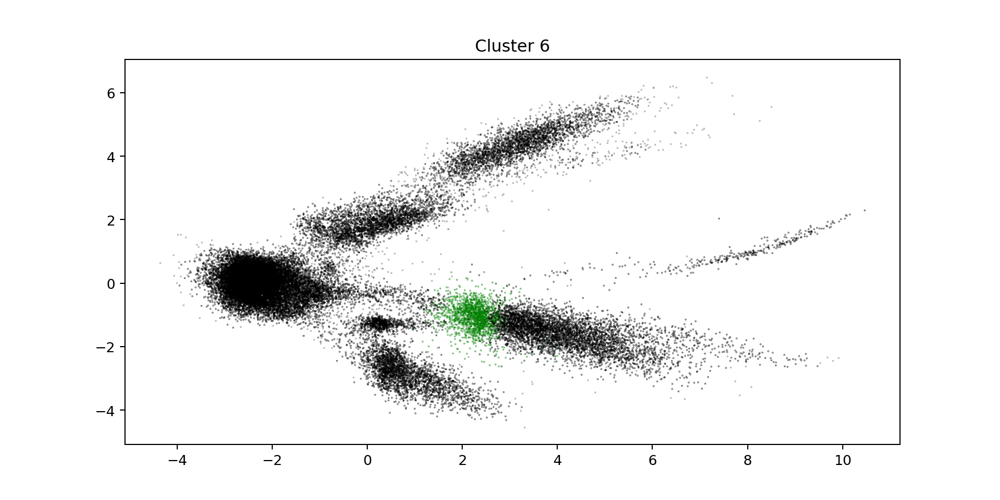

interactive(children=(FloatSlider(value=40.0, description='Threshold', max=600.0, step=1.0), Dropdown(descript…

<function __main__.update(threshold, selected_cluster)>

In [390]:
# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, selected_cluster):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]
    
    # Color the selected cluster with green and the rest of the observations with black
    colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
    
    fig, ax = plt.subplots(figsize=(10, 5))
    scatter = ax.scatter(clustered.x, clustered.y, c=colors, s=0.05)
    ax.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax.set_title(f'Cluster {selected_cluster}')
    plt.show()

# Define the slider widgets for threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=1, description='Threshold')
cluster_dropdown = widgets.Dropdown(options=result.hierarchical_labels.unique(), description='Cluster')

# Call the function with the initial threshold and selected cluster values
hierarchical_clustering(40, result.hierarchical_labels.unique()[0])

# Define function to update the plot when the slider or dropdown value is changed
def update(threshold, selected_cluster):
    # Update the hierarchical labels based on the new threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters
    # Call the visualization function with the updated labels and selected cluster
    hierarchical_clustering(threshold, selected_cluster)

# Create and display the slider and dropdown widgets and visualization
widgets.interact(update, threshold=t_slider, selected_cluster=cluster_dropdown)

In [288]:
"""# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, selected_cluster):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]

    # Cluster the data with the current threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Determine the maximum number of clusters based on the current threshold value
    max_cluster = len(np.unique(flat_clusters))

    # Color the clusters with the current hierarchical labels
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 7))

    scatter1 = ax1.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
    cbar1 = plt.colorbar(scatter1, ax=ax1)
    cbar1.set_ticks(clustered.hierarchical_labels.unique())
    cbar1.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter1.set_cmap('hsv_r')
    cbar1.ax.set_title('Cluster Label')
    ax1.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax1.set_title('Generated labels')

    # Determine the color of the selected cluster
    if selected_cluster > max_cluster:
        selected_cluster = max_cluster
    colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
    scatter2 = ax2.scatter(clustered.x, clustered.y, c=colors, s=0.05)
    ax2.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax2.set_title(f'Cluster {selected_cluster}')

    plt.show()

# Define the slider widgets for threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=1, description='Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result.hierarchical_labels.max(), step=1, description='Cluster')

# Call the function with the initial threshold and selected cluster values
hierarchical_clustering(40, 1)

# Define function to update the plot when the slider or dropdown value is changed
def update(threshold, selected_cluster):
    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
    cluster_slider.max = max_cluster

    # Call the clustering function with the updated threshold and selected cluster values
    hierarchical_clustering(threshold, selected_cluster)

# Create and display the slider and dropdown widgets and visualization
widgets.interact(update, threshold=t_slider, selected_cluster=cluster_slider)"""


"# Define function for hierarchical clustering and interactive visualization\ndef hierarchical_clustering(threshold, selected_cluster):\n    # Create scatter plot with color-coded clusters and outliers\n    outliers = result.loc[result.labels == -1, :]\n    clustered = result.loc[result.labels != -1, :]\n\n    # Cluster the data with the current threshold value\n    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')\n    result['hierarchical_labels'] = flat_clusters\n\n    # Determine the maximum number of clusters based on the current threshold value\n    max_cluster = len(np.unique(flat_clusters))\n\n    # Color the clusters with the current hierarchical labels\n    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 7))\n\n    scatter1 = ax1.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')\n    cbar1 = plt.colorbar(scatter1, ax=ax1)\n    cbar1.set_ticks(clustered.hierarchical_labels.unique())\n    cbar1.set_

In [289]:
plt.clf()

<Figure size 3000x2000 with 0 Axes>

### SELECTION OF NUMBER OF CLUSTERS AND CHOOSING SPECIFIC CLUSTER LOCATION ON EMBEDDING SPACE

<IPython.core.display.Javascript object>


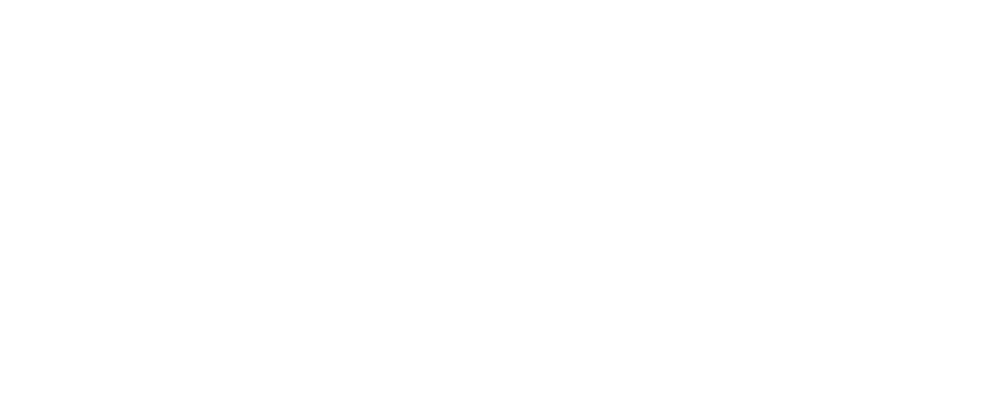

interactive(children=(FloatSlider(value=40.0, description='Threshold', max=600.0, step=10.0), IntSlider(value=…

<function __main__.update(threshold, selected_cluster)>

In [395]:
# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, selected_cluster):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]

    # Cluster the data with the current threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Determine the maximum number of clusters based on the current threshold value
    max_cluster = len(np.unique(flat_clusters))

    # Color the clusters with the current hierarchical labels
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 4))

    scatter1 = ax1.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
    cbar1 = plt.colorbar(scatter1, ax=ax1)
    cbar1.set_ticks(clustered.hierarchical_labels.unique())
    cbar1.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter1.set_cmap('hsv_r')
    cbar1.ax.set_title('Cluster Label')
    ax1.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax1.set_title('Generated labels')

    # Determine the color of the selected cluster
    if selected_cluster > max_cluster:
        selected_cluster = max_cluster
    colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
    scatter2 = ax2.scatter(clustered.x, clustered.y, c=colors, s=0.05)
    ax2.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax2.set_title(f'Cluster {selected_cluster}')

    plt.show()

# Define function to update the plot when the slider or dropdown value is changed
def update(threshold, selected_cluster):
    # Close all existing figures
    plt.close('all')

    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
    cluster_slider.max = max_cluster
    
    # Update the step size of the threshold slider based on the current value
    if threshold >= 500:
        t_slider.step = 100
    elif threshold >= 100:
        t_slider.step = 50
    else:
        t_slider.step = 10
        
    # Call the clustering function with the updated threshold and selected cluster values
    hierarchical_clustering(threshold, selected_cluster)

# Define the slider widgets for threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=10, description='Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result.hierarchical_labels.max(), step=1, description='Cluster')

# Call the function with the initial threshold and selected cluster values
hierarchical_clustering(40, 1)

# Create and display the slider and dropdown widgets and visualization
widgets.interact(update, threshold=t_slider, selected_cluster=cluster_slider)


### NODE GRAPHS OF SELECTED CLUSTER AFTER CHOOSING THE NUMBER OF CLUSTERS

In [420]:
import ipywidgets as widgets
from IPython.display import display
import networkx as nx
import community.community_louvain as cl
import matplotlib.pyplot as plt

# create the graph and labels
def create_wordnet_graph(top_words, top_hypernyms):
    graph = nx.Graph()
    for word in top_words:
        graph.add_node(word)
    for hypernym in top_hypernyms:
        graph.add_node(hypernym)
    for word in top_words:
        hypernyms = get_hypernyms_for_word(word)
        for hypernym in hypernyms:
            if hypernym in top_hypernyms:
                graph.add_edge(word, hypernym)
    return graph

def draw_node_graph(graph, labels, selected_cluster):
    partition = cl.best_partition(graph, resolution=5.0)
    pos = nx.spring_layout(graph, k=0.2)
    node_size = [partition[n]*50 for n in graph]
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    node_color = [cmap(partition[node]) for node in graph.nodes()]
    fig, ax = plt.subplots(figsize=(10, 5))
    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                     cmap=cmap, node_color=node_color)
    plt.title(f"Node graph for cluster {selected_cluster}")
    plt.show()

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()
num_clusters = len(hierarchical_labels)

# Define the cluster to display
selected_cluster = hierarchical_labels[0]

# Get initial data points belonging to current hierarchical cluster
cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster]

# Extract most frequent words and hypernyms
top_words = get_most_frequent_words(cluster_data["word_tokens"])
top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
top_word_hypernyms = {}
for word in top_words:
    top_word_hypernyms[word] = get_hypernyms_for_word(word)

# Create initial node graph
graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
labels = {node: node for node in graph.nodes()}

# Define slider widget
slider = widgets.IntSlider(min=1, max=num_clusters, step=1, value=1)

# Define function to update node graph when slider is changed
def update(selected_cluster):
    # Close all previous plot figures
    plt.close('all')

    # Convert selected slider value to corresponding hierarchical cluster label
    selected_cluster_label = hierarchical_labels[selected_cluster - 1]
    
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster_label]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, selected_cluster)

# Link slider to update function,
widgets.interact(update, selected_cluster=slider)

KeyError: 'hierarchical_labels'

In [ ]:
"""import plotly.graph_objects as go
from IPython.display import display
import ipywidgets as widgets

# Create a mapping from (x, y) coordinates to text
coord_to_text = dict(((x, y), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

# Prepare a plotly Figure
fig = go.Figure()

# Add scatter plot for clustered data
for cluster in result.hierarchical_labels.unique():
    clustered_data = result[result.hierarchical_labels == cluster]
    fig.add_trace(go.Scatter(
        x=clustered_data.x,
        y=clustered_data.y,
        mode='markers',
        marker=dict(size=8),
        name='Cluster {}'.format(cluster),  # change to format method for string
    ))

# Add scatter plot for outliers
outliers = result[result.labels == -1]
fig.add_trace(go.Scatter(
    x=outliers.x,
    y=outliers.y,
    mode='markers',
    marker=dict(size=8, color='gray'),
    name='Outliers'
))

# Create a widget to display the text
text_widget = widgets.Textarea()

# Add click event handler
def on_click(trace, points, state):
    if points.point_inds:
        ind = points.point_inds[0]  # get the index of the selected point
        x, y = trace['x'][ind], trace['y'][ind]  # get the x, y coordinates of the selected point
        text = coord_to_text.get((x, y), 'No text found')  # retrieve the text using the coordinates
        text_widget.value = text  # update the widget with the text

for trace in fig.data:
    trace.on_click(on_click)

# Display the figure and the widget
fig.show()
display(text_widget)
"""

### Clicking on specific text from the embedding space


<IPython.core.display.Javascript object>


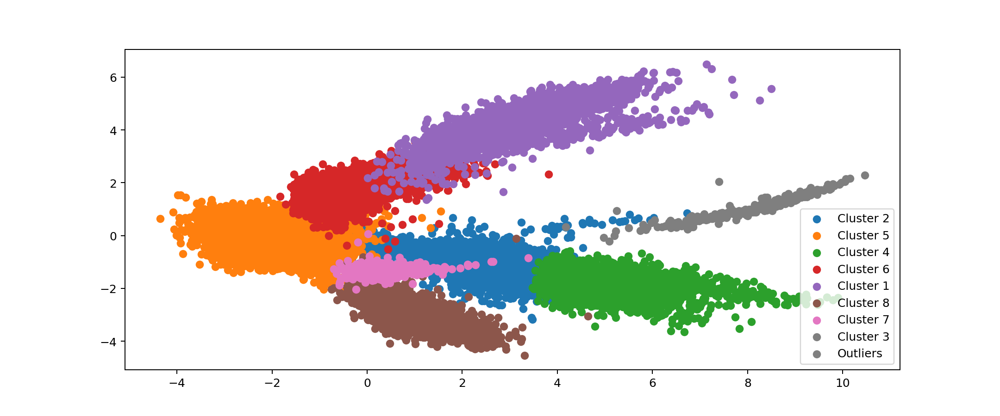

Textarea(value='')

In [398]:
# Clicking on specific text from the embedding space
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets

# Create a mapping from (x, y) coordinates to text
# Round coordinates to 3 decimal places
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

fig, ax = plt.subplots(figsize=(12, 5))

scatter_plots = []
for cluster in clusters:
    clustered_data = result[result.hierarchical_labels == cluster]
    scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
    scatter_plots.append(scatter)

outliers = result[result.hierarchical_labels == -1]
scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
scatter_plots.append(scatter)

ax.legend()

# Create a widget to display the text
text_widget = widgets.Textarea()
display(text_widget)

# Function to handle click events
def on_click(event):
    if event.inaxes == ax:
        for sc in scatter_plots:
            cont, ind = sc.contains(event)
            if cont:
                x, y = sc.get_offsets()[ind["ind"][0]]
                text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
                text_widget.value = text  # update the widget with the text
                return

fig.canvas.mpl_connect("button_press_event", on_click)

plt.show()

In [296]:
'''from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from IPython.display import clear_output, display
import ipywidgets as widgets

# Create a mapping from (x, y) coordinates to text
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

fig, ax = plt.subplots(figsize=(12, 5))

scatter_plots = []
for cluster in clusters:
    clustered_data = result[result.hierarchical_labels == cluster]
    scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
    scatter_plots.append(scatter)

outliers = result[result.hierarchical_labels == -1]
scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
scatter_plots.append(scatter)

ax.legend()

# Create a widget to display the text
text_widget = widgets.Textarea()
display(text_widget)

# Compute the nearest neighbors
nbrs = NearestNeighbors(n_neighbors=11, metric='cosine').fit(val_prediction)

# Create a mapping from index to text
index_to_text = dict(enumerate(val_hier_df['text'].values))

# Create an index to (x, y) mapping
index_to_coord = dict(enumerate(zip(val_hier_df['x'], val_hier_df['y'])))

# Create a widget for the number of neighbors
neighbors_slider = widgets.IntSlider(min=1, max=50, step=1, value=10)
display(neighbors_slider)

# Define the function to update the nearest neighbors and node graph
def update_neighbors_and_graph(index, n_neighbors):
    distances, indices = nbrs.kneighbors(val_prediction[index].reshape(1, -1), n_neighbors + 1)
    neighbor_texts = [index_to_text[i] for i in indices.flatten()]
    neighbor_coords = [index_to_coord[i] for i in indices.flatten()]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(neighbor_texts)
    top_hypernyms = get_most_frequent_hypernyms(neighbor_texts)
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, n_neighbors)

    # Show neighbor texts
    print('\n'.join(neighbor_texts))

    # Show neighbor coordinates
    plt.scatter(*zip(*neighbor_coords), c='r')
    plt.show()

# Global variable to store currently selected index
current_index = None

# Function to update nearest neighbors and node graph when slider is changed
def on_slider_change(change):
    # Check if index is not None (i.e., a point has been clicked)
    if current_index is not None:
        # Clear the old output
        clear_output(wait=True)

        # Get the new slider value
        new_value = change.new

        # Update nearest neighbors and node graph
        update_neighbors_and_graph(current_index, new_value)

        # Redraw scatter plot and re-display widget
        draw_scatter_plot()
        display(neighbors_slider)

def draw_scatter_plot():
    plt.close('all')  # Close all previous figures
    fig, ax = plt.subplots(figsize=(12, 5))

    scatter_plots = []
    for cluster in clusters:
        clustered_data = result[result.hierarchical_labels == cluster]
        scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
        scatter_plots.append(scatter)

    outliers = result[result.hierarchical_labels == -1]
    scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
    scatter_plots.append(scatter)

    ax.legend()

    # Connect the click event to the new plot
    fig.canvas.mpl_connect("button_press_event", on_click)

# Function to handle click events
def on_click(event):
    if event.inaxes == ax:
        global current_index
        for i, sc in enumerate(scatter_plots):
            cont, ind = sc.contains(event)
            if cont:
                # Close all previous plot figures
                plt.close('all')

                # Get index of selected point
                current_index = i * len(sc.get_offsets()) + ind["ind"][0]
                
                # Update nearest neighbors and node graph
                update_neighbors_and_graph(current_index, neighbors_slider.value)
                
                # Show the text of selected point
                x, y = sc.get_offsets()[ind["ind"][0]]
                text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
                text_widget.value = text  # update the widget with the text
                return

fig.canvas.mpl_connect("button_press_event", on_click)

plt.show()

# Connect the slider change event to the function
neighbors_slider.observe(on_slider_change, names='value')
'''

'from sklearn.metrics.pairwise import cosine_similarity\nfrom sklearn.neighbors import NearestNeighbors\nimport matplotlib.pyplot as plt\nfrom IPython.display import clear_output, display\nimport ipywidgets as widgets\n\n# Create a mapping from (x, y) coordinates to text\ncoord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[[\'x\', \'y\', \'text\']].values)\n\nclusters = result.hierarchical_labels.unique()\n\nfig, ax = plt.subplots(figsize=(12, 5))\n\nscatter_plots = []\nfor cluster in clusters:\n    clustered_data = result[result.hierarchical_labels == cluster]\n    scatter = ax.scatter(clustered_data[\'x\'], clustered_data[\'y\'], label=\'Cluster {}\'.format(cluster))\n    scatter_plots.append(scatter)\n\noutliers = result[result.hierarchical_labels == -1]\nscatter = ax.scatter(outliers[\'x\'], outliers[\'y\'], color=\'gray\', label=\'Outliers\')\nscatter_plots.append(scatter)\n\nax.legend()\n\n# Create a widget to display the text\ntext_widget = widg

In [ ]:
# Works but node graphs do not work !!!
%matplotlib notebook
#%matplotlib inline
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from IPython.display import clear_output, display
import ipywidgets as widgets



# Create a mapping from (x, y) coordinates to text
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

# Create a widget to display the text
text_widget = widgets.Textarea()

# Compute the nearest neighbors
nbrs = NearestNeighbors(n_neighbors=11, metric='cosine').fit(val_prediction)

# Create a mapping from index to text
index_to_text = dict(enumerate(val_hier_df['text'].values))

# Create an index to (x, y) mapping
index_to_coord = dict(enumerate(zip(val_hier_df['x'], val_hier_df['y'])))

# Create a widget for the number of neighbors
neighbors_slider = widgets.IntSlider(min=1, max=50, step=1, value=10)

# Define the function to update the nearest neighbors and node graph
def update_neighbors_and_graph(index, n_neighbors):
    distances, indices = nbrs.kneighbors(val_prediction[index].reshape(1, -1), n_neighbors + 1)
    neighbor_texts = [index_to_text[i] for i in indices.flatten()]
    neighbor_coords = [index_to_coord[i] for i in indices.flatten()]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(neighbor_texts)
    top_hypernyms = get_most_frequent_hypernyms(neighbor_texts)
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, n_neighbors)

    # Show neighbor texts
    print('\n'.join(neighbor_texts))

    # Show neighbor coordinates
    plt.scatter(*zip(*neighbor_coords), c='r')

# Global variable to store currently selected index
current_index = None

# Function to update nearest neighbors and node graph when slider is changed
def on_slider_change(change):
    # Check if index is not None (i.e., a point has been clicked)
    if current_index is not None:
        # Clear the old output
        clear_output(wait=True)

        # Get the new slider value
        new_value = change.new

        # Update nearest neighbors and node graph
        update_neighbors_and_graph(current_index, new_value)

        # Redraw scatter plot and re-display widget
        draw_scatter_plot()
        display(neighbors_slider)
        display(text_widget)

# Draw initial scatter plot
def draw_scatter_plot():
    plt.close('all')  # Close all previous figures
    fig, ax = plt.subplots(figsize=(12, 5))

    scatter_plots = []
    for cluster in clusters:
        clustered_data = result[result.hierarchical_labels == cluster]
        scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
        scatter_plots.append(scatter)

    outliers = result[result.hierarchical_labels == -1]
    scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
    scatter_plots.append(scatter)

    ax.legend()

    fig.canvas.mpl_connect("button_press_event", on_click)

    plt.show()


# Function to handle click events
def on_click(event):
    global current_index, ax
    for i, sc in enumerate(scatter_plots):
        cont, ind = sc.contains(event)
        if cont:
            # Clear the old output
            clear_output(wait=True)

            # Get index of selected point
            current_index = i * len(sc.get_offsets()) + ind["ind"][0]
            
            # Update nearest neighbors and node graph
            update_neighbors_and_graph(current_index, neighbors_slider.value)
            
            # Show the text of selected point
            x, y = sc.get_offsets()[ind["ind"][0]]
            text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
            text_widget.value = text  # update the widget with the text
            
            # Redraw scatter plot and re-display widget
            draw_scatter_plot()
            display(neighbors_slider)
            display(text_widget)
            return

# Display initial scatter plot and widgets
draw_scatter_plot()
display(neighbors_slider)
display(text_widget)

# Connect the slider change event to the function
neighbors_slider.observe(on_slider_change, names='value')


In [298]:
### This code works well but it needs to clear the old output for memory protection 

### SELECTING SPECIFIC TOPIC AND GROUPING WITH N CLOSEST OBSERVATIONS + NODE GRAPH

In [1]:
%matplotlib notebook
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from IPython.display import clear_output, display
import ipywidgets as widgets
plt.rcParams["figure.figsize"] = (20, 10)

# Create a mapping from (x, y) coordinates to text
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

# Create a widget to display the text
text_widget = widgets.Textarea()

# Compute the nearest neighbors
nbrs = NearestNeighbors(n_neighbors=11, metric='cosine').fit(val_prediction)

# Create a mapping from index to text
index_to_text = dict(enumerate(val_hier_df['text'].values))

# Create an index to (x, y) mapping
index_to_coord = dict(enumerate(zip(val_hier_df['x'], val_hier_df['y'])))

# Create a widget for the number of neighbors
neighbors_slider = widgets.IntSlider(min=1, max=50, step=1, value=10)

# Define the function to update the nearest neighbors and node graph
def update_neighbors_and_graph(index, n_neighbors):
    distances, indices = nbrs.kneighbors(val_prediction[index].reshape(1, -1), n_neighbors + 1)
    neighbor_texts = [index_to_text[i] for i in indices.flatten()]
    neighbor_coords = [index_to_coord[i] for i in indices.flatten()]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(neighbor_texts)
    top_hypernyms = get_most_frequent_hypernyms(neighbor_texts)
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, n_neighbors)

    # Show neighbor texts
    print('\n'.join(neighbor_texts))

    # Show neighbor coordinates
    plt.scatter(*zip(*neighbor_coords), c='r')

# Global variable to store currently selected index
current_index = None

# Function to update nearest neighbors and node graph when slider is changed
def on_slider_change(change):
    # Check if index is not None (i.e., a point has been clicked)
    if current_index is not None:
        # Clear the old output
        clear_output(wait=True)

        # Get the new slider value
        new_value = change.new

        # Update nearest neighbors and node graph
        update_neighbors_and_graph(current_index, new_value)

        # Redraw scatter plot and re-display widget
        draw_scatter_plot()
        display(neighbors_slider)
        display(text_widget)

# Draw initial scatter plot
def draw_scatter_plot():
    fig, ax = plt.subplots(figsize=(12, 5))

    scatter_plots = []
    for cluster in clusters:
        clustered_data = result[result.hierarchical_labels == cluster]
        scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
        scatter_plots.append(scatter)

    outliers = result[result.hierarchical_labels == -1]
    scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
    scatter_plots.append(scatter)

    ax.legend()

    fig.canvas.mpl_connect("button_press_event", on_click)

    plt.show()

# Function to handle click events
def on_click(event):
    global current_index, ax
    for i, sc in enumerate(scatter_plots):
        cont, ind = sc.contains(event)
        if cont:
            # Clear the old output
            clear_output(wait=True)

            # Get index of selected point
            current_index = i * len(sc.get_offsets()) + ind["ind"][0]
            
            # Update nearest neighbors and node graph
            update_neighbors_and_graph(current_index, neighbors_slider.value)
            
            # Show the text of selected point
            x, y = sc.get_offsets()[ind["ind"][0]]
            text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
            text_widget.value = text  # update the widget with the text
            
            # Redraw scatter plot and re-display widget
            draw_scatter_plot()
            display(neighbors_slider)
            display(text_widget)
            return

# Display initial scatter plot and widgets
draw_scatter_plot()
display(neighbors_slider)
display(text_widget)

# Connect the slider change event to the function
neighbors_slider.observe(on_slider_change, names='value')

KeyboardInterrupt: 

In [300]:
### Nested clustering for finding subclusters from different clusters: 

In [403]:
%matplotlib notebook
#%matplotlib inline

# Define function for sub-clustering and interactive visualization
def sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Main clustering
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Get data for the selected main cluster
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    
    # Sub-clustering within the selected main cluster
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    sub_flat_clusters = hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')
    result.loc[result['hierarchical_labels'] == main_selected_cluster, 'sub_hierarchical_labels'] = sub_flat_clusters


    # Determine the maximum number of sub-clusters based on the current sub-threshold value
    max_sub_cluster = len(np.unique(sub_flat_clusters))

    # Visualization and calculation of node graphs for the sub-clusters...

# Define function to update the plot when the slider or dropdown value is changed
def update(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Close all existing figures
    plt.close('all')

    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')))
    cluster_slider.max = max_cluster

    # Update the range and step size of the sub-threshold slider based on the main threshold
    sub_t_slider.max = main_threshold
    if sub_threshold >= 500:
        sub_t_slider.step = 100
    elif sub_threshold >= 100:
        sub_t_slider.step = 50
    else:
        sub_t_slider.step = 10

    # Update the range of the sub-cluster slider based on the current sub-threshold value
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

    # Call the sub-clustering function with the updated threshold and selected cluster values
    sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster)
# Define the slider widgets for main threshold, sub-threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=10, description='Main Threshold')
sub_t_slider = widgets.FloatSlider(value=10, min=0, max=40, step=5, description='Sub-Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result['hierarchical_labels'].max(), description='Main Cluster')
sub_cluster_slider = widgets.IntSlider(value=1, min=1, max=1, description='Sub-Cluster')

# Call the function with the initial threshold and selected cluster values
sub_clustering(40, 10, 1, 1)

# Define function to update the sub-cluster slider based on the selected main cluster
def update_sub_cluster_slider(change):
    main_selected_cluster = change.new
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_t_slider.value, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

# Link the main cluster slider to update the sub-cluster slider
cluster_slider.observe(update_sub_cluster_slider, names='value')

# Create and display the slider and dropdown widgets for main and sub clustering
widgets.interact(update, main_threshold=t_slider, sub_threshold=sub_t_slider,
                main_selected_cluster=cluster_slider, sub_selected_cluster=sub_cluster_slider)


ValueError: The condensed distance matrix must contain only finite values.

In [404]:
print(main_cluster_data.isnull().sum())  # Check for NaN values
print(np.isinf(main_cluster_data).sum()) 

NameError: name 'main_cluster_data' is not defined

In [331]:
from scipy.cluster import hierarchy
import numpy as np
from matplotlib import pyplot as plt
from collections import Counter
from nltk.corpus import wordnet
import ipywidgets as widgets
import networkx as nx

# Hierarchical clustering method
def hierarchical_clustering(threshold, linkage_matrix):
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    return flat_clusters

def get_most_frequent_words(word_tokens, n=10):
    words = [word for sublist in word_tokens for word in sublist]
    most_common_words = Counter(words).most_common(n)
    return [word for word, freq in most_common_words]

'''def get_most_frequent_hypernyms(word_tokens, n=10):
    hypernyms = [hypernym for sublist in word_tokens for word in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]'''

def get_most_frequent_hypernyms(word_tokens, n=10):
    # Get hypernyms for each word in word_tokens
    hypernyms = [get_hypernyms_for_word(word) for sublist in word_tokens for word in sublist]
    # Flatten the list of hypernyms
    hypernyms = [hypernym for sublist in hypernyms for hypernym in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]

def get_hypernyms_for_word(word):
    synsets = wordnet.synsets(word)
    hypernyms = []
    for synset in synsets:
        for hypernym in synset.hypernyms():
            hypernyms.append(hypernym.lemma_names()[0])
    return list(set(hypernyms))

"""def update_clusters(threshold1, threshold2):
    # Close all previous plot figures
    plt.close('all')
    
    # Step 1: Cluster assignment with threshold1
    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)
    
    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1
    if threshold2 > threshold1:
        threshold2 = threshold1
    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)
    
    # Plot the two embedding space graphs
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step1, cmap='viridis')
    plt.title('Clusters at threshold1')
    
    plt.subplot(1, 2, 2)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step2, cmap='viridis')
    plt.title('Subclusters at threshold2')
    
    plt.show()
    
    # Extract the most common words and hypernyms for each subcluster
    subclusters = []
    for i in np.unique(clusters_step2):
        subcluster_data = val_hier_df[clusters_step2 == i]
        top_words = get_most_frequent_words(subcluster_data['word_tokens'])
        top_hypernyms = get_most_frequent_hypernyms(subcluster_data['word_tokens'])
        subclusters.append({'top_words': top_words, 'top_hypernyms': top_hypernyms})
    
    # Check for common nodes between different clusters
    for i, subcluster1 in enumerate(subclusters):
        for j, subcluster2 in enumerate(subclusters[i+1:]):
            if set(subcluster1['top_words']) & set(subcluster2['top_words']):
                print(f"Clusters {i+1} and {j+i+2} share common top words.")
            if set(subcluster1['top_hypernyms']) & set(subcluster2['top_hypernyms']):
                print(f"Clusters {i+1} and {j+i+2} share common top hypernyms.")"""


'def update_clusters(threshold1, threshold2):\n    # Close all previous plot figures\n    plt.close(\'all\')\n    \n    # Step 1: Cluster assignment with threshold1\n    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)\n    \n    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1\n    if threshold2 > threshold1:\n        threshold2 = threshold1\n    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)\n    \n    # Plot the two embedding space graphs\n    plt.figure(figsize=(15, 5))\n    \n    plt.subplot(1, 2, 1)\n    plt.scatter(val_hier_df[\'x\'], val_hier_df[\'y\'], c=clusters_step1, cmap=\'viridis\')\n    plt.title(\'Clusters at threshold1\')\n    \n    plt.subplot(1, 2, 2)\n    plt.scatter(val_hier_df[\'x\'], val_hier_df[\'y\'], c=clusters_step2, cmap=\'viridis\')\n    plt.title(\'Subclusters at threshold2\')\n    \n    plt.show()\n    \n    # Extract the most common words and hypernyms for each subcluster\

In [303]:
"""def update_clusters(threshold1, threshold2):
    # Close all previous plot figures
    plt.close('all')
    
    # Step 1: Cluster assignment with threshold1
    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)
    
    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1
    if threshold2 > threshold1:
        threshold2 = threshold1
    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)
    
    # Plot the two embedding space graphs
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step1, cmap='viridis')
    plt.title('Clusters at threshold1')
    
    plt.subplot(1, 2, 2)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step2, cmap='viridis')
    plt.title('Subclusters at threshold2')
    
    plt.show()
    
    # Extract the most common words and hypernyms for each subcluster
    subclusters = []
    for i in np.unique(clusters_step2):
        subcluster_data = val_hier_df[clusters_step2 == i]
        top_words = get_most_frequent_words(subcluster_data['word_tokens'])
        top_hypernyms = get_most_frequent_hypernyms(subcluster_data['word_tokens'])
        subclusters.append({'top_words': top_words, 'top_hypernyms': top_hypernyms})
    
    # Check for common nodes between different clusters
    for i, subcluster1 in enumerate(subclusters):
        for j, subcluster2 in enumerate(subclusters[i+1:]):
            common_words = set(subcluster1['top_words']) & set(subcluster2['top_words'])
            common_hypernyms = set(subcluster1['top_hypernyms']) & set(subcluster2['top_hypernyms'])
            
            common_words_ratio = len(common_words) / min(len(subcluster1['top_words']), len(subcluster2['top_words']))
            common_hypernyms_ratio = len(common_hypernyms) / min(len(subcluster1['top_hypernyms']), len(subcluster2['top_hypernyms']))
            
            if common_words_ratio > 0.5:
                print(f"Clusters {i+1} and {j+i+2} share more than 50% of top words. These words are: {common_words}")
            if common_hypernyms_ratio > 0.5:
                print(f"Clusters {i+1} and {j+i+2} share more than 50% of top hypernyms. These hypernyms are: {common_hypernyms}")"""


'def update_clusters(threshold1, threshold2):\n    # Close all previous plot figures\n    plt.close(\'all\')\n    \n    # Step 1: Cluster assignment with threshold1\n    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)\n    \n    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1\n    if threshold2 > threshold1:\n        threshold2 = threshold1\n    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)\n    \n    # Plot the two embedding space graphs\n    plt.figure(figsize=(15, 5))\n    \n    plt.subplot(1, 2, 1)\n    plt.scatter(val_hier_df[\'x\'], val_hier_df[\'y\'], c=clusters_step1, cmap=\'viridis\')\n    plt.title(\'Clusters at threshold1\')\n    \n    plt.subplot(1, 2, 2)\n    plt.scatter(val_hier_df[\'x\'], val_hier_df[\'y\'], c=clusters_step2, cmap=\'viridis\')\n    plt.title(\'Subclusters at threshold2\')\n    \n    plt.show()\n    \n    # Extract the most common words and hypernyms for each subcluster\

In [405]:
def update_clusters(threshold1, threshold2):
    # Close all previous plot figures
    plt.close('all')
    
    # Step 1: Cluster assignment with threshold1
    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)
    
    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1
    if threshold2 > threshold1:
        threshold2 = threshold1
    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)
    
    # Plot the two embedding space graphs
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step1, cmap='viridis')
    plt.title('Clusters at threshold1')
    
    plt.subplot(1, 2, 2)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step2, cmap='viridis')
    plt.title('Subclusters at threshold2')
    
    # Show the plots before moving on to text output
    plt.show()
    
    # Extract the most common words and hypernyms for each subcluster
    subclusters = []
    for i in np.unique(clusters_step2):
        subcluster_data = val_hier_df[clusters_step2 == i]
        top_words = get_most_frequent_words(subcluster_data['word_tokens'])
        top_hypernyms = get_most_frequent_hypernyms(subcluster_data['word_tokens'])
        subclusters.append({'top_words': top_words, 'top_hypernyms': top_hypernyms})
    
    # Check for common nodes between different clusters
    for i, subcluster1 in enumerate(subclusters):
        for j, subcluster2 in enumerate(subclusters[i+1:]):
            common_words = set(subcluster1['top_words']) & set(subcluster2['top_words'])
            common_hypernyms = set(subcluster1['top_hypernyms']) & set(subcluster2['top_hypernyms'])
            
            common_words_ratio = len(common_words) / min(len(subcluster1['top_words']), len(subcluster2['top_words']))
            common_hypernyms_ratio = len(common_hypernyms) / min(len(subcluster1['top_hypernyms']), len(subcluster2['top_hypernyms']))
            
            if common_words_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top words. These words are: {common_words}")
            if common_hypernyms_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top hypernyms. These hypernyms are: {common_hypernyms}")


In [408]:
# Initial settings
max_threshold = 600 # change to your specific max threshold
step1_threshold = widgets.FloatSlider(value=40, min=0, max=max_threshold, step=10, description='Threshold 1')
step2_threshold = widgets.FloatSlider(value=30, min=0, max=step1_threshold.value, step=10, description='Threshold 2')

# Link the maximum of the second slider to the value of the first slider
widgets.jslink((step1_threshold, 'value'), (step2_threshold, 'max'))

# Create interactive widgets
widgets.interact(update_clusters, threshold1=step1_threshold, threshold2=step2_threshold)


interactive(children=(FloatSlider(value=40.0, description='Threshold 1', max=600.0, step=10.0), FloatSlider(va…

<function __main__.update_clusters(threshold1, threshold2)>

### COMPARISON OF NESTED CLUSTERS TOP WORDS AND HYPERNYMS SIMILARITY

In [411]:
#Full code of last interactive tool
from scipy.cluster import hierarchy
import numpy as np
from matplotlib import pyplot as plt
from collections import Counter
from nltk.corpus import wordnet
import ipywidgets as widgets
import networkx as nx

# Hierarchical clustering method
def hierarchical_clustering(threshold, linkage_matrix):
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    return flat_clusters

def get_most_frequent_words(word_tokens, n=10):
    words = [word for sublist in word_tokens for word in sublist]
    most_common_words = Counter(words).most_common(n)
    return [word for word, freq in most_common_words]

'''def get_most_frequent_hypernyms(word_tokens, n=10):
    hypernyms = [hypernym for sublist in word_tokens for word in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]'''

def get_most_frequent_hypernyms(word_tokens, n=10):
    # Get hypernyms for each word in word_tokens
    hypernyms = [get_hypernyms_for_word(word) for sublist in word_tokens for word in sublist]
    # Flatten the list of hypernyms
    hypernyms = [hypernym for sublist in hypernyms for hypernym in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]

def get_hypernyms_for_word(word):
    synsets = wordnet.synsets(word)
    hypernyms = []
    for synset in synsets:
        for hypernym in synset.hypernyms():
            hypernyms.append(hypernym.lemma_names()[0])
    return list(set(hypernyms))

def update_clusters(threshold1, threshold2):
    # Close all previous plot figures
    plt.close('all')
    
    # Step 1: Cluster assignment with threshold1
    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)
    
    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1
    if threshold2 > threshold1:
        threshold2 = threshold1
    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)
    
    # Plot the two embedding space graphs
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step1, cmap='viridis')
    plt.title('Clusters at threshold1')
    
    plt.subplot(1, 2, 2)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step2, cmap='viridis')
    plt.title('Subclusters at threshold2')
    
    # Show the plots before moving on to text output
    plt.show()
    
    # Extract the most common words and hypernyms for each subcluster
    subclusters = []
    for i in np.unique(clusters_step2):
        subcluster_data = val_hier_df[clusters_step2 == i]
        top_words = get_most_frequent_words(subcluster_data['word_tokens'])
        top_hypernyms = get_most_frequent_hypernyms(subcluster_data['word_tokens'])
        subclusters.append({'top_words': top_words, 'top_hypernyms': top_hypernyms})
    
    # Check for common nodes between different clusters
    for i, subcluster1 in enumerate(subclusters):
        for j, subcluster2 in enumerate(subclusters[i+1:]):
            common_words = set(subcluster1['top_words']) & set(subcluster2['top_words'])
            common_hypernyms = set(subcluster1['top_hypernyms']) & set(subcluster2['top_hypernyms'])
            
            common_words_ratio = len(common_words) / min(len(subcluster1['top_words']), len(subcluster2['top_words']))
            common_hypernyms_ratio = len(common_hypernyms) / min(len(subcluster1['top_hypernyms']), len(subcluster2['top_hypernyms']))
            
            if common_words_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top words. These words are: {common_words}")
            if common_hypernyms_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top hypernyms. These hypernyms are: {common_hypernyms}")
                
# Initial settings
max_threshold = 600 # change to your specific max threshold
step1_threshold = widgets.FloatSlider(value=40, min=0, max=max_threshold, step=10, description='Threshold 1')
step2_threshold = widgets.FloatSlider(value=30, min=0, max=step1_threshold.value, step=10, description='Threshold 2')

# Link the maximum of the second slider to the value of the first slider
widgets.jslink((step1_threshold, 'value'), (step2_threshold, 'max'))

# Create interactive widgets
widgets.interact(update_clusters, threshold1=step1_threshold, threshold2=step2_threshold)



interactive(children=(FloatSlider(value=40.0, description='Threshold 1', max=600.0, step=10.0), FloatSlider(va…

<function __main__.update_clusters(threshold1, threshold2)>

In [409]:
# Define function for sub-clustering and interactive visualization
def sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Main clustering
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Get data for the selected main cluster
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    
    # Sub-clustering within the selected main cluster
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    sub_flat_clusters = hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')
    result.loc[result['hierarchical_labels'] == main_selected_cluster, 'sub_hierarchical_labels'] = sub_flat_clusters


    # Determine the maximum number of sub-clusters based on the current sub-threshold value
    max_sub_cluster = len(np.unique(sub_flat_clusters))

    # Visualization and calculation of node graphs for the sub-clusters...

# Define function to update the plot when the slider or dropdown value is changed
def update(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Close all existing figures
    plt.close('all')

    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')))
    cluster_slider.max = max_cluster

    # Update the range and step size of the sub-threshold slider based on the main threshold
    sub_t_slider.max = main_threshold
    if sub_threshold >= 500:
        sub_t_slider.step = 100
    elif sub_threshold >= 100:
        sub_t_slider.step = 50
    else:
        sub_t_slider.step = 10

    # Update the range of the sub-cluster slider based on the current sub-threshold value
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

    # Call the sub-clustering function with the updated threshold and selected cluster values
    sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster)
# Define the slider widgets for main threshold, sub-threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=10, description='Main Threshold')
sub_t_slider = widgets.FloatSlider(value=10, min=0, max=40, step=5, description='Sub-Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result['hierarchical_labels'].max(), description='Main Cluster')
sub_cluster_slider = widgets.IntSlider(value=1, min=1, max=1, description='Sub-Cluster')

# Call the function with the initial threshold and selected cluster values
sub_clustering(40, 10, 1, 1)

# Define function to update the sub-cluster slider based on the selected main cluster
def update_sub_cluster_slider(change):
    main_selected_cluster = change.new
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_t_slider.value, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

# Link the main cluster slider to update the sub-cluster slider
cluster_slider.observe(update_sub_cluster_slider, names='value')

# Create and display the slider and dropdown widgets for main and sub clustering
widgets.interact(update, main_threshold=t_slider, sub_threshold=sub_t_slider,
                main_selected_cluster=cluster_slider, sub_selected_cluster=sub_cluster_slider)


ValueError: The condensed distance matrix must contain only finite values.

In [418]:
import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import networkx as nx
import community.community_louvain as cl

# Perform clustering and prepare data for visualization
cluster = hdbscan.HDBSCAN(
    min_cluster_size=15,
    metric='euclidean',
    cluster_selection_method='eom'
).fit(val_prediction)
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')
result['hierarchical_labels'] = flat_clusters
cmap = plt.get_cmap('hsv_r')
scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))

# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, selected_cluster):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]

    # Cluster the data with the current threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Determine the maximum number of clusters based on the current threshold value
    max_cluster = len(np.unique(flat_clusters))

    # Color the clusters with the current hierarchical labels
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 4))

    scatter1 = ax1.scatter(
        clustered.x, clustered.y,
        c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r'
    )
    cbar1 = plt.colorbar(scatter1, ax=ax1)
    cbar1.set_ticks(clustered.hierarchical_labels.unique())
    cbar1.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter1.set_cmap('hsv_r')
    cbar1.ax.set_title('Cluster Label')
    ax1.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax1.set_title('Generated labels')

    # Determine the color of the selected cluster
    if selected_cluster > max_cluster:
        selected_cluster = max_cluster
    colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
    scatter2 = ax2.scatter(clustered.x, clustered.y, c=colors, s=0.05)
    ax2.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax2.set_title(f'Cluster {selected_cluster}')

    plt.show()


# Define function for sub-clustering and interactive visualization
def sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Main clustering
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Get data for the selected main cluster
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    
    # Sub-clustering within the selected main cluster
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    sub_flat_clusters = hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')
    main_cluster_data['sub_hierarchical_labels'] = sub_flat_clusters

    # Determine the maximum number of sub-clusters based on the current sub-threshold value
    max_sub_cluster = len(np.unique(sub_flat_clusters))

    # Visualization and calculation of node graphs for the sub-clusters...

# Define function to update the plot when the slider or dropdown value is changed
def update(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster):
    # Close all existing figures
    plt.close('all')

    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=main_threshold, criterion='distance')))
    cluster_slider.max = max_cluster

    # Update the range and step size of the sub-threshold slider based on the main threshold
    sub_t_slider.max = main_threshold
    if sub_threshold >= 500:
        sub_t_slider.step = 100
    elif sub_threshold >= 100:
        sub_t_slider.step = 50
    else:
        sub_t_slider.step = 10

    # Update the range of the sub-cluster slider based on the current sub-threshold value
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_threshold, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

    # Call the sub-clustering function with the updated threshold and selected cluster values
    sub_clustering(main_threshold, sub_threshold, main_selected_cluster, sub_selected_cluster)
    
    
# Define the slider widgets for main threshold, sub-threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=10, description='Main Threshold')
sub_t_slider = widgets.FloatSlider(value=10, min=0, max=40, step=5, description='Sub-Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result['hierarchical_labels'].max(), description='Main Cluster')
sub_cluster_slider = widgets.IntSlider(value=1, min=1, max=1, description='Sub-Cluster')

# Call the function with the initial threshold and selected cluster values
sub_clustering(40, 10, 1, 1)

# Define function to update the sub-cluster slider based on the selected main cluster
def update_sub_cluster_slider(change):
    main_selected_cluster = change.new
    main_cluster_data = result[result['hierarchical_labels'] == main_selected_cluster]
    sub_linkage_matrix = hierarchy.linkage(main_cluster_data, method='ward')
    max_sub_cluster = len(np.unique(hierarchy.fcluster(sub_linkage_matrix, t=sub_t_slider.value, criterion='distance')))
    sub_cluster_slider.max = max_sub_cluster

# Link the main cluster slider to update the sub-cluster slider
cluster_slider.observe(update_sub_cluster_slider, names='value')

# Create and display the slider and dropdown widgets for main and sub clustering
widgets.interact(update, main_threshold=t_slider, sub_threshold=sub_t_slider,
                main_selected_cluster=cluster_slider, sub_selected_cluster=sub_cluster_slider)




KeyboardInterrupt: 

In [44]:
val_hier_df

,text,l1,l2,l3,x,y,labels,hierarchical_labels,text_encodings,word_tokens
0,Li Curt is a station on the Bernina Railway li...,Place,Station,RailwayStation,1.726188,-0.914973,4,6,"[0.007814435288310051, 0.010714929550886154, 0...","[li, curt, station, bernina, railway, line, ho..."
1,Grafton State Hospital was a psychiatric hospi...,Place,Building,Hospital,4.546166,-1.843933,4,4,"[0.007814435288310051, 0.010714929550886154, 0...","[grafton, state, hospital, psychiatric, hospit..."
2,The Democratic Patriotic Alliance of Kurdistan...,Agent,Organisation,PoliticalParty,-1.640161,-0.999509,6,15,"[0.007814435288310051, 0.010714929550886154, 0...","[democratic, patriotic, alliance, kurdistan, d..."
3,"Ira Rakatansky (October 3, 1919 – March 4, 201...",Agent,Person,Architect,-2.612972,0.127929,6,12,"[0.007814435288310051, 0.010714929550886154, 0...","[ira, rakatansky, october, march, modernist, a..."
4,Universitatea Reșița is a women handball club ...,Agent,SportsTeam,HandballTeam,-2.298840,-0.282599,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[universitatea, reșița, woman, handball, club,..."
...,...,...,...,...,...,...,...,...,...,...
35998,The Great Pershing Balloon Derby is a hot air ...,Event,SocietalEvent,Convention,0.533597,-2.074033,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[great, pershing, balloon, derby, hot, air, ba..."
35999,Microsystems was a personal computing magazine...,Work,PeriodicalLiterature,Magazine,-0.590401,1.340483,7,16,"[0.007814435288310051, 0.010714929550886154, 0...","[microsystems, personal, computing, magazine, ..."
36000,The 1899 Open Championship was the 39th Open C...,Event,Tournament,GolfTournament,0.620415,-2.774530,5,21,"[0.007814435288310051, 0.010714929550886154, 0...","[open, championship, th, open, championship, h..."
36001,Kristina Repelewska (born 7 January 1981) is a...,Agent,Athlete,HandballPlayer,-3.297610,-0.588829,6,10,"[0.007814435288310051, 0.010714929550886154, 0...","[kristina, repelewska, born, january, polish, ..."


### SELECTION OF NUMBER OF CLUSTERS AND CHOOSING SPECIFIC CLUSTER LOCATION ON EMBEDDING SPACE

In [ ]:
import hdbscan
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Perform clustering and prepare data for visualization
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(val_prediction)
pca_data = PCA(n_components=2).fit_transform(val_prediction)
result = pd.DataFrame(pca_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
linkage_matrix = hierarchy.linkage(val_prediction, method='ward')
flat_clusters = hierarchy.fcluster(linkage_matrix, t=40, criterion='distance')
result['hierarchical_labels'] = flat_clusters
cmap = plt.get_cmap('hsv_r')
scatter_cmap = cmap(np.linspace(0, 1, len(result.hierarchical_labels.unique())))




In [50]:
from ipywidgets import widgets

In [54]:
max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
cluster_slider.max = max_cluster
    
# Update the step size of the threshold slider based on the current value
if threshold >= 500:
    t_slider.step = 100
elif threshold >= 100:
    t_slider.step = 50
else:
    t_slider.step = 10

NameError: name 'threshold' is not defined

<IPython.core.display.Javascript object>


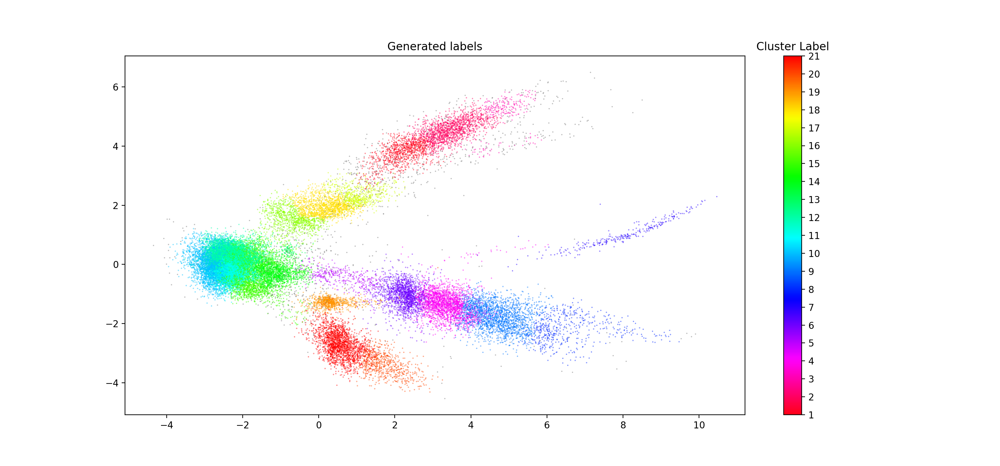

interactive(children=(FloatSlider(value=40.0, description='Threshold', max=600.0, step=1.0), Output()), _dom_c…

<function __main__.update(threshold)>

In [59]:
# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]
    fig, ax = plt.subplots(figsize=(15, 7))
    scatter = ax.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_ticks(clustered.hierarchical_labels.unique())
    cbar.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter.set_cmap('hsv_r')
    cbar.ax.set_title('Cluster Label')
    ax.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax.set_title('Generated labels')
    plt.show()

# Define the slider widget for threshold
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=1, description='Threshold')

# Call the function with the initial threshold value
hierarchical_clustering(40)

# Define function to update the plot when the slider value is changed
def update(threshold):
    # Update the hierarchical labels based on the new threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters
    # Call the visualization function with the updated labels
    hierarchical_clustering(threshold)

# Create and display the slider widget and visualization
widgets.interact(update, threshold=t_slider)

<IPython.core.display.Javascript object>


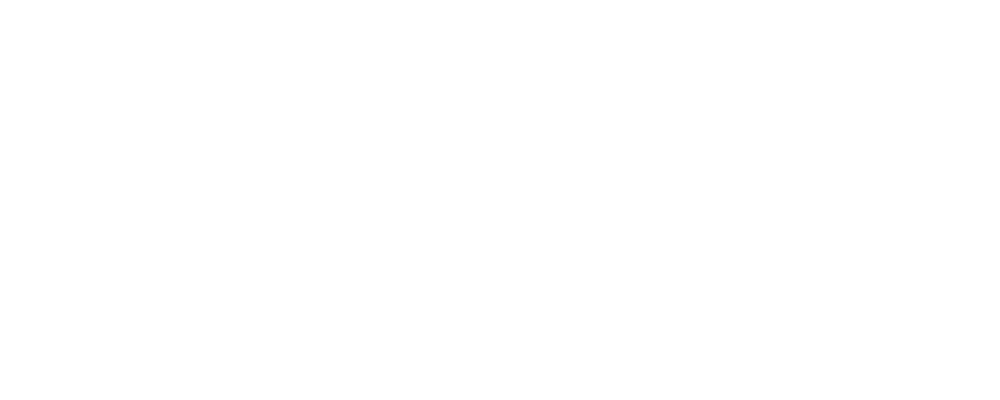

interactive(children=(FloatSlider(value=40.0, description='Threshold', max=600.0, step=10.0), IntSlider(value=…

<function __main__.update(threshold, selected_cluster)>

In [74]:
# Define function for hierarchical clustering and interactive visualization
def hierarchical_clustering(threshold, selected_cluster):
    # Create scatter plot with color-coded clusters and outliers
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]

    # Cluster the data with the current threshold value
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    result['hierarchical_labels'] = flat_clusters

    # Determine the maximum number of clusters based on the current threshold value
    max_cluster = len(np.unique(flat_clusters))

    # Color the clusters with the current hierarchical labels
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 4))

    scatter1 = ax1.scatter(clustered.x, clustered.y, c=clustered.hierarchical_labels, s=0.05, cmap='hsv_r')
    cbar1 = plt.colorbar(scatter1, ax=ax1)
    cbar1.set_ticks(clustered.hierarchical_labels.unique())
    cbar1.set_ticklabels(clustered.hierarchical_labels.unique())
    scatter1.set_cmap('hsv_r')
    cbar1.ax.set_title('Cluster Label')
    ax1.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax1.set_title('Generated labels')

    # Determine the color of the selected cluster
    if selected_cluster > max_cluster:
        selected_cluster = max_cluster
    colors = np.where(clustered.hierarchical_labels == selected_cluster, 'green', 'black')
    scatter2 = ax2.scatter(clustered.x, clustered.y, c=colors, s=0.05)
    ax2.scatter(outliers.x, outliers.y, color='gray', s=0.05)
    ax2.set_title(f'Cluster {selected_cluster}')

    plt.show()

# Define function to update the plot when the slider or dropdown value is changed
def update(threshold, selected_cluster):
    # Close all existing figures
    plt.close('all')

    # Update the range of the selected cluster slider based on the current threshold value
    max_cluster = len(np.unique(hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')))
    cluster_slider.max = max_cluster
    
    # Update the step size of the threshold slider based on the current value
    if threshold >= 500:
        t_slider.step = 100
    elif threshold >= 100:
        t_slider.step = 50
    else:
        t_slider.step = 10
        
    # Call the clustering function with the updated threshold and selected cluster values
    hierarchical_clustering(threshold, selected_cluster)

# Define the slider widgets for threshold and selected cluster
t_slider = widgets.FloatSlider(value=40, min=0, max=600, step=10, description='Threshold')
cluster_slider = widgets.IntSlider(value=1, min=1, max=result.hierarchical_labels.max(), step=1, description='Cluster')

# Call the function with the initial threshold and selected cluster values
hierarchical_clustering(40, 1)

# Create and display the slider and dropdown widgets and visualization
widgets.interact(update, threshold=t_slider, selected_cluster=cluster_slider)


### NODE GRAPHS OF SELECTED CLUSTER AFTER CHOOSING THE NUMBER OF CLUSTERS

In [75]:
%matplotlib inline
#%matplotlib notebook

import ipywidgets as widgets
from IPython.display import display
import networkx as nx
import community.community_louvain as cl
import matplotlib.pyplot as plt

# create the graph and labels
def create_wordnet_graph(top_words, top_hypernyms):
    graph = nx.Graph()
    for word in top_words:
        graph.add_node(word)
    for hypernym in top_hypernyms:
        graph.add_node(hypernym)
    for word in top_words:
        hypernyms = get_hypernyms_for_word(word)
        for hypernym in hypernyms:
            if hypernym in top_hypernyms:
                graph.add_edge(word, hypernym)
    return graph

def draw_node_graph(graph, labels, selected_cluster):
    partition = cl.best_partition(graph, resolution=5.0)
    pos = nx.spring_layout(graph, k=0.2)
    node_size = [partition[n]*50 for n in graph]
    cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)
    node_color = [cmap(partition[node]) for node in graph.nodes()]
    fig, ax = plt.subplots(figsize=(10, 5))
    nx.draw_networkx(graph, pos=pos, node_size=node_size, labels=labels, alpha=1, linewidths=0,
                     cmap=cmap, node_color=node_color)
    plt.title(f"Node graph for cluster {selected_cluster}")
    plt.show()

# Get unique hierarchical cluster labels
hierarchical_labels = result['hierarchical_labels'].unique()
num_clusters = len(hierarchical_labels)

# Define the cluster to display
selected_cluster = hierarchical_labels[0]

# Get initial data points belonging to current hierarchical cluster
cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster]

# Extract most frequent words and hypernyms
top_words = get_most_frequent_words(cluster_data["word_tokens"])
top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
top_word_hypernyms = {}
for word in top_words:
    top_word_hypernyms[word] = get_hypernyms_for_word(word)

# Create initial node graph
graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
labels = {node: node for node in graph.nodes()}

# Define slider widget
slider = widgets.IntSlider(min=1, max=num_clusters, step=1, value=1)

# Define function to update node graph when slider is changed
def update(selected_cluster):
    # Close all previous plot figures
    plt.close('all')

    # Convert selected slider value to corresponding hierarchical cluster label
    selected_cluster_label = hierarchical_labels[selected_cluster - 1]
    
    # Get data points belonging to current hierarchical cluster
    cluster_data = val_hier_df[result['hierarchical_labels'] == selected_cluster_label]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(cluster_data["word_tokens"])
    top_hypernyms = get_most_frequent_hypernyms(cluster_data["word_tokens"])
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, selected_cluster)

# Link slider to update function,
widgets.interact(update, selected_cluster=slider)

interactive(children=(IntSlider(value=1, description='selected_cluster', max=9, min=1), Output()), _dom_classe…

<function __main__.update(selected_cluster)>

### SELECTING SPECIFIC TEXT FROM THE EMBEDDING SPACE

<IPython.core.display.Javascript object>


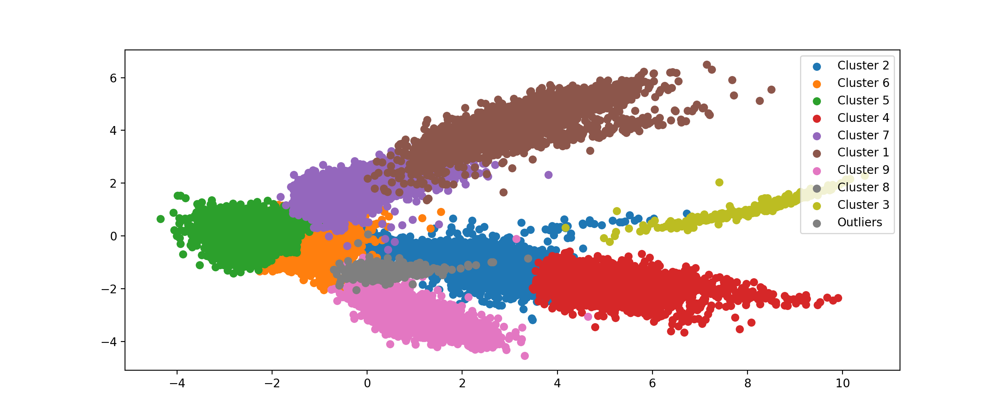

Textarea(value='')

In [69]:
# Clicking on specific text from the embedding space
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets

# Create a mapping from (x, y) coordinates to text
# Round coordinates to 3 decimal places
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

fig, ax = plt.subplots(figsize=(12, 5))

scatter_plots = []
for cluster in clusters:
    clustered_data = result[result.hierarchical_labels == cluster]
    scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
    scatter_plots.append(scatter)

outliers = result[result.hierarchical_labels == -1]
scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
scatter_plots.append(scatter)

ax.legend()

# Create a widget to display the text
text_widget = widgets.Textarea()
display(text_widget)

# Function to handle click events
def on_click(event):
    if event.inaxes == ax:
        for sc in scatter_plots:
            cont, ind = sc.contains(event)
            if cont:
                x, y = sc.get_offsets()[ind["ind"][0]]
                text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
                text_widget.value = text  # update the widget with the text
                return

fig.canvas.mpl_connect("button_press_event", on_click)

plt.show()

### SELECTING SPECIFIC TOPIC AND GROUPING WITH N CLOSEST OBSERVATIONS + NODE GRAPH FOR THE LOCAL GROUP

/var/folders/2w/pfh6cdv54ybg6mtynx299wmw0000gn/T/ipykernel_96842/1818252458.py:28: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis', max(partition.values()) + 1)


<IPython.core.display.Javascript object>


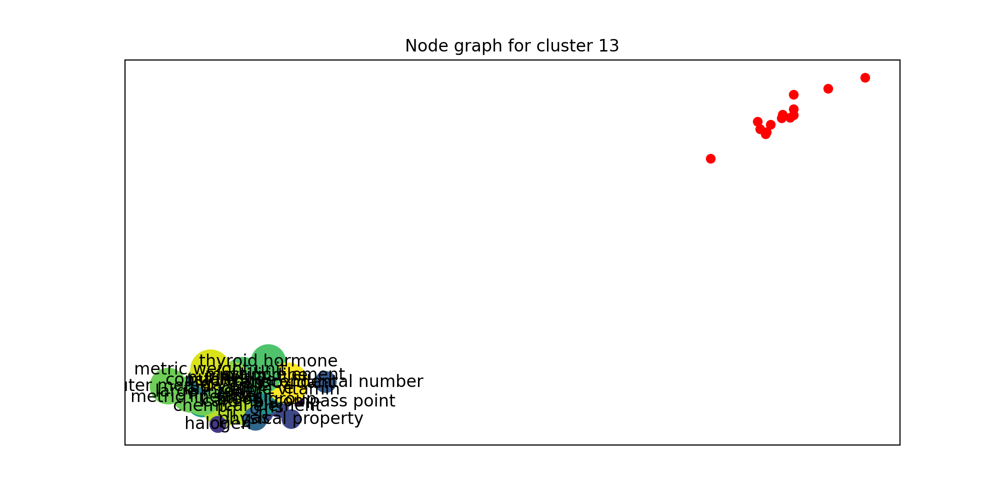

Pomacanthus xanthometopon is a ray-finned fish in the family Pomacanthidae found in shallow parts of the Indo-Pacific. It is commonly known as the blueface angelfish or the yellowface angelfish  because of its striking facial colouration.
The Gundlach's hawk (Accipiter gundlachi) is a species of bird of prey in the Accipitridae family. It is one of 21 endemic bird species of Cuba. The common name and Latin binomial commemorate the German-Cuban ornithologist Juan Cristobal Christoff Gundlach (1810–1896). It is threatened by habitat loss and human persecution.
The unicorn crestfish or unicornfish, Eumecichthys fiski, is a very rare, little-known species of crestfish in the family Lophotidae, and the only member of its genus. It likely has a worldwide distribution, having been first discovered offshore of Kalk Bay, South Africa, and subsequently reported from the Sea of Japan, southwest Florida, Clarion Island off Mexico, Hawaii, and India. A report from the Bering Sea may have been in er

/opt/anaconda3/envs/ayalcin/lib/python3.8/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


<IPython.core.display.Javascript object>


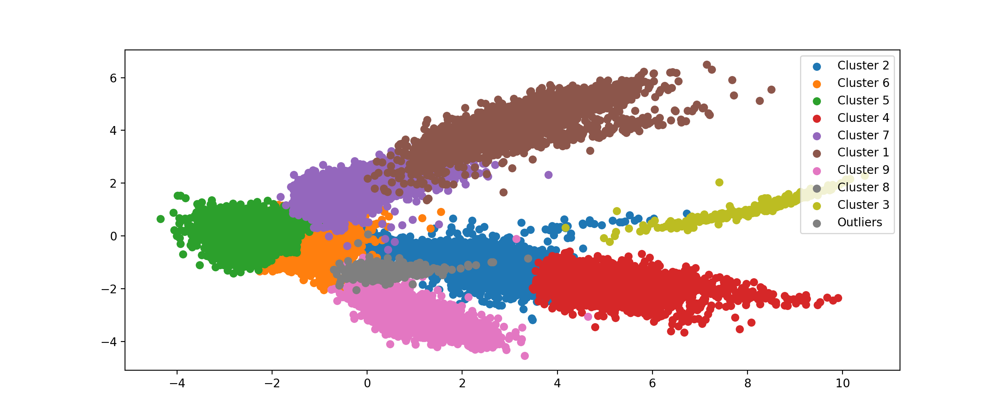

IntSlider(value=13, max=50, min=1)

Textarea(value='The Siege of Shaizar took place from April 28 to May 21, 1138. The allied forces of the Byzant…

In [70]:
%matplotlib notebook
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from IPython.display import clear_output, display
import ipywidgets as widgets

# Create a mapping from (x, y) coordinates to text
coord_to_text = dict(((round(x, 3), round(y, 3)), text) for x, y, text in val_hier_df[['x', 'y', 'text']].values)

clusters = result.hierarchical_labels.unique()

# Create a widget to display the text
text_widget = widgets.Textarea()

# Compute the nearest neighbors
nbrs = NearestNeighbors(n_neighbors=11, metric='cosine').fit(val_prediction)

# Create a mapping from index to text
index_to_text = dict(enumerate(val_hier_df['text'].values))

# Create an index to (x, y) mapping
index_to_coord = dict(enumerate(zip(val_hier_df['x'], val_hier_df['y'])))

# Create a widget for the number of neighbors
neighbors_slider = widgets.IntSlider(min=1, max=50, step=1, value=10)

# Define the function to update the nearest neighbors and node graph
def update_neighbors_and_graph(index, n_neighbors):
    distances, indices = nbrs.kneighbors(val_prediction[index].reshape(1, -1), n_neighbors + 1)
    neighbor_texts = [index_to_text[i] for i in indices.flatten()]
    neighbor_coords = [index_to_coord[i] for i in indices.flatten()]

    # Extract most frequent words and hypernyms
    top_words = get_most_frequent_words(neighbor_texts)
    top_hypernyms = get_most_frequent_hypernyms(neighbor_texts)
    top_word_hypernyms = {}
    for word in top_words:
        top_word_hypernyms[word] = get_hypernyms_for_word(word)

    # Create and show node graph for current cluster
    graph = create_wordnet_graph(top_words + top_hypernyms, top_hypernyms)
    labels = {node: node for node in graph.nodes()}
    draw_node_graph(graph, labels, n_neighbors)

    # Show neighbor texts
    print('\n'.join(neighbor_texts))

    # Show neighbor coordinates
    plt.scatter(*zip(*neighbor_coords), c='r')

# Global variable to store currently selected index
current_index = None

# Function to update nearest neighbors and node graph when slider is changed
def on_slider_change(change):
    # Check if index is not None (i.e., a point has been clicked)
    if current_index is not None:
        # Clear the old output
        clear_output(wait=True)

        # Get the new slider value
        new_value = change.new

        # Update nearest neighbors and node graph
        update_neighbors_and_graph(current_index, new_value)

        # Redraw scatter plot and re-display widget
        draw_scatter_plot()
        display(neighbors_slider)
        display(text_widget)

# Draw initial scatter plot
def draw_scatter_plot():
    fig, ax = plt.subplots(figsize=(12, 5))

    scatter_plots = []
    for cluster in clusters:
        clustered_data = result[result.hierarchical_labels == cluster]
        scatter = ax.scatter(clustered_data['x'], clustered_data['y'], label='Cluster {}'.format(cluster))
        scatter_plots.append(scatter)

    outliers = result[result.hierarchical_labels == -1]
    scatter = ax.scatter(outliers['x'], outliers['y'], color='gray', label='Outliers')
    scatter_plots.append(scatter)

    ax.legend()

    fig.canvas.mpl_connect("button_press_event", on_click)

    plt.show()

# Function to handle click events
def on_click(event):
    global current_index, ax
    for i, sc in enumerate(scatter_plots):
        cont, ind = sc.contains(event)
        if cont:
            # Clear the old output
            clear_output(wait=True)

            # Get index of selected point
            current_index = i * len(sc.get_offsets()) + ind["ind"][0]
            
            # Update nearest neighbors and node graph
            update_neighbors_and_graph(current_index, neighbors_slider.value)
            
            # Show the text of selected point
            x, y = sc.get_offsets()[ind["ind"][0]]
            text = coord_to_text.get((round(x, 3), round(y, 3)), 'No text found')
            text_widget.value = text  # update the widget with the text
            
            # Redraw scatter plot and re-display widget
            draw_scatter_plot()
            display(neighbors_slider)
            display(text_widget)
            return

# Display initial scatter plot and widgets
draw_scatter_plot()
display(neighbors_slider)
display(text_widget)

# Connect the slider change event to the function
neighbors_slider.observe(on_slider_change, names='value')

### COMPARISON OF NESTED CLUSTERS TOP WORDS AND HYPERNYMS SIMILARITY

In [2]:
#Full code of last interactive tool
from scipy.cluster import hierarchy
import numpy as np
from matplotlib import pyplot as plt
from collections import Counter
from nltk.corpus import wordnet
import ipywidgets as widgets
import networkx as nx

# Hierarchical clustering method
def hierarchical_clustering(threshold, linkage_matrix):
    flat_clusters = hierarchy.fcluster(linkage_matrix, t=threshold, criterion='distance')
    return flat_clusters

def get_most_frequent_words(word_tokens, n=10):
    words = [word for sublist in word_tokens for word in sublist]
    most_common_words = Counter(words).most_common(n)
    return [word for word, freq in most_common_words]

'''def get_most_frequent_hypernyms(word_tokens, n=10):
    hypernyms = [hypernym for sublist in word_tokens for word in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]'''

def get_most_frequent_hypernyms(word_tokens, n=10):
    # Get hypernyms for each word in word_tokens
    hypernyms = [get_hypernyms_for_word(word) for sublist in word_tokens for word in sublist]
    # Flatten the list of hypernyms
    hypernyms = [hypernym for sublist in hypernyms for hypernym in sublist]
    most_common_hypernyms = Counter(hypernyms).most_common(n)
    return [hypernym for hypernym, freq in most_common_hypernyms]

def get_hypernyms_for_word(word):
    synsets = wordnet.synsets(word)
    hypernyms = []
    for synset in synsets:
        for hypernym in synset.hypernyms():
            hypernyms.append(hypernym.lemma_names()[0])
    return list(set(hypernyms))

def update_clusters(threshold1, threshold2):
    # Close all previous plot figures
    plt.close('all')
    
    # Step 1: Cluster assignment with threshold1
    clusters_step1 = hierarchical_clustering(threshold1, linkage_matrix)
    
    # Step 2: Sub-cluster assignment within each cluster from step 1, threshold <= threshold1
    if threshold2 > threshold1:
        threshold2 = threshold1
    clusters_step2 = hierarchical_clustering(threshold2, linkage_matrix)
    
    # Plot the two embedding space graphs
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step1, cmap='viridis')
    plt.title('Clusters at threshold1')
    
    plt.subplot(1, 2, 2)
    plt.scatter(val_hier_df['x'], val_hier_df['y'], c=clusters_step2, cmap='viridis')
    plt.title('Subclusters at threshold2')
    
    # Show the plots before moving on to text output
    plt.show()
    
    # Extract the most common words and hypernyms for each subcluster
    subclusters = []
    for i in np.unique(clusters_step2):
        subcluster_data = val_hier_df[clusters_step2 == i]
        top_words = get_most_frequent_words(subcluster_data['word_tokens'])
        top_hypernyms = get_most_frequent_hypernyms(subcluster_data['word_tokens'])
        subclusters.append({'top_words': top_words, 'top_hypernyms': top_hypernyms})
    
    # Check for common nodes between different clusters
    for i, subcluster1 in enumerate(subclusters):
        for j, subcluster2 in enumerate(subclusters[i+1:]):
            common_words = set(subcluster1['top_words']) & set(subcluster2['top_words'])
            common_hypernyms = set(subcluster1['top_hypernyms']) & set(subcluster2['top_hypernyms'])
            
            common_words_ratio = len(common_words) / min(len(subcluster1['top_words']), len(subcluster2['top_words']))
            common_hypernyms_ratio = len(common_hypernyms) / min(len(subcluster1['top_hypernyms']), len(subcluster2['top_hypernyms']))
            
            if common_words_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top words. These words are: {common_words}")
            if common_hypernyms_ratio > 0.8:
                print(f"Clusters {i+1} and {j+i+2} share more than 80% of top hypernyms. These hypernyms are: {common_hypernyms}")
                
# Initial settings
max_threshold = 600 # change to your specific max threshold
step1_threshold = widgets.FloatSlider(value=40, min=0, max=max_threshold, step=10, description='Threshold 1')
step2_threshold = widgets.FloatSlider(value=30, min=0, max=step1_threshold.value, step=10, description='Threshold 2')

# Link the maximum of the second slider to the value of the first slider
widgets.jslink((step1_threshold, 'value'), (step2_threshold, 'max'))

# Create interactive widgets
widgets.interact(update_clusters, threshold1=step1_threshold, threshold2=step2_threshold)

